# Хакатон Кинопоиск

**Цели исследования:**  
На основе данных о постах на телеграм-канале "Кинопоиск", ежедневеом кол-ве подписок и отписок и комментариях к публикациям необходимо:

- вывести метрики эффективности поста по следующим критериям:
  - Тип публикации
  - Объем текста
  - Отсутствие / наличие эмодзи
  - Отсутствие / наличие изображений
  - Знаки препинания (сложность текста)
- провести семантический анализ комментариев к постам;
- проанализировать реакции на публикации;
- изучить корреляции характеристик и метрик постов с притоком новых пользователей и уровнем вовлеченности;
По итогам исследования нужно подготовить рекомендации, на основании которых будет подготовлена вирусная механика привлечения новых подписчиков на канал Кинопоиска и даны рекомендации по повышению уровня вовлеченности и охватов.



## Загрузка данных и подготовка к анализу

### Загрузка библиотек

Загрузим необходимые библиотеки.

In [ ]:
!pip install stop-words
!pip install nltk.tokenize
!pip install pymorphy2


ERROR: Could not find a version that satisfies the requirement nltk.tokenize (from versions: none)
ERROR: No matching distribution found for nltk.tokenize


In [ ]:
#drive.mount('/content/drive')

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import datetime as dt
import seaborn as sns
import numpy as np
import requests
import urllib
import json
import re
import warnings
import scipy.stats as stats
import nltk
import string
import pymorphy2
import ast
import random
import statistics


from google.colab import drive
from datetime import datetime, timedelta
from nltk import word_tokenize
from nltk.probability import FreqDist
from nltk.corpus import stopwords
from wordcloud import WordCloud

from scipy.stats import pearsonr, spearmanr





In [ ]:
nltk.download('punkt')
nltk.download('stopwords')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

Уберем ограничение по выводу строк, колонок и символов в записи и включаем игнорирование ошибок.

In [ ]:
# Сброс ограничений на количество выводимых рядов
pd.set_option('display.max_rows', None)

# Сброс ограничений на число столбцов
pd.set_option('display.max_columns', None)

# Сброс ограничений на количество символов в записи
pd.set_option('display.max_colwidth', None)

#Игнорируем предупреждения Jupiter
warnings.filterwarnings('ignore')

### Загрузка дынных

Загружаем датасеты в датафреймы.

In [ ]:
# подготавливаем ссылки для скачивания файлов с Яндекс.Диска.
# публичная ссылка на датасеты на яндекс диске
folder_url = 'https://disk.yandex.ru/d/2MvkGDrpIQjV7Q'
# названия файлов
file_url = ['comments_kinopisk_2023_01_18.csv',
            'kinopisk_reposts_and_mentions_2023_19_01.csv',
            'kinopisk_subscribers_detailed_2024-01-18.csv',
            'kinopoisk_channel_posts_2023-01-21.csv',
            'kinopoisk_subscribers_general_2024_18_01.csv']

# загружаем каждый файл в свой датафрейм
for i in range(0,5):
  url = ('https://cloud-api.yandex.net/v1/disk/public/resources/download'
        + '?public_key='
        + urllib.parse.quote(folder_url)
        + '&path=/'
        + urllib.parse.quote(file_url[i]))
  # запрос ссылки на скачивание
  r = requests.get(url)
   # 'парсинг' ссылки на скачивание
  h = json.loads(r.text)['href']

  if i == 0:
    comments = pd.read_csv(h, index_col=[0])
  elif i == 1:
    reposts_and_mentions = pd.read_csv(h, index_col=[0])
  elif i == 2:
    subscribers_detailed = pd.read_csv(h, index_col=[0])
  elif i == 3:
    channel_posts = pd.read_csv(h, index_col=[0])
  else:
    subscribers_general = pd.read_csv(h, index_col=[0])

In [ ]:
print(channel_posts.info())
display(channel_posts.head())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 23326 entries, 0 to 35656
Data columns (total 12 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   channel          23326 non-null  object 
 1   id               23326 non-null  int64  
 2   date             23326 non-null  object 
 3   text             23326 non-null  object 
 4   views            23325 non-null  float64
 5   reactions        9507 non-null   object 
 6   with_media       22594 non-null  object 
 7   forwarded        23325 non-null  float64
 8   replies          12233 non-null  object 
 9   reactions_count  23326 non-null  int64  
 10  comments         23326 non-null  int64  
 11  type_attachment  22594 non-null  object 
dtypes: float64(2), int64(3), object(7)
memory usage: 2.3+ MB
None


channel     id                       date  \
0  https://t.me/kinopoisk  37125  2024-01-21 08:02:21+00:00   
4  https://t.me/kinopoisk  37121  2024-01-20 18:01:00+00:00   
5  https://t.me/kinopoisk  37120  2024-01-20 16:01:16+00:00   
6  https://t.me/kinopoisk  37119  2024-01-20 14:20:04+00:00   
7  https://t.me/kinopoisk  37118  2024-01-20 10:48:48+00:00   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                       text  \
0                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                  Какими подростками были актеры из «Трудных подростков»? А что они помнят о своей первой любви?\n\nПоговорили с кастом сериала — Милой Ершовой, Святославом Рогожаном, Анастасией Красовской (@nastitasti) и Дашей Верещагиной. \n\n[Вспомнили](https://www.kinopoisk.ru/media/article/4008982/) самый яркий съемочный день, любимых героев и не только!\n\n🔥 Подписывайтесь на [**«Кинопоиск»**](https://t.me/kinopoisk)   
4                                                                                                                                                                                                                                                                                                                                                                                                                Фильм дня — [**«Дневник Бриджит Джонс»**](https://www.kinopoisk.ru/film/621/) (18+) 🎬\n\nБриджит Джонс — 32 года, она не замужем, переживает из-за лишнего веса и хочет избавиться от вредных привычек. Чтобы привести свои жизнь в порядок, Бриджит решает вести дневник. Теперь героине предстоит выбрать одного из двух мужчин, с которыми ее сводит жизнь: скромного Марка Дарси или ее босса, харизматичного Дэниэла Кливера. \n\nПолная юмора мелодрама Шэрон Магуайр стала современной версией классического романа Джейн Остин «Гордость и предубеждение». А Бриджит — настоящий иконой ромкомов! Не зря Рене Зеллвегер даже номинировали на «Оскар» за эту роль.\n\n🔥 Подписывайтесь на [**«Кинопоиск»**](https://t.me/kinopoisk)   
5  Кристоферу Нолану [вручат](https://www.hollywoodreporter.com/movies/movie-news/christopher-nolan-honorary-cesar-1235793056/) почетную премию «Сезар» за выдающиеся достижения в кинематографе — главный киноприз Франции. \n\nКак говорится в заявлении Французской киноакадемии, режис

В нашем распоряжении датафрйем **channel_posts** с 13 колонками и 23326 строками.  
Сведения о постах в телеграм канале
Кинопоиска
- `channel` - неинформативная колонка - название канала
- `id` - идентификатор поста Соответствует post_id в файле с комментариями к постам
- `date` - дата и время публикации поста в формате CTE (+2 часа для получения московского времени)
- `text` - текст поста
- `views` - количество просмотров поста
- `reactions` - словарь с реакциями (эмоджи/смайлы) на пост Дает информацию о типе смайла и его количестве
- `with_media` - дает представление о прикрепленном к посту документе Как правило MessageMediaPhoto - фото MessageMediaDocument - видео MessageMediaWebPage - ссылка
- `forwarded` - сколько раз пересылался пост
- `replies` - словарь с количеством комментариев к посту
- `reactions_count` - количество реакций/эмоджи на пост Столбец получен из столбца reactions путем суммирование количества всех реакций
- `comments` - количество комментариев к посту Столбец получен на основе Replies
- `type_attachement` - вид прикрепленного к посту документа Получен из словаря в With media

In [ ]:
print(comments.info())
display(comments.head())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 139522 entries, 0 to 17924
Data columns (total 4 columns):
 #   Column        Non-Null Count   Dtype 
---  ------        --------------   ----- 
 0   Unnamed: 0    139522 non-null  int64 
 1   post_id       139522 non-null  int64 
 2   date_comment  139522 non-null  object
 3   text_comment  132192 non-null  object
dtypes: int64(2), object(2)
memory usage: 5.3+ MB
None


,Unnamed: 0,post_id,date_comment,text_comment
0,0,37068,2024-01-18 09:34:31+00:00,"От бесстыжих к медведю - так это скорее не путь, а спуск"
1,1,37068,2024-01-18 09:35:00+00:00,учился орать FUCK!
2,2,37068,2024-01-18 09:35:11+00:00,Верните бестыжих
3,3,37068,2024-01-18 09:36:34+00:00,От липа из бесстыжих до рекламы кельвин кляйн
4,4,37068,2024-01-18 09:37:41+00:00,"этот навык был освоен еще в ""бесстыжих""🧡"


Датафрейм **comments** с 5 колонками и 139522 строками.  
Текстовые комментарии к постам
- `post_id` - идентификатор поста, к которому был написан комментарий Соответствует ID в файле subscribers_general
- `date_comment` - дата публикации комментария в формате CTE
- `text_comment` - текстовое содержание комментария

In [ ]:
print(subscribers_general.info())
display(subscribers_general.head())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 520 entries, 0 to 519
Data columns (total 3 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   date         520 non-null    object
 1   subscribers  520 non-null    int64 
 2   changes      520 non-null    int64 
dtypes: int64(2), object(1)
memory usage: 16.2+ KB
None


,date,subscribers,changes
0,18.01.24,551378,415
1,17.01.24,550963,2061
2,16.01.24,548902,2043
3,15.01.24,546859,2539
4,14.01.24,544320,2021


Датафрейм **subscribers_general** 4 колонки и 520 строк.  
  Общая информация о подписчиках канала в разбивке по дням
- `date` - дата
- `subscribers` - суммарное количество подписок на эту дату
- `changes` - разница в количестве подписчиков между текущей и предыдущей датами

In [ ]:
print(subscribers_detailed.info())
display(subscribers_detailed.head())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 12282 entries, 0 to 12281
Data columns (total 4 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   date          12282 non-null  object
 1   time          12282 non-null  object
 2   subscribers   12282 non-null  int64 
 3   unsubscribed  12282 non-null  int64 
dtypes: int64(2), object(2)
memory usage: 479.8+ KB
None


,date,time,subscribers,unsubscribed
0,"Чт, 18 Jan",11:29,204,-300
1,"Чт, 18 Jan",11:00,373,-366
2,"Чт, 18 Jan",10:00,333,-150
3,"Чт, 18 Jan",09:00,211,-133
4,"Чт, 18 Jan",08:00,152,-90


Датафрейм **subscribers_detailed** 5 колонок и 12282 строки.  
Представлена информация о подписчиках канала и отписках
- `date` - дата
- `time` - время
- `subscribers` - количество подписавшихся
- `unsubscribed` - количество отписок

In [ ]:
print(reposts_and_mentions.info())
display(reposts_and_mentions.head())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2306 entries, 0 to 2305
Data columns (total 4 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   channel             2306 non-null   object
 1   number_subscribers  2306 non-null   int64 
 2   action              2306 non-null   object
 3   date                2306 non-null   object
dtypes: int64(1), object(3)
memory usage: 90.1+ KB
None


,channel,number_subscribers,action,date
0,Обсуждаем фильмы. Поиском кино не занимаемся,1358,репостнул запись,"19 Jan, 10:02"
1,🎬 КиноДед,1409,репостнул запись,"18 Jan, 23:33"
2,супер8,22276,упомянул канал,"18 Jan, 22:48"
3,Стримми,13152,упомянул канал,"18 Jan, 22:35"
4,Обсуждаем фильмы. Поиском кино не занимаемся,1359,упомянул канал,"18 Jan, 21:02"


Датафрейм **reposts_and_mentions** - 5 колонок, 2306 строк.  
Данные за 3 месяца о телеграм каналах и группах, которые репостили посты Кинопоиска, либо упоминали Кинопоиск в своих постах.
- `channel` - канал или группа, который сделал репост/упоминание Кинопоиска
- `number_subscribers` - количество подписчиков этого канала
- `action` - тип действия - репост или упоминание
- `date `- когда было произведено действие.

### Предобработка данных

#### Удаляем ненужные для анализа столбцы

В  датафрейме **comments** у нас есть столбец Unnamed который появился, возможно, при создании датасета, и дублируют индекс. Удалим его.

In [ ]:

comments = comments.drop(columns=['Unnamed: 0'])
print(comments.columns)

Index(['post_id', 'date_comment', 'text_comment'], dtype='object')


Мы удалили лишние колонки.

#### Проверка на пропуски

Посмотрим на количество пропусков в процентном соотношении в каждом датафрейме.

In [ ]:
for i in (channel_posts, comments, subscribers_general, subscribers_detailed, reposts_and_mentions):
  display(pd.DataFrame(round(i.isna().mean()*100,1)).style.background_gradient('coolwarm'))

,0
channel,0.000000
id,0.000000
date,0.000000
text,0.000000
views,0.000000
reactions,59.200000
with_media,3.100000
forwarded,0.000000
replies,47.600000
reactions_count,0.000000


,0
post_id,0.000000
date_comment,0.000000
text_comment,5.300000


,0
date,0.000000
subscribers,0.000000
changes,0.000000


,0
date,0.000000
time,0.000000
subscribers,0.000000
unsubscribed,0.000000


,0
channel,0.000000
number_subscribers,0.000000
action,0.000000
date,0.000000


Мы видим, что в датафреймах **subscribers_general**, **subscribers_detailed**, **reposts_and_mentions** пропусков нет.  
В датафрейме **comments** в колонке `text_comment` 5,3% пропусков, возможно, так тображаются комментарии со стикерами, эмодзи или гифками.   
В датафрейме **channel_posts** в колонке `reactions` 53% строки с пропусками и в колонке `replies` 47,6% строк с пропусками. Возможно, реакции и комментарии были подключены позже, чем начало датафрейма.  
Из новостей обновлений Telegram мы знаем, что [комментарии](https://telegram.org/blog/filters-anonymous-admins-comments/ru) были включены 30 сентября 2020 года, а [реакции](https://telegram.org/blog/reactions-spoilers-translations/ru) 30 декабря 2021 года. Если данные у нас есть раньше этих дат, то пропуски логичны.

### Проверка на явные дубли

Проверим датафреймы на явные дубли.

In [ ]:
for i in (channel_posts, comments, subscribers_general, subscribers_detailed, reposts_and_mentions):
  print(f'Явных дублей в датафреме {i.duplicated().sum()}')
  print(f'Доля дублей от всего датафрейма {(i.duplicated().sum()*100/len(i)).round(2)} %')

Явных дублей в датафреме 0
Доля дублей от всего датафрейма 0.0 %
Явных дублей в датафреме 620
Доля дублей от всего датафрейма 0.44 %
Явных дублей в датафреме 0
Доля дублей от всего датафрейма 0.0 %
Явных дублей в датафреме 0
Доля дублей от всего датафрейма 0.0 %
Явных дублей в датафреме 85
Доля дублей от всего датафрейма 3.69 %


Мы видим, что в датафрейме **comments** есть 620 явныхдублей, они могли возникнуть при сборе информации, т.к. не могли быть написаны несколько одинковых комментариев в одну секунду, и это 0,44% от всего датафрейма, их можно удалить. А в датафрейме **reposts_and_mentions** есть 85 явных дублей, это может говорить, что один канал даважды за одну минуту упомянул кинопоиск, или сделал репост, что возможно, эти дубли мы оставим.

In [ ]:
comments = comments.drop_duplicates()

In [ ]:
print(f'Явных дублей в датафреме {comments.duplicated().sum()}')
print(f'Доля дублей от всего датафрейма {(comments.duplicated().sum()*100/len(comments)).round(2)} %')

Явных дублей в датафреме 0
Доля дублей от всего датафрейма 0.0 %


Мы изюавились от явных дублей в датафрейме **comments**.

### Проверка на неявные явные дубли

#### Проверка на неявные явные дубли в датафрейме **channel_posts**

Проверим, есть ли в колонке `channel` каналы, кроме кинопоиска.

In [ ]:
print('Каналы в колонке channel', channel_posts['channel'].unique())

Каналы в колонке channel ['https://t.me/kinopoisk']


Мы видим, что в этой колонке только один канал - кинопоиска, это не пригодится нам в дальнейшем анализе, поэтому, чтобы облегчить немного датафрейм, мы удалим эту колонку. Также удалим колонку `with_media`, она содержит информацию о приложенных медиа, в данном анализе нам пригодится только тип медиа, который указан в `type_attachment`

In [ ]:
channel_posts = channel_posts.drop(columns=['channel', 'with_media'])
print(channel_posts.columns)

Index(['id', 'date', 'text', 'views', 'reactions', 'forwarded', 'replies',
       'reactions_count', 'comments', 'type_attachment'],
      dtype='object')


Колонка удалена.

Проверим, нет ли дублей в колонке `id`, т.е. не попал ли один пост дважды к нам в анализ.

In [ ]:
temp = channel_posts.groupby(by='id').agg({'date':'count'})
print('Повторяющихся id в датафрейме', len(temp.query('date > 1')))


Повторяющихся id в датафрейме 0


Повторяющихся постов нет.

#### Проверка на неявные явные дубли в датафрейме **subscribers_general**

Проверим, не попала ли одна и также дата дважды в датафрейм **subscribers_general**

In [ ]:
temp = subscribers_general.groupby(by='date').agg({'subscribers':'count'})
print('Повторяющихся дат в датафрейме', len(temp.query('subscribers > 1')))

Повторяющихся дат в датафрейме 0


Повторяющихся дат нет.

### Изменение типа данных

#### Изменение типа данных в датафрейме **channel_posts**

Для удобства работы изменим тип данных в колонке со временем и даты в формат datetime64, сохранив его в колонку `date_time` и поменяем часовой пояс на Москву, а также добавим колонку с датой потста - `post_date`

In [ ]:
channel_posts['date_time']= pd.to_datetime(channel_posts['date'], format="%Y-%m-%d %H:%M:%S%z", utc=True).dt.tz_convert('Europe/Moscow')
channel_posts['post_date'] = pd.to_datetime(channel_posts['date_time']).dt.date


In [ ]:
channel_posts['date_time'].head()

0   2024-01-21 11:02:21+03:00
4   2024-01-20 21:01:00+03:00
5   2024-01-20 19:01:16+03:00
6   2024-01-20 17:20:04+03:00
7   2024-01-20 13:48:48+03:00
Name: date_time, dtype: datetime64[ns, Europe/Moscow]

In [ ]:
print('Формат данных в date_time', channel_posts['date_time'].dtype)
print('Формат данных в post_date', channel_posts['post_date'].dtype)
print(f'В датафрейме данные с {channel_posts.post_date.min()} по {channel_posts.post_date.max()}')

Формат данных в date_time datetime64[ns, Europe/Moscow]
Формат данных в post_date object
В датафрейме данные с 2016-12-19 по 2024-01-21


Тип данных изменен, также мы видим, что в датафрейме посты с 19 декабря 2016 года (даты создания канала) по 21 января 2024 года (даты парсинга). Это подтверждает наше прошлое предположение, почему не у всех постов есть комментарии и реакции - тогда в телеграме еще не было таких функций.

#### Изменение типа данных в датафрейме **comments**

Для удобства работы изменим тип данных в колонке со временем и даты в формат datetime64, сохранив его в колонку `comment_time`.

In [ ]:
comments['comment_time']= pd.to_datetime(comments['date_comment'], format="%Y-%m-%d %H:%M:%S%z", utc=True)
print('Формат данных в comment_time', comments['comment_time'].dtype)
print(f'В датафрейме данные с {pd.to_datetime(comments.comment_time).dt.date.min()} по {pd.to_datetime(comments.comment_time).dt.date.max()}')

Формат данных в comment_time datetime64[ns, UTC]
В датафрейме данные с 2022-09-22 по 2024-01-19


Тип данных изменен.  
В датафрейме комментарии с 22 сентября 2022 года по 19 января 2024 года.

#### Изменение типа данных в датафрейме **reposts_and_mentions**

Для удобства работы изменим тип данных в колонке со временем и даты в формат datetime64, сохранив его в колонку `action_date`.

In [ ]:
print(reposts_and_mentions.date.head(2))
print(reposts_and_mentions.date.tail(2))

0    19 Jan, 10:02
1    18 Jan, 23:33
Name: date, dtype: object
2304    22 Oct 2023, 13:41
2305    22 Oct 2023, 13:08
Name: date, dtype: object


Мы видим, что в датафрейме есть данные от 2023 года, с указанным годом, а также данные 2024 года, без указания года.

In [ ]:
#приведем данные в колонке с датами в формат строки
reposts_and_mentions['date_string'] = reposts_and_mentions['date'].astype('str')
#найдем строки с указанным годом
mask = reposts_and_mentions['date_string'].str.contains('2023')
#найдпем первую строку с годом и сохраним ее индекс
date_with_year_index = reposts_and_mentions[mask].head(1).index
#создадим колонку action_date и запишем строки без указания года в формате DateTime6D, подставив 2024 год
reposts_and_mentions['action_date'] = reposts_and_mentions['date_string']
reposts_and_mentions['action_date'].iloc[:date_with_year_index[0]] = pd.to_datetime(reposts_and_mentions.iloc[:date_with_year_index[0], 3],
                                                                       format='%d %b, %H:%M').dt.strftime('2024-%m-%d %H:%M')
#в колонку action_date запишем строки с годом в формате DateTime64
reposts_and_mentions['action_date'].iloc[date_with_year_index[0]:] = pd.to_datetime(reposts_and_mentions.iloc[date_with_year_index[0]:, 3],
                                                                       format='%d %b %Y, %H:%M')
#удалим вспомогательную колонку date_string
reposts_and_mentions = reposts_and_mentions.drop(columns=['date_string'])
#приведем все даты к единому формату
reposts_and_mentions['action_date'] = pd.to_datetime(reposts_and_mentions['action_date'], format='%Y-%m-%d %H:%M')

In [ ]:
print('Формат данных в action_date', reposts_and_mentions['action_date'].dtype)
print(f'В датафрейме данные с {pd.to_datetime(reposts_and_mentions.action_date).dt.date.min()} \
  по {pd.to_datetime(reposts_and_mentions.action_date).dt.date.max()}')

Формат данных в action_date datetime64[ns]
В датафрейме данные с 2023-10-22   по 2024-01-19


Форматирование данных прошло успешно.  
В датафрейме данные с 22 октября 2023 года по 19 января 2024 года.

#### Изменение типа данных в датафрейме **subscribers_general**

Для удобства работы изменим тип данных в колонке с датой в формат даты.

In [ ]:
subscribers_general['date_format'] = pd.to_datetime(subscribers_general['date'], format='%d.%m.%y').dt.date
#отсортируем датафрейм по дате
subscribers_general = subscribers_general.sort_values(by='date_format')

print('Формат данных в date', subscribers_general['date_format'].dtype)
print(f'В датафрейме данные с {subscribers_general.date_format.min()} по {subscribers_general.date_format.max()}')

Формат данных в date object
В датафрейме данные с 2022-08-17 по 2024-01-18


Изменили формат данных.  
В датафрйеме данные с 17 августа 2022 года по  18 января 2024 года.

#### Изменение типа данных в датафрейме **subscribers_detailed**

Для удобства работы объединим колонки с датой и временем в одну, и изменим тип данных в формат datetime64.

In [ ]:
print(subscribers_detailed.date.head(2))
print(subscribers_detailed.date.tail(2))

0    Чт, 18 Jan
1    Чт, 18 Jan
Name: date, dtype: object
12280    Ср, 17 Aug 2022
12281    Ср, 17 Aug 2022
Name: date, dtype: object


Как и в случае с **reposts_and_mentions** у данных из 2024 года отсутствует год.

In [ ]:
#приведем данные в колонке с датами в формат строки
subscribers_detailed['date_string'] = subscribers_detailed['date'].str.split(n=1).str[1]
#объединим колонки с датой и временем
subscribers_detailed['date_string'] = subscribers_detailed['date_string']+ ' ' + subscribers_detailed['time']

#найдем строки с указанным годом
mask = subscribers_detailed['date_string'].str.contains('2023')

#найдпем первую строку с годом и сохраним ее индекс
date_with_year_index = subscribers_detailed[mask].head(1).index


#создадим колонку date_time и запишем строки без указания года в формате DateTime6D, подставив 2024 год
subscribers_detailed['date_time'] = subscribers_detailed['date_string']
subscribers_detailed['date_time'].iloc[:date_with_year_index[0]] = pd.to_datetime(subscribers_detailed.iloc[:date_with_year_index[0], 4],
                                                                       format='%d %b %H:%M').dt.strftime('2024-%m-%d %H:%M')
#в колонку date_time запишем строки с годом в формате DateTime64
subscribers_detailed['date_time'].iloc[date_with_year_index[0]:] = pd.to_datetime(subscribers_detailed.iloc[date_with_year_index[0]:, 4],
                                                                       format='%d %b %Y %H:%M')
#удалим вспомогательную колонку date_string
subscribers_detailed = subscribers_detailed.drop(columns=['date_string'])
#приведем все даты к единому формату
subscribers_detailed['date_time'] = pd.to_datetime(subscribers_detailed['date_time'], format='%Y-%m-%d %H:%M')

In [ ]:
print('Формат данных в date', subscribers_detailed['date_time'].dtype)
print(f'В датафрейме данные с {pd.to_datetime(subscribers_detailed.date_time).dt.date.min()}\
  по {pd.to_datetime(subscribers_detailed.date_time).dt.date.max()}')

Формат данных в date datetime64[ns]
В датафрейме данные с 2022-08-17  по 2024-01-18


Изменили формат данных.
В датафрйеме данные с 17 августа 2022 года по 18 января 2024 года.

**Вывод**  
Мы загрузили и подготовили данные к анализу.  
- Загрузили необходимые для работы библиотеки.
- Загрузили датасеты в датафреймы:
    - **channel_posts** с 13 колонками и 23326 строками,
    - **comments** с 5 колонками и 139522 строками,
    - **subscribers_general** с 4 колонками и 520 строками,
    - **subscribers_detailed** с 5 колоноками и 12282 строками,
    - **reposts_and_mentions** с 5 колоноками и 2306 строками.
- Удалили лишние для анализа столбцы.
- Проверили датафреймы на пропуски.
- Проверили датафреймы на явные дубли, удалили явные дубли в датафрейме **comments.**
- Проверили датафреймы на неявные дубли.
- Привели даты в датафреймах к формату данных даты, данные в датафреймах:
    - **channel_posts**  с 19 декабря 2016 года по 21 января 2024 года,
    - **comments** с 22 сентября 2022 года по 19 января 2024 года,
    - **reposts_and_mentions** с 22 октября 2023 года по 19 января 2024 года,
    - **subscribers_general** с 17 августа 2022 года по  18 января 2024 года,
    - **subscribers_detailed** с 17 августа 2022 года по 18 января 2024 года.

## Исследовательский анализ данных

Т.к. функция реакций в телеграме появились с 30 декабря 2021 года, то анализировть данные мы будем с этой даты.

In [ ]:
analyzes_date = pd.to_datetime('2021-12-30', format='%Y-%m-%d').date()
print(analyzes_date)

2021-12-30


### Количество постов

Посмотрим, сколько постов было написано в канале.

In [ ]:
print(f'Постов в канале написано за все время - {channel_posts.id.nunique()}')
print(f'Постов в канале написано с {analyzes_date} -', channel_posts.query('post_date > @analyzes_date').id.nunique())

Постов в канале написано за все время - 23326
Постов в канале написано с 2021-12-30 - 7273


Всего в датасете 23326 постов, а с 30 декабря 2021 года было написано 7273 постов.  
Визуализируем, как много постов было в нанале на определенную дату.

In [ ]:
# посчитаем сколько в каждую дату было написано постов
posts_dimanic = channel_posts.groupby(by='post_date').agg({'id':'count'}).reset_index().sort_values(by='post_date')
# посчитаем кумулятивную сумму, т.е. с накоплением

posts_dimanic['posts_cum'] = posts_dimanic['id'].cumsum()

# посчитаем сколько в каждую дату было написано постов с 30 декаря 2021 года
filter_posts_dimanic = (channel_posts.query('post_date > @analyzes_date')
  .groupby(by='post_date')
  .agg({'id':'count'})
  .reset_index()
  .sort_values(by='post_date')
  .rename(columns={'id':'posts_per_day'}))

# посчитаем кумулятивную сумму, т.е. с накоплением
filter_posts_dimanic['posts_cum'] = filter_posts_dimanic['posts_per_day'].cumsum()

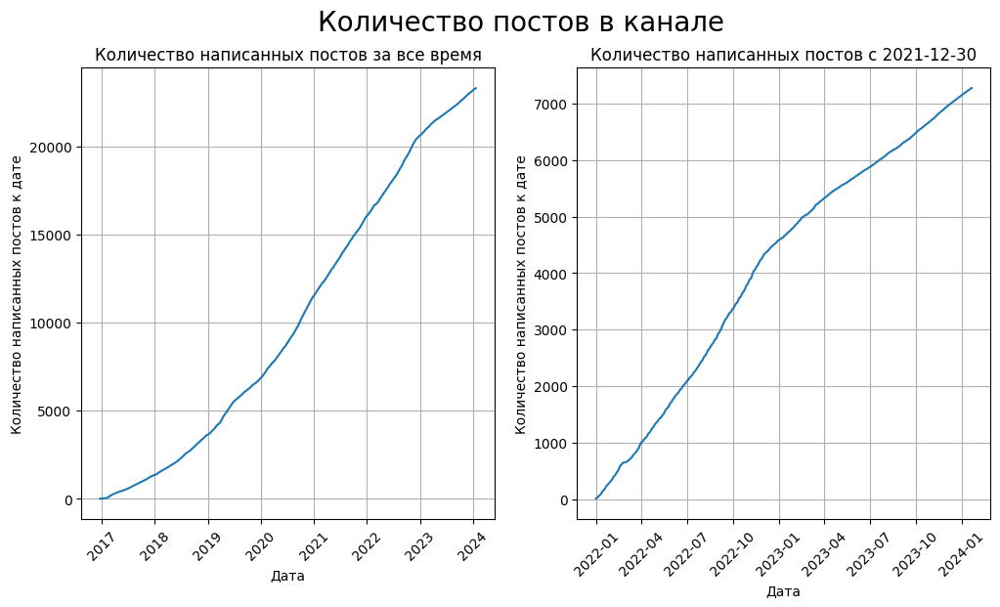

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(12,6))

fig.suptitle('Количество постов в канале', fontsize=20)

ax[0].plot(posts_dimanic['post_date'], posts_dimanic['posts_cum'])
ax[0].set_title('Количество написанных постов за все время')
ax[0].set(xlabel='Дата', ylabel='Количество написанных постов к дате')
ax[0].tick_params(axis='x', labelrotation=45)
ax[0].grid(True)


ax[1].plot(filter_posts_dimanic['post_date'], filter_posts_dimanic['posts_cum'])
ax[1].set_title(f'Количество написанных постов c {analyzes_date}')
ax[1].set(xlabel='Дата', ylabel='Количество написанных постов к дате')
ax[1].tick_params(axis='x', labelrotation=45)
ax[1].grid(True)
fig.show();

Посмотрим, сколько постов написано в канале в день.

count    746.000000
mean       9.749330
std        5.000419
min        1.000000
5%         4.000000
25%        6.000000
50%        8.000000
75%       12.000000
95%       20.000000
max       37.000000
Name: posts_per_day, dtype: float64


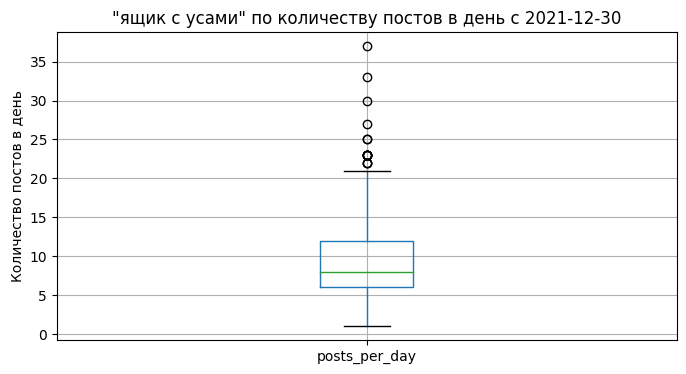

In [ ]:
print(filter_posts_dimanic['posts_per_day'].describe(percentiles=[0.05, 0.25, 0.5, 0.75, 0.95]))

filter_posts_dimanic.boxplot(column='posts_per_day', figsize=(8, 4))

plt.title(f'"ящик с усами" по количеству постов в день с {analyzes_date}')
plt.xlabel('')
plt.ylabel('Количество постов в день')
plt.show()

Мы видим, что в канале бывает обычно от 1 до 21 постав в день, в среднем (и медианное значение) около 5 постов в день. Но бывают дни, когда пишутся аномально много постов - до 32. Посмотрим на самые активные дни.

In [ ]:
filter_posts_dimanic.query('posts_per_day > 29')

,post_date,posts_per_day,posts_cum
82,2022-03-28,37,938
247,2022-09-10,33,3080
306,2022-11-08,30,3957


Возможные причины увеличения количества постов в день:  
2022-03-28 - Оскар.  
2022-09-10 - Венецианский кинофестиваль.  
2022-11-08 - нет определенного повода, возможно, просто так совпало, что в этот день было много новостей, или это как-то связано с Днем рождения кинопоиска, которое было 7 ноября.

### Подписки

Посмотрим, как менялось количество подписчиков в течение времени.

In [ ]:
subscribers_general.head()

,date,subscribers,changes,date_format
519,17.08.22,205805,62,2022-08-17
518,18.08.22,205921,116,2022-08-18
517,19.08.22,206163,242,2022-08-19
516,20.08.22,206493,330,2022-08-20
515,21.08.22,206772,279,2022-08-21


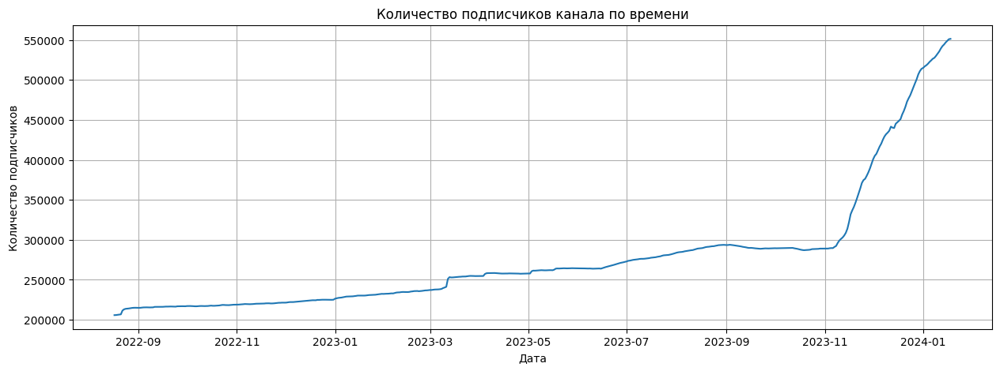

In [ ]:


plt.figure(figsize=(15, 5))
plt.title('Количество подписчиков канала по времени')

plt.plot(subscribers_general['date_format'], subscribers_general['subscribers'])
plt.xlabel('Дата')
plt.ylabel('Количество подписчиков')
plt.grid(True)
plt.show();

Мы видим, что были периоды резкого подъема в районе августа 2022, февраля 2023 и огромнвый рост после ноября 2023 года, но также мы видим, что в сентябре 2023 года был период, когда количество подписчиков падало.

Посмотрим, как люди подписывались/отписывались.

count     520.000000
mean      664.682692
std      1495.368324
min     -1254.000000
1%       -472.810000
5%       -208.350000
25%         7.250000
50%       153.500000
75%       431.750000
95%      4440.600000
99%      6145.330000
max      9844.000000
Name: changes, dtype: float64


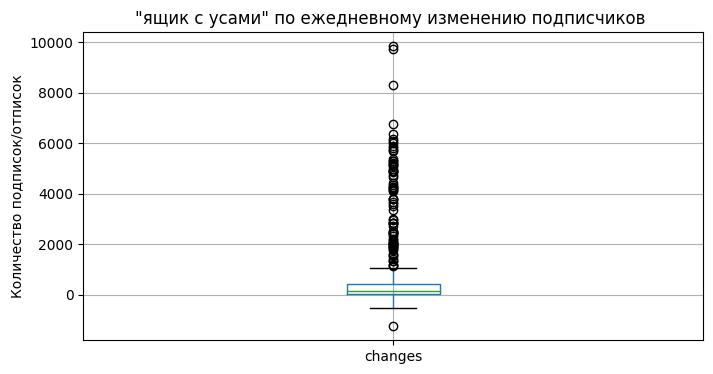

In [ ]:
print(subscribers_general['changes'].describe(percentiles=[0.01, 0.05, 0.25, 0.5, 0.75, 0.95, 0.99]))

subscribers_general.boxplot(column='changes', figsize=(8, 4))

plt.title(f'"ящик с усами" по ежедневному изменению подписчиков ')
plt.xlabel('')
plt.ylabel('Количество подписок/отписок')
plt.show()

Мы видим, что обычно количество подписчиков в день меняется от приблизительно минус 200, до плюс тысячи.  
Нам интересны дни, когда происходило аномальное количество подписок/отписок, посмотрим на 1 и 99 перцентиль (0,01 и 0,99 квантиль).

In [ ]:
subscribers_max_limit = subscribers_general['changes'].quantile(0.99)
subscribers_min_limit = subscribers_general['changes'].quantile(0.01)

abnormal_subscriptions = subscribers_general.query('changes <= @subscribers_min_limit | changes >= @subscribers_max_limit')
print('Количество дней с аномальными подписками/отписками - ', len(abnormal_subscriptions))
display(abnormal_subscriptions)
#abnormal_subscriptions.to_csv('/content/drive/My Drive/abnormal_subscriptions.csv', index=False)

Количество дней с аномальными подписками/отписками -  12


,date,subscribers,changes,date_format
312,12.03.23,251101,9844,2023-03-12
126,14.09.23,290140,-475,2023-09-14
97,13.10.23,289423,-473,2023-10-13
94,16.10.23,288171,-511,2023-10-16
93,17.10.23,287673,-498,2023-10-17
63,16.11.23,322213,8303,2023-11-16
62,17.11.23,331934,9721,2023-11-17
57,22.11.23,358364,6163,2023-11-22
55,24.11.23,371210,6776,2023-11-24
36,13.12.23,440327,-1254,2023-12-13


In [ ]:
abnormal_subscriptions_posts = channel_posts.query('post_date in @abnormal_subscriptions.date_format')
abnormal_subscriptions_posts = abnormal_subscriptions_posts[['id',
                                    'date_time',
                                    'text',
                                    'type_attachment',
                                    'views',
                                    'forwarded',
                                    'reactions_count',
                                    'comments']]
print('Постов в аномальные дни -', len(abnormal_subscriptions_posts))
#abnormal_subscriptions_posts.to_csv('/content/drive/My Drive/abnormal_subscriptions_posts.csv', index=False)

Постов в аномальные дни - 97


### Вовлеченность

Посчитаем вовлеченность для кажого поста, это сделаем по формуле:  
(Количество комментариев + колличество реакций + количество репостов) * 100 / количество просмотров.

In [ ]:
channel_posts_filtered = channel_posts.query('post_date > @analyzes_date')
channel_posts_filtered['er'] = ((channel_posts_filtered['reactions_count']
                                          + channel_posts_filtered['comments']
                                          + channel_posts_filtered['forwarded'])
                                          * 100
                                          /channel_posts_filtered['views'] ).round(2)


count    7273.000000
mean        1.136486
std         0.848679
min         0.080000
5%          0.330000
25%         0.590000
50%         0.920000
75%         1.440000
95%         2.590000
max        13.120000
Name: er, dtype: float64


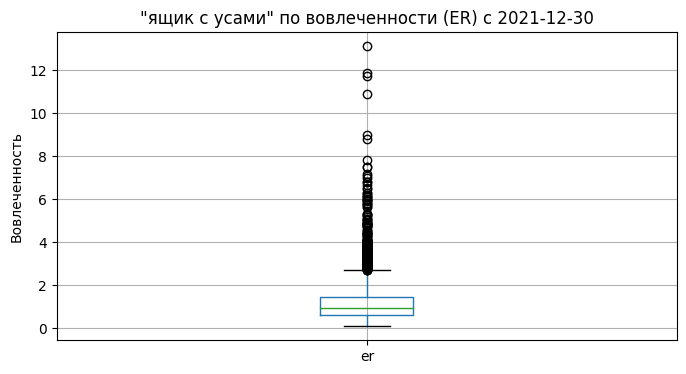

In [ ]:
print(channel_posts_filtered['er'].describe(percentiles=[0.05, 0.25, 0.5, 0.75, 0.95]))

channel_posts_filtered.boxplot(column='er', figsize=(8, 4))

plt.title(f'"ящик с усами" по вовлеченности (ER) с {analyzes_date}')
plt.xlabel('')
plt.ylabel('Вовлеченность')
plt.show()

Мы видим, что обычно "показатель вовлеченности" в среднем около 0,85, медианное значение - 0,92. Аномально большим считается показатель больше 2, но есть рекодсмен - более 12. Посмотрим на посты с самой высокой вовлеченностью, т.е. более 10.

In [ ]:
#Сохраним топ 10 постов по вовлеченности
top_10_posts_er = (channel_posts_filtered[['er',
                                           'id',
                                           'date_time',
                                           'text',
                                           'type_attachment',
                                           'views',
                                           'forwarded',
                                           'reactions_count',
                                           'comments']].sort_values(by='er', ascending=False).head(10))
#также сохраним топ10 постов с худшей вовлеченностью
least_10_posts_er = (channel_posts_filtered[['er',
                                           'id',
                                           'date_time',
                                           'text',
                                           'type_attachment',
                                           'views',
                                           'forwarded',
                                           'reactions_count',
                                           'comments']].sort_values(by='er', ascending=False).tail(10))

In [ ]:
display(top_10_posts_er.head())

,er,id,date_time,text,type_attachment,views,forwarded,reactions_count,comments
8984,13.12,27739,2022-08-22 16:40:57+03:00,"Привет! Этот текст пишет Антон из SMM команды Кинопоиска. Сейчас я уже отдыхаю, все хорошо. Главное, что посты про дарконов выложил. Спасибо за ваше внимание, много приятных комментариев. \n\nЗавтра у меня, конечно же, выходной ❤️",MessageMediaPhoto,82651.0,3141.0,7245,460
1444,11.86,35634,2023-10-29 04:14:56+03:00,Умер звезда «Друзей» Мэттью Перри. Ему было 54 года.\n\nФото: Getty Images,MessageMediaPhoto,62826.0,2124.0,5190,136
4089,11.75,32799,2023-04-26 15:15:34+03:00,5 тысяч сердечек на этом посте и мы ставим Кена-Гослинга на аватарку канала 💖,MessageMediaPhoto,72894.0,383.0,8012,169
3797,10.90,33123,2023-05-22 16:22:32+03:00,Ушла эпоха!\n\n__Будете __[__скучать__](https://t.me/kinopoisk_Industry/1936)__ по привычному дубляжу Леонардо__ __ДиКаприо?\n__❤️__ - да__ \n👎__ - нет__,MessageMediaPhoto,70984.0,1045.0,6529,164
2332,8.98,34691,2023-09-04 12:30:25+03:00,"Кристофер Нолан — лучший режиссер последних 25 лет по версии [Rotten Tomatoes](https://editorial.rottentomatoes.com/article/best-directors-of-the-last-25-years/).\n\n__Согласны?\n\n👍 — да, гений!\n👎 — нет, переоценен\n\n__Фото: Pascal Le Segretain / Getty Images",MessageMediaPhoto,49100.0,146.0,4207,58


На первом месте пост от SMM специалиста команды, после того, как он запустил пуш сообщение по ошибке пользователям приложения.  
На втором месте - пост о смерти Мэттью Перри, которая оказалась для всех большой неожиданностью.  
На третьем и четвертом месте - посты с призывом ставить реакции.  

Также посчитаем суточный ER, он считается, как средний ER в сутки.

In [ ]:
er_day = channel_posts_filtered.groupby('post_date', as_index=False).agg({'er':'mean'}).sort_values(by='post_date')

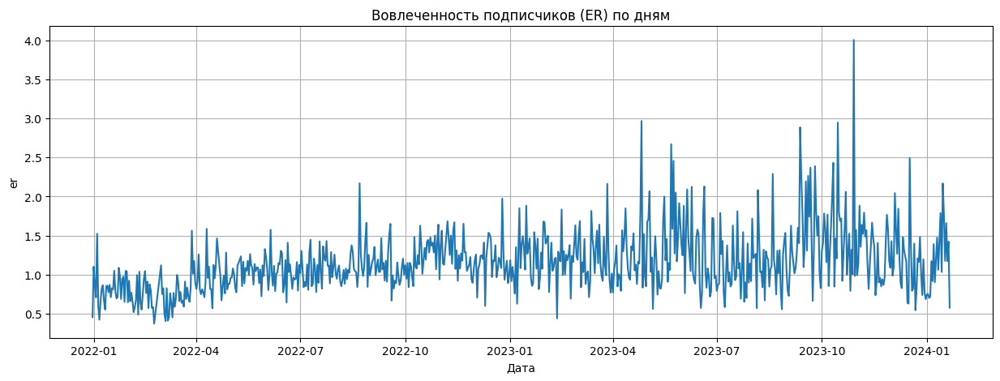

In [ ]:
plt.figure(figsize=(15, 5))
plt.title('Вовлеченность подписчиков (ER) по дням')

plt.plot(er_day['post_date'], er_day['er'])
plt.xlabel('Дата')
plt.ylabel('er')
plt.grid(True)
plt.show();

Также посчитаем ER в месяц, как медианное значение ER в месяц.

In [ ]:
er_day['month'] = pd.to_datetime(er_day['post_date'], format='%Y-%m-%d').dt.to_period("M")
er_month = er_day.groupby('month', as_index=False).agg({'er':'median'}).sort_values(by='month')
er_month['month'] = er_month['month'].astype('str')

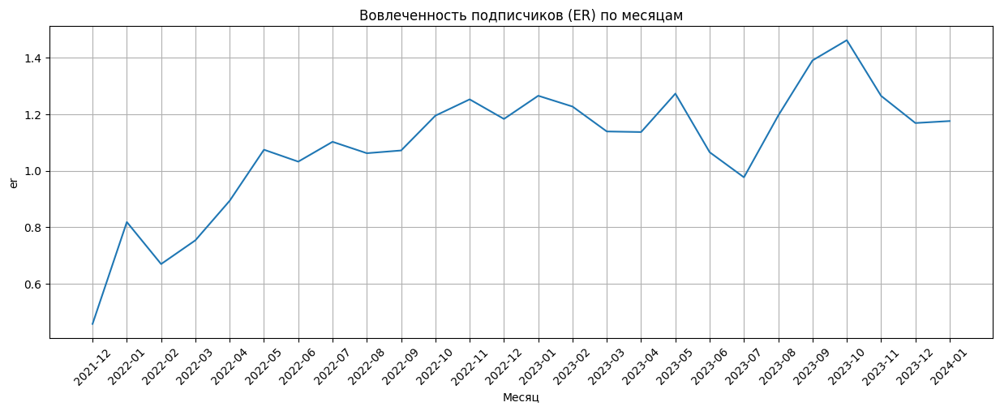

In [ ]:
plt.figure(figsize=(15, 5))
plt.title('Вовлеченность подписчиков (ER) по месяцам')
plt.plot(er_month['month'], er_month['er'])
plt.xlabel('Месяц')
plt.tick_params(axis='x', labelrotation=45)
plt.ylabel('er')
plt.grid(True)
plt.show();

Мы видим, что со временем вовлеченность пользователей росла до мая месяца, после чего начала радать, а с июля начала расти до октября, как раз когда выпустили чат бота. Провал в июле можно объяснить тем, что телеграм планировал вводить систему рекомендаций по каналам из-за чего менял органические алгоритмы.

### Вовлеченность по просмотрам

Посчитаем вовлеченность по просмотрам (ERR) по дням, для этого:  
(среднее количество просмотров постов в месяц / количество подписчиков) * 100

In [ ]:
# на каждую дату посчитаем среднее количество просмотров постов
err_day = channel_posts_filtered.groupby('post_date', as_index=False).agg({'views':'mean'})

# присоединим количество подписчиков на какждый день
err_day = pd.merge(err_day, subscribers_general[['date_format', 'subscribers']], left_on='post_date', right_on='date_format', how='inner')

# посчитаем err
err_day['err'] = (err_day['views']* 100/ err_day['subscribers'] ).round(2)

# удалим лишнюю колонку
err_day = err_day.drop(columns=['date_format'])

# отсортируем таблицу по дате
err_day = err_day.sort_values(by='post_date')

Построим график.

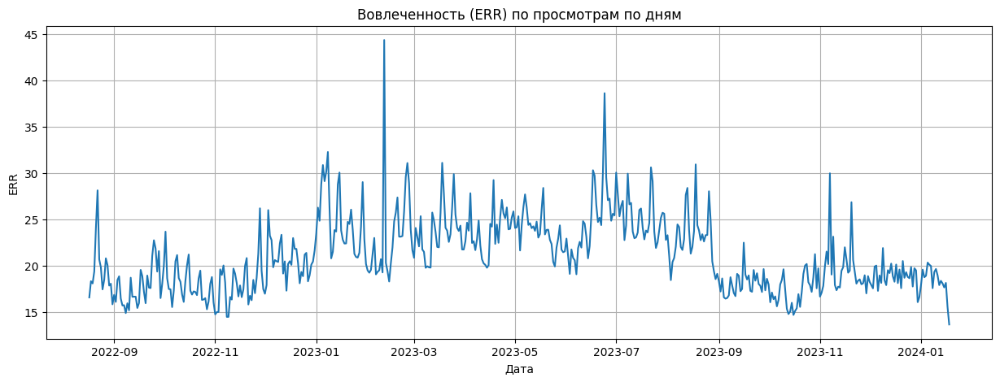

In [ ]:
plt.figure(figsize=(15, 5))
plt.title('Вовлеченность (ERR) по просмотрам по дням')

plt.plot(err_day['post_date'], err_day['err'])
plt.xlabel('Дата')
plt.ylabel('ERR')
plt.grid(True)
plt.show();

Мы видим, что ERR всегда колеблется от 15% до 30%, с разовыми сверхпиками.

count    520.000000
mean      21.145865
std        3.928895
min       13.680000
5%        15.999000
25%       18.170000
50%       20.345000
75%       23.772500
99%       30.946700
max       44.390000
Name: err, dtype: float64


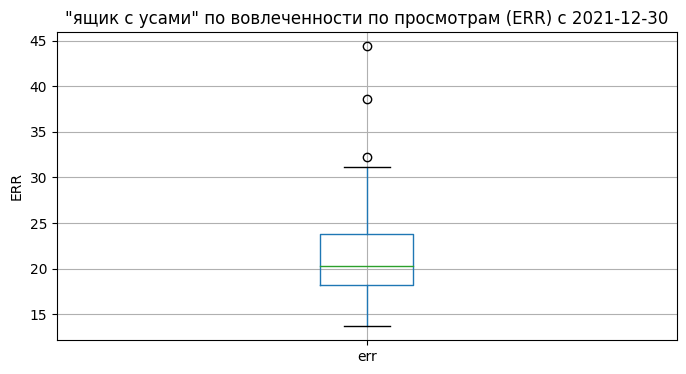

In [ ]:
print(err_day['err'].describe(percentiles=[0.05, 0.25, 0.5, 0.75, 0.99]))

err_day.boxplot(column='err', figsize=(8, 4))

plt.title(f'"ящик с усами" по вовлеченности по просмотрам (ERR) с {analyzes_date}')
plt.xlabel('')
plt.ylabel('ERR')
plt.show()

Как мы видим, ERR обычно в пределах от 13,68 до 31, средгнее значение по дням - 21,15, медианное - 20,29. Но есть 3 дня, когда ERR была больше 31, до 44,39, посмотрим на эти даты.

In [ ]:
err_day.query('err > 30.95')

,post_date,views,subscribers,err
144,2023-01-08,73977.500000,229026,32.30
178,2023-02-11,104154.857143,234613,44.39
192,2023-02-25,73560.833333,236458,31.11
213,2023-03-18,78906.250000,253514,31.13
311,2023-06-24,104079.000000,269270,38.65
366,2023-08-18,89854.166667,290244,30.96


In [ ]:
err_max_posts = channel_posts_filtered.query('post_date in @err_day.post_date')
err_max_posts = err_max_posts[['er',
                                    'id',
                                    'date_time',
                                    'text',
                                    'type_attachment',
                                    'views',
                                    'forwarded',
                                    'reactions_count',
                                    'comments']]
display(err_max_posts.sort_values(by='er', ascending=False).head(5))

,er,id,date_time,text,type_attachment,views,forwarded,reactions_count,comments
8984,13.12,27739,2022-08-22 16:40:57+03:00,"Привет! Этот текст пишет Антон из SMM команды Кинопоиска. Сейчас я уже отдыхаю, все хорошо. Главное, что посты про дарконов выложил. Спасибо за ваше внимание, много приятных комментариев. \n\nЗавтра у меня, конечно же, выходной ❤️",MessageMediaPhoto,82651.0,3141.0,7245,460
1444,11.86,35634,2023-10-29 04:14:56+03:00,Умер звезда «Друзей» Мэттью Перри. Ему было 54 года.\n\nФото: Getty Images,MessageMediaPhoto,62826.0,2124.0,5190,136
4089,11.75,32799,2023-04-26 15:15:34+03:00,5 тысяч сердечек на этом посте и мы ставим Кена-Гослинга на аватарку канала 💖,MessageMediaPhoto,72894.0,383.0,8012,169
3797,10.90,33123,2023-05-22 16:22:32+03:00,Ушла эпоха!\n\n__Будете __[__скучать__](https://t.me/kinopoisk_Industry/1936)__ по привычному дубляжу Леонардо__ __ДиКаприо?\n__❤️__ - да__ \n👎__ - нет__,MessageMediaPhoto,70984.0,1045.0,6529,164
2332,8.98,34691,2023-09-04 12:30:25+03:00,"Кристофер Нолан — лучший режиссер последних 25 лет по версии [Rotten Tomatoes](https://editorial.rottentomatoes.com/article/best-directors-of-the-last-25-years/).\n\n__Согласны?\n\n👍 — да, гений!\n👎 — нет, переоценен\n\n__Фото: Pascal Le Segretain / Getty Images",MessageMediaPhoto,49100.0,146.0,4207,58


Также посчитаем ERR по месяцам, как среднее.

In [ ]:
err_day['month'] = pd.to_datetime(err_day['post_date'], format='%Y-%m-%d').dt.to_period("M")
err_month = err_day.groupby('month', as_index=False).agg({'err':'median'}).sort_values(by='month')
err_month['month'] = err_month['month'].astype('str')


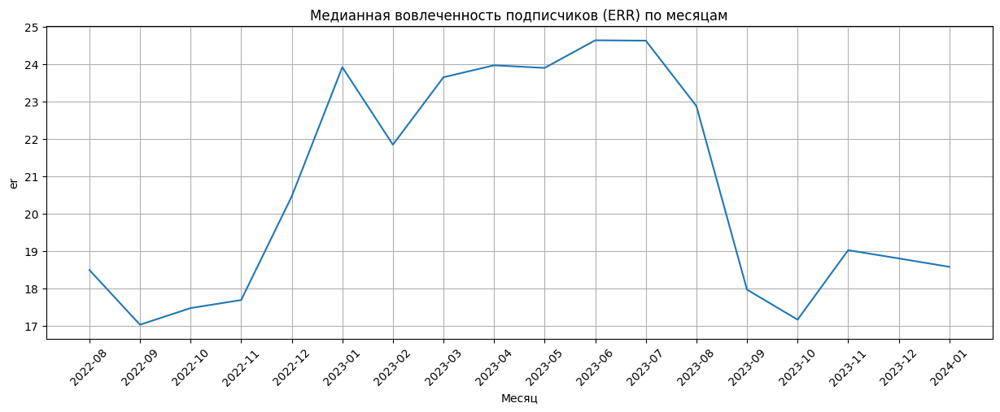

In [ ]:
plt.figure(figsize=(15, 5))
plt.title('Медианная вовлеченность подписчиков (ERR) по месяцам')
plt.plot(err_month['month'], err_month['err'])
plt.xlabel('Месяц')
plt.tick_params(axis='x', labelrotation=45)
plt.ylabel('er')
plt.grid(True)
plt.show();

На графике мы можем видеть, что среднемесячная вовлеченность (ERR) росла с ноября 2022 по январь 2023 года, после чего, можно сказать, держалась на одном уровне, а после июля 2023 года резко пошла на спад. и Только в октябре 2023 года стала снвоа расти.

### Размер постов

Посмотрим, какого размера были посты в канале.

In [ ]:
channel_posts_filtered['symbols'] = channel_posts_filtered['text'].apply(lambda x: len(x))

count    7273.000000
mean      447.914753
std       413.827414
min         3.000000
1%         29.000000
5%         76.000000
25%       227.000000
50%       349.000000
75%       529.000000
95%      1114.000000
99%      2189.400000
max      4868.000000
Name: symbols, dtype: float64


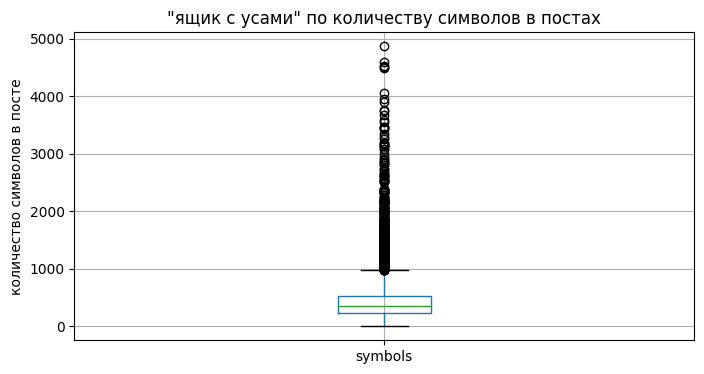

In [ ]:
print(channel_posts_filtered['symbols'].describe(percentiles=[0.01, 0.05, 0.25, 0.5, 0.75, 0.95, 0.99]))

channel_posts_filtered.boxplot(column='symbols', figsize=(8, 4))

plt.title(f'"ящик с усами" по количеству символов в постах')
plt.xlabel('')
plt.ylabel('количество символов в посте')
plt.show()

Мы видим. что обычно в постах от 3 до 1000 сиволов, в среднем 448, медианное значение 349. Очень редкими являются посты более 2189 символов.

Посчитаем, сколько в постах знаков препинания.  

In [ ]:
channel_posts_filtered['punctuation'] = channel_posts_filtered['text'].apply(lambda x: sum(map(x.count, [',',
                                                                                                         '.',
                                                                                                         '—',
                                                                                                         ':',
                                                                                                         ';',
                                                                                                         '-',
                                                                                                         '!',
                                                                                                         '?'])));

?.:.?— -!:.

count    7273.000000
mean       15.341812
std        14.880253
min         0.000000
1%          1.000000
5%          2.000000
25%         7.000000
50%        11.000000
75%        18.000000
95%        41.400000
99%        82.000000
max       139.000000
Name: punctuation, dtype: float64


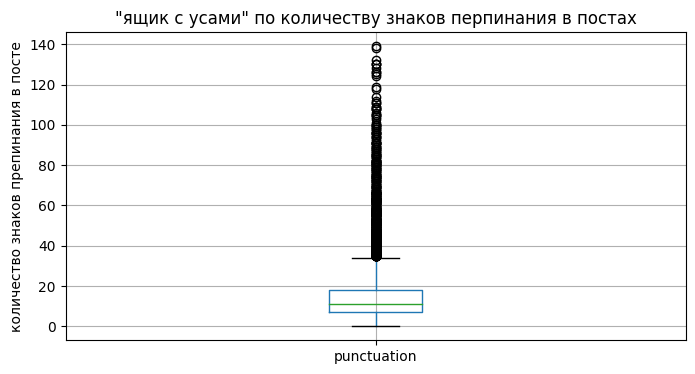

In [ ]:
print(channel_posts_filtered['punctuation'].describe(percentiles=[0.01, 0.05, 0.25, 0.5, 0.75, 0.95, 0.99]))

channel_posts_filtered.boxplot(column='punctuation', figsize=(8, 4))

plt.title(f'"ящик с усами" по количеству знаков перпинания в постах')
plt.xlabel('')
plt.ylabel('количество знаков препинания в посте')
plt.show()

Мы видим, что в постах бывает от 0 до 139 знаков, но также в постах есть ссылки, которые также состоят из знаков перпинания (двоеточий, точек и технических пробелов), что искажает нам анализ.  


In [ ]:
#Подготовим функцию, которая удалит ссылки в наших постах
def clean_data(df):

    df['clean_text'] = df['text'].str.replace('http[s]?://(?:[a-zA-Z]|[0-9]|[$-_@.&+]|[!*\(\),]|(?:%[0-9a-fA-F][0-9a-fA-F]))+', ' ')
#применим функцию
clean_data(channel_posts_filtered)


Посчитаем теперь в очищенных данных количество символов и знаков препинания.

In [ ]:
channel_posts_filtered['clear_symbols'] = channel_posts_filtered['clean_text'].apply(lambda x: len(x))
channel_posts_filtered['clear_punctuation'] = channel_posts_filtered['clean_text'].apply(lambda x: sum(map(x.count, [',',
                                                                                                                     '.',
                                                                                                                     '—',
                                                                                                                     ':',
                                                                                                                     ';',
                                                                                                                     '-',
                                                                                                                     '!',
                                                                                                                     '?'])))

count    7273.000000
mean      363.017324
std       323.224674
min         3.000000
1%         27.720000
5%         59.600000
25%       179.000000
50%       279.000000
75%       443.000000
95%       899.000000
99%      1706.560000
max      3998.000000
Name: clear_symbols, dtype: float64


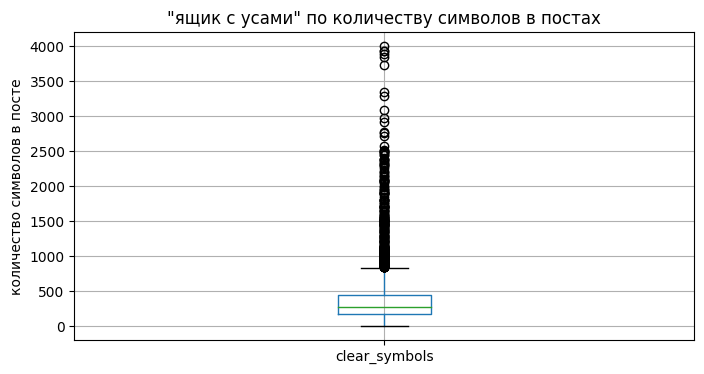

In [ ]:
print(channel_posts_filtered['clear_symbols'].describe(percentiles=[0.01, 0.05, 0.25, 0.5, 0.75, 0.95, 0.99]))

channel_posts_filtered.boxplot(column='clear_symbols', figsize=(8, 4))

plt.title(f'"ящик с усами" по количеству символов в постах')
plt.xlabel('')
plt.ylabel('количество символов в посте')
plt.show()

Мы видим, что обычно в постах бывает от 3 до приблизительно 900 символов, но также встречаются посты до 3998 символов. В среднем в постах 363 символа, медианное значение 279 символа.

count    7273.000000
mean        9.348824
std         8.780056
min         0.000000
1%          0.000000
5%          1.000000
25%         4.000000
50%         7.000000
75%        11.000000
95%        24.000000
99%        47.280000
max       116.000000
Name: clear_punctuation, dtype: float64


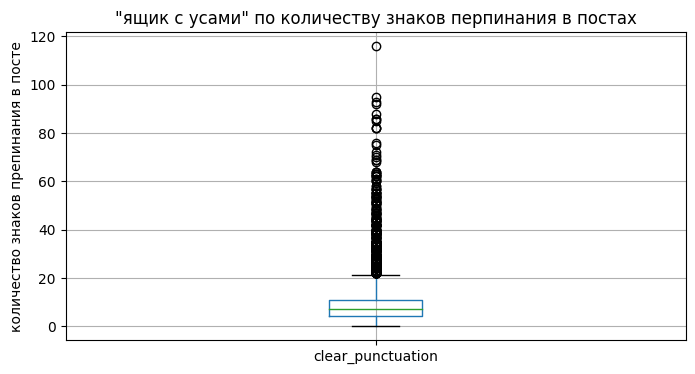

In [ ]:
print(channel_posts_filtered['clear_punctuation'].describe(percentiles=[0.01, 0.05, 0.25, 0.5, 0.75, 0.95, 0.99]))

channel_posts_filtered.boxplot(column='clear_punctuation', figsize=(8, 4))

plt.title(f'"ящик с усами" по количеству знаков перпинания в постах')
plt.xlabel('')
plt.ylabel('количество знаков препинания в посте')
plt.show()

Также мы видим, что в постах обычно бывает от 0 до 21 знаков препинания, но есть посты и до 120 знаков препинания. Посмотрим на этот пост, может быть это кая-то ошибка.

In [ ]:
display(channel_posts_filtered.query('clear_punctuation > 100')['text'])

13037    Саша Амато, [Golden Chihuahua](https://t.me/goldchihuahua)\n\nЯ успел посмотреть три серии и могу точно сказать, что главная проблема сериала в том, что его создатели страдают от странной слепоты к той культуре, которая породила Анну Делви. Когда я читал оригинальную статью, это была в первую очередь история про белого привилегированного человека, обладающего якобы безупречной биографией и произошедшего из очень богатой семьи. Культура и общество всегда поддерживали таких девушек. Будучи белой, очень легко втереться в доверие и попасть в высшее общество Нью-Йорка, во все арт- и фешен-тусовки (вряд ли Делви удалось бы это сделать, если бы она была, например, афроамериканкой или мексиканкой). Преступница Делви, которая манипулирует людьми и обманывает их, и есть продукт этого лицемерного общества, погрязшего в стереотипах. Тут показателен недавний скандал с «И просто так», где в одном из эпизодов звучит фраза: «Русская проститутка — обычное дело в дорогой недвижимости». Мне хоте

Мы видим, что это пост - объединенные рецензии нескольких человек.

Посмотрим, каких постов в канале больше, поделим их на 4 категории:
- до 50 символов - очень короткие,
- от 50 до 500 - короткие,
- от 500 до 1000 - обычные,
- от 1000 - большие.

In [ ]:
#подготовим функцию
def post_volume(volume):
  try:
    if volume < 50:
      return 'очень короткий пост'
    elif 50 <= volume < 500:
      return 'короткий пост'
    elif 500 <= volume < 1000:
      return 'обычный пост'
    else:
      return 'длинный пост'
  except:
    pass

Применим функцию

,post_cat,id
0,длинный пост,248
1,короткий пост,5506
2,обычный пост,1229
3,очень короткий пост,290


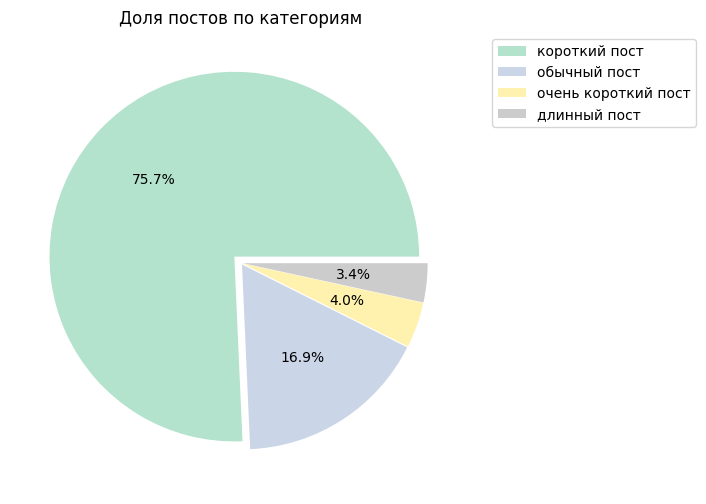

In [ ]:
channel_posts_filtered['post_cat'] = channel_posts_filtered['clear_symbols'].apply(post_volume)
display(channel_posts_filtered.groupby(by='post_cat', as_index=False)['id'].count())

channel_posts_filtered['post_cat'].value_counts().plot(kind="pie",
          autopct='%1.1f%%',
          explode=[0.05, 0.01, 0.01, 0.01],
          legend=True,
          title='Доля постов по категориям',
          ylabel='',
          labeldistance=None,
          figsize=(6, 6),
          cmap='Pastel2').legend(bbox_to_anchor=(1.5, 1));


75% постов до 50 символов, вероятно, это анонсы, постеры, кадры из фильмов.  17% - посты обычной длины, 4% очень коротких постов и 3,4% очень длинных постов.
Посмотрим, как распределяются медианный ER по категриям.

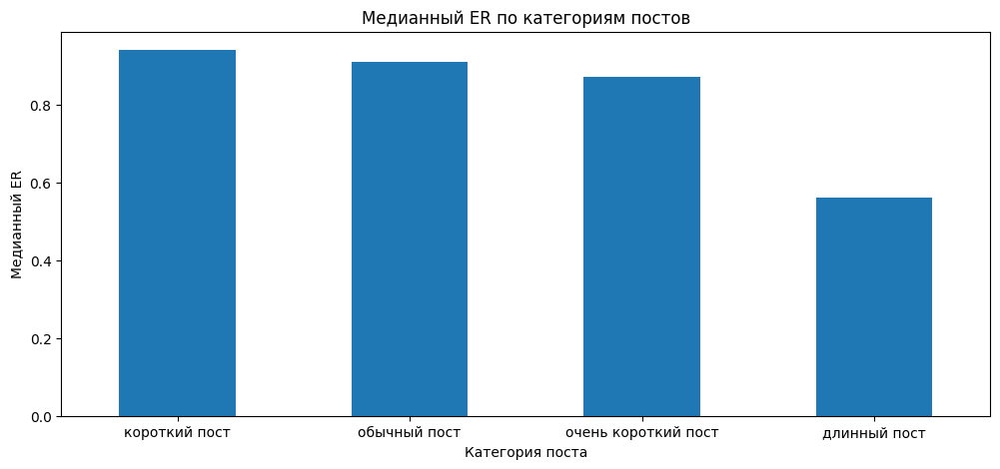

In [ ]:
channel_posts_filtered.groupby(by='post_cat')['er'].median().sort_values(ascending=False).plot(kind='bar',
       figsize=(12,5),
       title='Медианный ER по категориям постов',
       xlabel='Категория поста',
       ylabel='Медианный ER',
       rot=0
      );

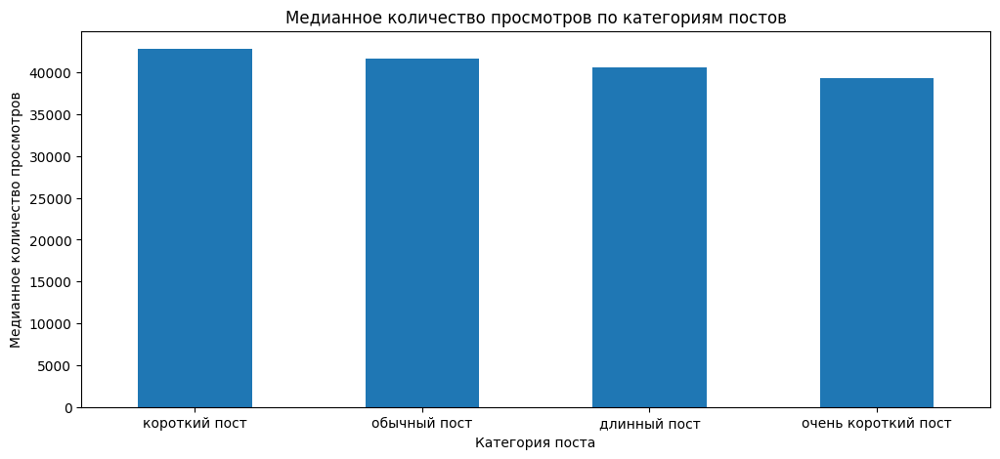

In [ ]:
channel_posts_filtered.groupby(by='post_cat')['views'].median().sort_values(ascending=False).plot(kind='bar',
       figsize=(12,5),
       title='Медианное количество просмотров по категориям постов',
       xlabel='Категория поста',
       ylabel='Медианное количество просмотров',
       rot=0
      );

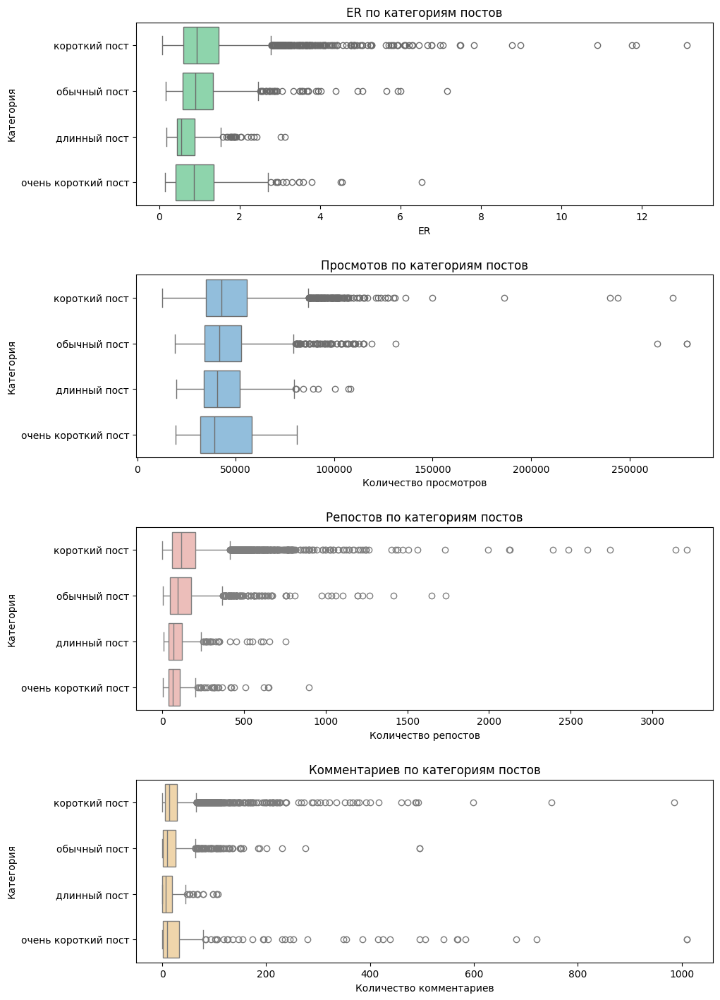

In [ ]:
fig, axes = plt.subplots(nrows=4, figsize = (10, 15))
fig.tight_layout(pad=5.0)

# ER
ax1 = sns.boxplot(x='er', y='post_cat', data=channel_posts_filtered, color='#82E0AA', ax=axes[0])
ax1.set(title = 'ER по категориям постов', ylabel = 'Категория', xlabel = 'ER')

# Просмотры
ax2 = sns.boxplot(x='views', y='post_cat', data=channel_posts_filtered, color='#85C1E9', ax=axes[1])
ax2.set(title = 'Просмотов по категориям постов', ylabel = 'Категория', xlabel = 'Количество просмотров')

# Репосты
ax3 = sns.boxplot(x='forwarded', y='post_cat', data=channel_posts_filtered, color='#F5B7B1', ax=axes[2])
ax3.set(title = 'Репостов по категориям постов', ylabel = 'Категория', xlabel = 'Количество репостов')

# Комментарии
ax4 = sns.boxplot(x='comments', y='post_cat', data=channel_posts_filtered, color='#FAD7A0', ax=axes[3])
ax4.set(title = 'Комментариев по категориям постов', ylabel = 'Категория', xlabel = 'Количество комментариев')

plt.show()

Мы видим, что у коротких постов выше всего ER, количество просмотров и репостов. Но разница по просмотрам у категорий не очень большая. А вот ER у больших постов значительно ниже, чем у других категорий, возможно, пользователи ленятся читать большие тексты и поэтому и не взаимодействуют с ними.

### Употребляемые слова

Посмотрим, какие слова чаще употребляются в постах, в зависимости от их ER - выше и ниже медианного значения.

Сохраним текст в разные переменные.

In [ ]:
min_er_text = ' '.join(channel_posts_filtered.query('er <= @channel_posts_filtered.er.median()')['clean_text'])
max_er_text = ' '.join(channel_posts_filtered.query('er > @channel_posts_filtered.er.median()')['clean_text'])

In [ ]:
# добавляем к стандартным знакам пунктуации кавычки и многоточие
spec_chars = string.punctuation + '«»\t—…’'
# делаем все слова с маленькой буквы
min_er_text = min_er_text.lower()
max_er_text = max_er_text.lower()

# очищаем текст от знаков препинания
min_er_text = "".join([ch for ch in min_er_text if ch not in spec_chars])
max_er_text = "".join([ch for ch in max_er_text if ch not in spec_chars])


In [ ]:
# меняем переносы строк на пробелы
min_er_text = re.sub('\n', ' ', min_er_text)
max_er_text = re.sub('\n', ' ', max_er_text)

In [ ]:

# убираем из текста цифры
min_er_text = "".join([ch for ch in min_er_text if ch not in string.digits])
max_er_text = "".join([ch for ch in max_er_text if ch not in string.digits])

In [ ]:
# токенизируем текст
min_er_text_tokens = word_tokenize(min_er_text)
max_er_text_tokens = word_tokenize(max_er_text)

# переводим токены в текстовый формат
min_er_text = nltk.Text(min_er_text_tokens)
max_er_text = nltk.Text(max_er_text_tokens)

# и считаем слова в тексте по популярности
min_er_text_fdist = FreqDist(min_er_text)
max_er_text_fdist = FreqDist(max_er_text)

# выводим первые 5 популярных слов
print(min_er_text_fdist.most_common(5))
print(max_er_text_fdist.most_common(5))

[('в', 7641), ('и', 7410), ('на', 3630), ('с', 2339), ('о', 1922)]
[('в', 6279), ('и', 5348), ('на', 3384), ('с', 1701), ('не', 1220)]


В самых популярных словах у нас предлоги. Необходимо очистить текст от них.

In [ ]:
# добавляем русские и английские стоп-слова
russian_stopwords = stopwords.words("russian")
russian_stopwords += stopwords.words("english")

In [ ]:
# перестраиваем токены, не учитывая стоп-слова
min_er_text_tokens = [token.strip() for token in min_er_text_tokens if token not in russian_stopwords]
max_er_text_tokens = [token.strip() for token in max_er_text_tokens if token not in russian_stopwords]
# снова приводим токены к текстовому виду
min_er_text = nltk.Text(min_er_text_tokens)
max_er_text = nltk.Text(max_er_text_tokens)
# считаем заново частоту слов
min_er_text_fdist = FreqDist(min_er_text)
max_er_text_fdist = FreqDist(max_er_text)
# показываем самые популярные
print(min_er_text_fdist.most_common(10))
print(max_er_text_fdist.most_common(10))

[('фильм', 783), ('это', 605), ('кинопоиск', 532), ('который', 521), ('кино', 520), ('фильма', 483), ('сериала', 469), ('рассказываем', 450), ('года', 438), ('сериал', 428)]
[('фильм', 760), ('это', 586), ('фото', 570), ('фильма', 528), ('года', 517), ('кинопоиск', 515), ('подписывайтесь', 473), ('сериала', 404), ('премьера', 400), ('🔥', 363)]


мы видим, что в тексте часто встречается слово "это", добавим его в стоп слова.

In [ ]:
# добавляем свои слова в этот список
russian_stopwords.extend(['это'])
# перестраиваем токены, не учитывая стоп-слова
min_er_text_tokens = [token.strip() for token in min_er_text_tokens if token not in russian_stopwords]
max_er_text_tokens = [token.strip() for token in max_er_text_tokens if token not in russian_stopwords]
# снова приводим токены к текстовому виду
min_er_text = nltk.Text(min_er_text_tokens)
max_er_text = nltk.Text(max_er_text_tokens)
# считаем заново частоту слов
min_er_text_fdist = FreqDist(min_er_text)
max_er_text_fdist = FreqDist(max_er_text)
# показываем самые популярные
print(min_er_text_fdist.most_common(10))
print(max_er_text_fdist.most_common(10))

[('фильм', 783), ('кинопоиск', 532), ('который', 521), ('кино', 520), ('фильма', 483), ('сериала', 469), ('рассказываем', 450), ('года', 438), ('сериал', 428), ('подписывайтесь', 385)]
[('фильм', 760), ('фото', 570), ('фильма', 528), ('года', 517), ('кинопоиск', 515), ('подписывайтесь', 473), ('сериала', 404), ('премьера', 400), ('🔥', 363), ('лет', 357)]


Сделаем облако слов.

In [ ]:
# переводим всё в текстовый формат
min_er_text_raw = " ".join(min_er_text)
max_er_text_raw = " ".join(max_er_text)


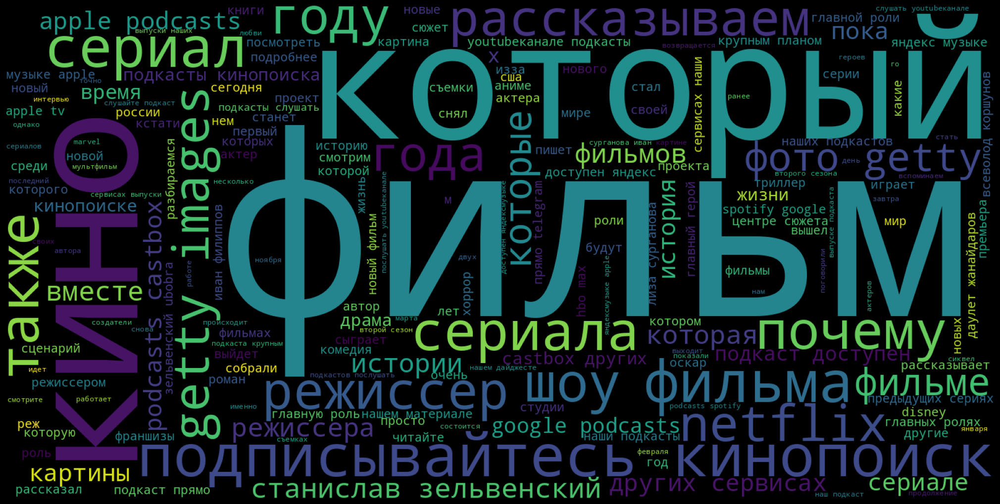

In [ ]:
# готовим размер картинки
wordcloud = WordCloud(width=1600, height=800).generate(min_er_text_raw)
plt.figure( figsize=(20,10), facecolor='k')
# добавляем туда облако слов
plt.imshow(wordcloud)
# выключаем оси и подписи
plt.axis("off")
# убираем рамку вокруг
plt.tight_layout(pad=0)
# выводим картинку на экран
plt.show()

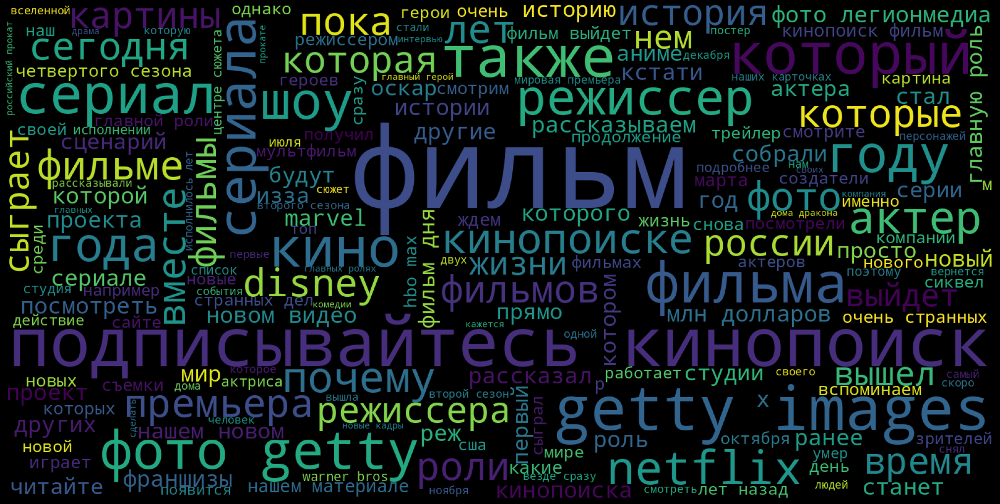

In [ ]:
# готовим размер картинки
wordcloud = WordCloud(width=1600, height=800).generate(max_er_text_raw)
plt.figure( figsize=(20,10), facecolor='k')
# добавляем туда облако слов
plt.imshow(wordcloud)
# выключаем оси и подписи
plt.axis("off")
# убираем рамку вокруг
plt.tight_layout(pad=0)
# выводим картинку на экран
plt.show()

Мы видим, что много повторяющихся слов, которые нам надо очистить еще, а именно привести их к нормальной форме.
Нормальная форма слова — это то, как оно записано в словаре:

- для глаголов это будет неопределённая форма;
- для существительных — единственное число, именительный падеж;
- для прилагательных — единственное число, именительный падеж, мужской род.


In [ ]:
# добавляем анализатор слов
morph = pymorphy2.MorphAnalyzer()
# тут будут те же самые слова, что и в исходном тексте, но в нормальной форме
min_er_filtered_tokens = []
max_er_filtered_tokens = []
# перебираем все слова в исходном тексте
#для er<= median
for token in min_er_text_tokens:
    # получаем нормальную форму текущего слова
    p = morph.parse(str(token))[0]
    # добавляем его в новый массив
    min_er_filtered_tokens.append(p.normal_form)
#для er> median
for token in max_er_text_tokens:
    # получаем нормальную форму текущего слова
    p = morph.parse(str(token))[0]
    # добавляем его в новый массив
    max_er_filtered_tokens.append(p.normal_form)

In [ ]:
# переводим токены в текстовый формат
min_er_text = nltk.Text(min_er_filtered_tokens)
max_er_text = nltk.Text(max_er_filtered_tokens)


In [ ]:

# считаем заново частоту слов
min_er_text_fdist = FreqDist(min_er_text)
max_er_text_fdist = FreqDist(max_er_text)
# показываем самые популярные
print(min_er_text_fdist.most_common(10))
print(max_er_text_fdist.most_common(10))

[('фильм', 2235), ('который', 1627), ('сериал', 1425), ('кинопоиск', 1253), ('новый', 1238), ('год', 1119), ('наш', 991), ('главный', 845), ('подкаст', 741), ('режиссёр', 723)]
[('фильм', 2163), ('год', 1352), ('который', 1146), ('сериал', 1093), ('новый', 1051), ('кинопоиск', 917), ('выйти', 642), ('первый', 636), ('роль', 630), ('наш', 611)]


Мы видим, что есть много слов, котоыре встречаются и не несут для нас никакой пользы: кинопоиск, который, год

In [ ]:
# добавляем свои слова в этот список
russian_stopwords.extend(['это', 'кинопоиск', 'который', 'год'])
# перестраиваем токены, не учитывая стоп-слова
min_er_filtered_tokens = [token.strip() for token in min_er_filtered_tokens if token not in russian_stopwords]
max_er_filtered_tokens = [token.strip() for token in max_er_filtered_tokens if token not in russian_stopwords]
# снова приводим токены к текстовому виду
min_er_text = nltk.Text(min_er_filtered_tokens)
max_er_text = nltk.Text(max_er_filtered_tokens)
# считаем заново частоту слов
min_er_text_fdist = FreqDist(min_er_text)
max_er_text_fdist = FreqDist(max_er_text)
# показываем самые популярные
print(min_er_text_fdist.most_common(10))
print(max_er_text_fdist.most_common(10))

[('фильм', 2235), ('сериал', 1425), ('новый', 1238), ('наш', 991), ('главный', 845), ('подкаст', 741), ('режиссёр', 723), ('рассказывать', 691), ('первый', 617), ('роль', 614)]
[('фильм', 2163), ('сериал', 1093), ('новый', 1051), ('выйти', 642), ('первый', 636), ('роль', 630), ('наш', 611), ('фото', 570), ('премьера', 569), ('главный', 557)]


Также мы видим, что фильм, сериал, новый встречаются часто в обоих списках, очистим и от них.

In [ ]:
# добавляем свои слова в этот список
russian_stopwords.extend(['фильм', 'сериал', 'новый'])
# перестраиваем токены, не учитывая стоп-слова
min_er_filtered_tokens = [token.strip() for token in min_er_filtered_tokens if token not in russian_stopwords]
max_er_filtered_tokens = [token.strip() for token in max_er_filtered_tokens if token not in russian_stopwords]
# снова приводим токены к текстовому виду
min_er_text = nltk.Text(min_er_filtered_tokens)
max_er_text = nltk.Text(max_er_filtered_tokens)
# считаем заново частоту слов
min_er_text_fdist = FreqDist(min_er_text)
max_er_text_fdist = FreqDist(max_er_text)
# показываем самые популярные
print(min_er_text_fdist.most_common(10))
print(max_er_text_fdist.most_common(10))

[('наш', 991), ('главный', 845), ('подкаст', 741), ('режиссёр', 723), ('рассказывать', 691), ('первый', 617), ('роль', 614), ('выйти', 597), ('хороший', 553), ('сезон', 538)]
[('выйти', 642), ('первый', 636), ('роль', 630), ('наш', 611), ('фото', 570), ('премьера', 569), ('главный', 557), ('сезон', 526), ('режиссёр', 503), ('актёр', 488)]


Готовим текст для облака слов.

In [ ]:
min_er_text_raw = " ".join(min_er_text)
max_er_text_raw = " ".join(max_er_text)

Облако слов для постов с ER меньше или равным медианного значения

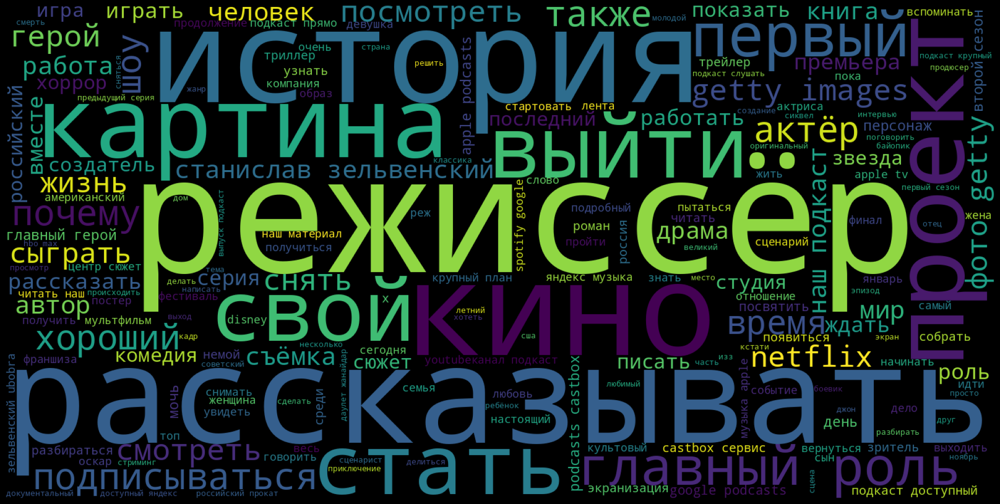

In [ ]:
# готовим размер картинки
wordcloud = WordCloud(width=1600, height=800).generate(min_er_text_raw)
plt.figure( figsize=(20,10), facecolor='k')
# добавляем туда облако слов
plt.imshow(wordcloud)
# выключаем оси и подписи
plt.axis("off")
# убираем рамку вокруг
plt.tight_layout(pad=0)
# выводим картинку на экран
plt.show()



Облако слов для постов с ER больше медианного значения

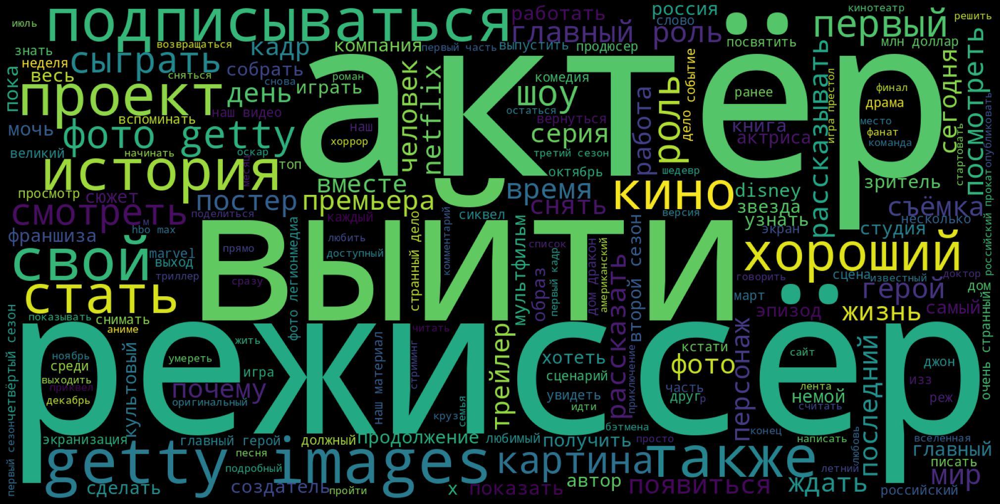

In [ ]:
# готовим размер картинки
wordcloud = WordCloud(width=1600, height=800).generate(max_er_text_raw)
plt.figure( figsize=(20,10), facecolor='k')
# добавляем туда облако слов
plt.imshow(wordcloud)
# выключаем оси и подписи
plt.axis("off")
# убираем рамку вокруг
plt.tight_layout(pad=0)
# выводим картинку на экран
plt.show()

Построим облака слов для существительных, прилагательных и глаголов.

In [ ]:
# новые переменные для существительных, прилагательных и глаголов
min_er_noun_tokens = []
min_er_adjf_tokens = []
min_er_verb_tokens = []
# перебираем все слова в исходном тексте
for token in min_er_filtered_tokens:
    # получаем нормальную форму текущего слова
    p = morph.parse(str(token))[0]
    if "NOUN" in p.tag:
        # добавляем его в массив c существительными
        min_er_noun_tokens.append(p.normal_form)
    elif "ADJF" in p.tag or "ADJS" in p.tag:
        # добавляем его в массив c прилагательными
        min_er_adjf_tokens.append(p.normal_form)
    elif "VERB" in p.tag or "INFN" in p.tag:
        # добавляем его в массив c глаголами
        min_er_verb_tokens.append(p.normal_form)



In [ ]:
# новые переменные для существительных, прилагательных и глаголов
max_er_noun_tokens = []
max_er_adjf_tokens = []
max_er_verb_tokens = []
# перебираем все слова в исходном тексте
for token in max_er_filtered_tokens:
    # получаем нормальную форму текущего слова
    p = morph.parse(str(token))[0]
    if "NOUN" in p.tag:
        # добавляем его в массив c существительными
        max_er_noun_tokens.append(p.normal_form)
    elif "ADJF" in p.tag or "ADJS" in p.tag:
        # добавляем его в массив c прилагательными
        max_er_adjf_tokens.append(p.normal_form)
    elif "VERB" in p.tag or "INFN" in p.tag:
        # добавляем его в массив c глаголами
        max_er_verb_tokens.append(p.normal_form)

Чтобы не повторять код с построением облака подготовим функцию.

In [ ]:
def words_cloud(tokens):
  text = nltk.Text(tokens)
  text_raw = " ".join(text)
  # готовим размер картинки
  wordcloud = WordCloud(width=1600, height=800).generate(text_raw)
  plt.figure(figsize=(20,10), facecolor='k')
  # добавляем туда облако слов
  plt.imshow(wordcloud)
  # выключаем оси и подписи
  plt.axis("off")
  # убираем рамку вокруг
  plt.tight_layout(pad=0)
  # выводим картинку на экран
  plt.show()

И посмотрим на каждые части речи отдельно.

#### Существительные

**ER <= median**

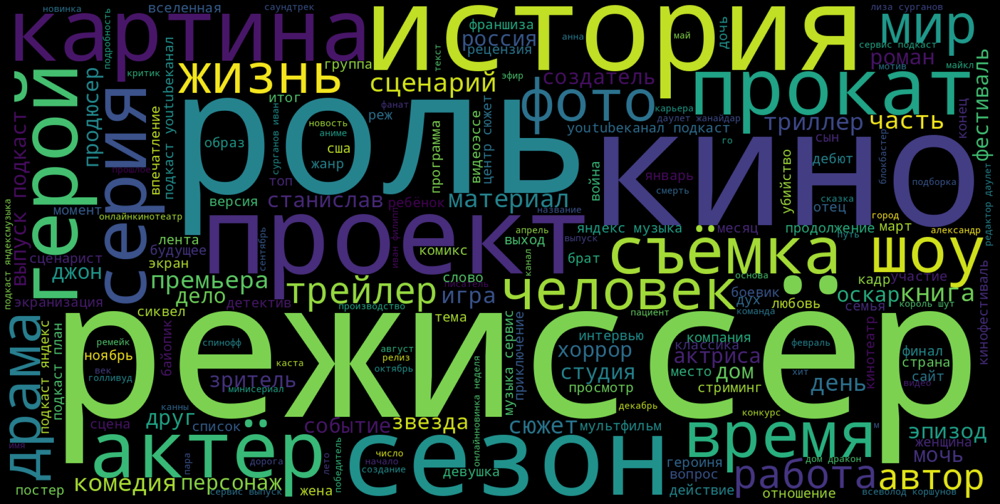

In [ ]:
words_cloud(min_er_noun_tokens)

**ER > median**

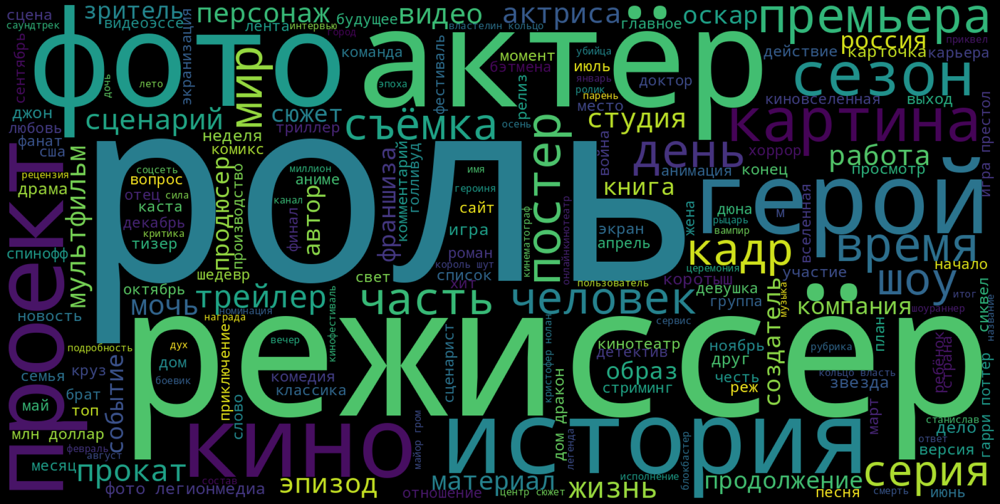

In [ ]:
words_cloud(max_er_noun_tokens)

Набор слов очень похож, но как будто пользователи хуже взаимоействуют с постами о прокате фильмов.

#### Прилагательные

**ER <= median**

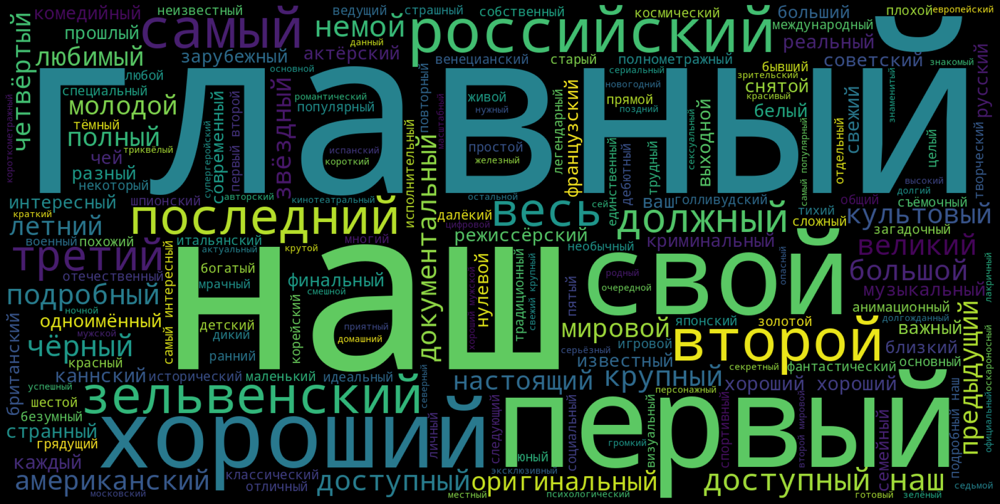

In [ ]:
words_cloud(min_er_adjf_tokens)

**ER > median**

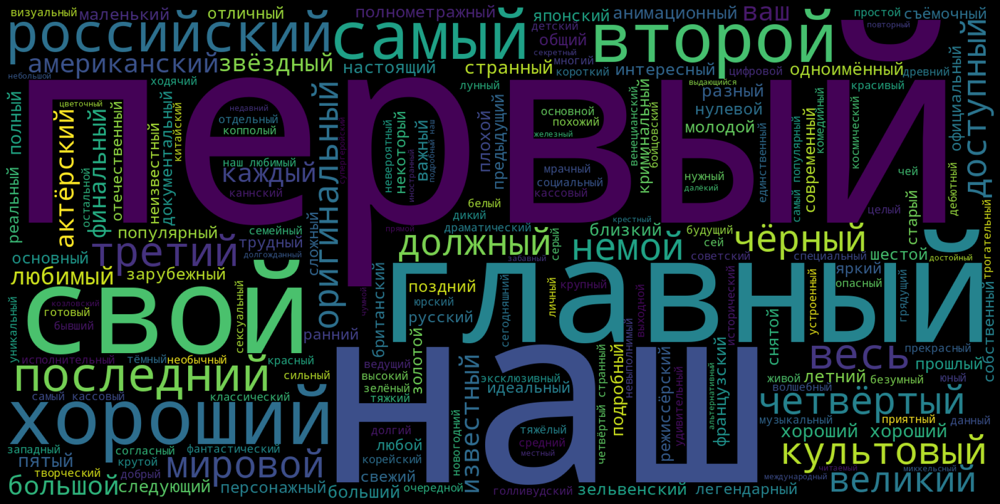

In [ ]:
words_cloud(max_er_adjf_tokens)

По прилагательным ситуация также похожа, кажется, что пользователям меньше интересна информация о российских фильмах.

#### Глаголы

**ER <= median**

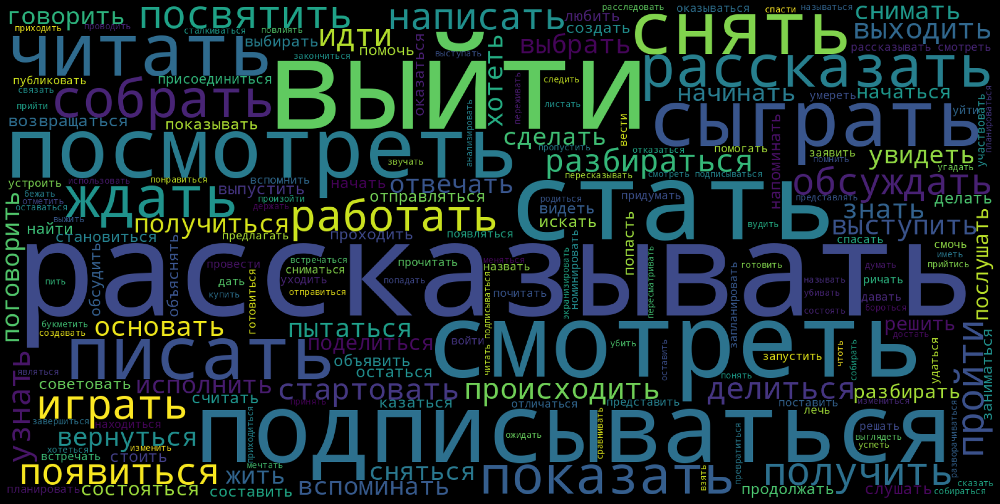

In [ ]:
words_cloud(min_er_verb_tokens)

**ER > median**

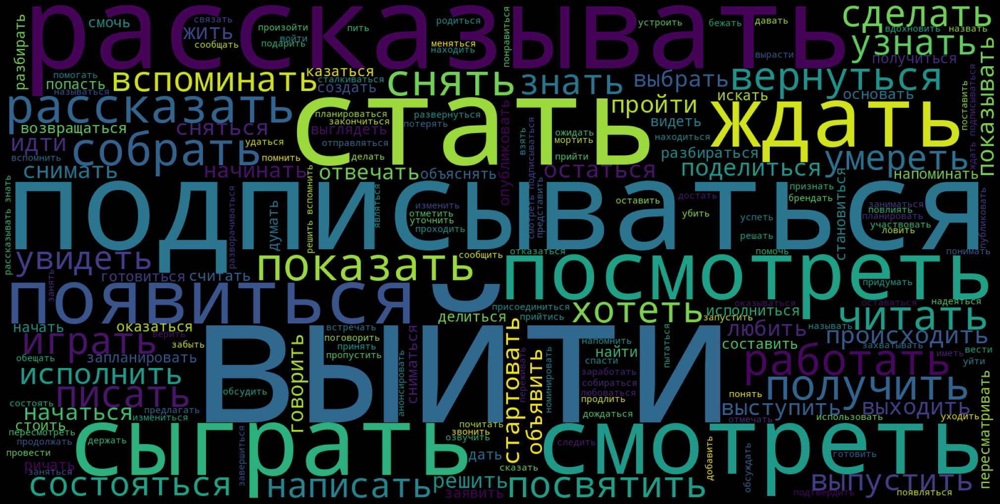

In [ ]:
words_cloud(max_er_verb_tokens)

По глаголам есть разница, что у постов с большим ER есть слово "появиться", что может говорить нам о том, что пользователям интересна информация о новинках.

Наборы слов очень похоиж, но как будто пользователи хуже взаимодействуют с постами о прокате фильмо и о отечественных картинах, но больше интересна информация о новинках.

Для дальнейшего удобства упакуем получение токенов в функцию.

In [ ]:
def get_word_tokens(text):

    """
    Функция для получения токенов существительных, прилагательных и глаголов текста,
    для последующего построения облака слов

    Args:
        text(str): текст, токены котоорого мы хотим получить

    Returns:
       text_noun_tokens(list):  токены существительных
       text_adjf_tokens:  токены прилагательных
       text_verb_tokens:  токены глаголов
    """
    # делаем все слова с маленькой буквы
    text = text.lower()
    # очищаем текст от знаков препинания
    text = "".join([ch for ch in text if ch not in spec_chars])
    # меняем переносы строк на пробелы
    text = re.sub('\n', ' ', text)
    # убираем из текста цифры
    text = "".join([ch for ch in text if ch not in string.digits])
    # токенизируем текст
    text_tokens = word_tokenize(text)

    #фильтруем от стоп-слов
    text_tokens = [token.strip() for token in text_tokens if token not in russian_stopwords]

    # добавляем анализатор слов
    morph = pymorphy2.MorphAnalyzer()
    # тут будут те же самые слова, что и в исходном тексте, но в нормальной форме
    text_filtered_tokens = []

    # перебираем все слова в исходном тексте

    for token in text_tokens:
        # получаем нормальную форму текущего слова
        p = morph.parse(str(token))[0]
        # добавляем его в новый массив
        text_filtered_tokens.append(p.normal_form)

    # новые переменные для существительных, прилагательных и глаголов
    text_noun_tokens = []
    text_adjf_tokens = []
    text_verb_tokens = []
    # перебираем все слова в исходном тексте
    for token in text_filtered_tokens:
        # получаем нормальную форму текущего слова
        p = morph.parse(str(token))[0]
        if "NOUN" in p.tag:
            # добавляем его в массив c существительными
            text_noun_tokens.append(p.normal_form)
        elif "ADJF" in p.tag or "ADJS" in p.tag:
            # добавляем его в массив c прилагательными
            text_adjf_tokens.append(p.normal_form)
        elif "VERB" in p.tag or "INFN" in p.tag:
            # добавляем его в массив c глаголами
            text_verb_tokens.append(p.normal_form)
    return text_noun_tokens, text_adjf_tokens, text_verb_tokens

### Анализ комментариев

Посмотрим, какие комментарии пишут пользователи под постами с разной ER.

Для определения, тона комментариев (положительный, негативный или нейтральный) мы будем использовать библиотеки dostoevsky и FastTextSocialNetworkModel, к сожалению запустить их через блокнот не получилось, поэтому прилагаем скрипт app.py, с помощью которого выполнен анализ.  
Загружаем полученный датафрейм.

In [ ]:
# подготавливаем ссылки для скачивания файлов с Яндекс.Диска.
# публичная ссылка на датасеты на яндекс диске
folder_url = 'https://disk.yandex.ru/d/nflbLG3sCHE-sg'
# названия файлов
file_url = ['comments_with_sentiment.csv']

# загружаем каждый файл в свой датафрейм
url = ('https://cloud-api.yandex.net/v1/disk/public/resources/download'
        + '?public_key='
        + urllib.parse.quote(folder_url)
        + '&path=/'
        + urllib.parse.quote(file_url[0]))
  # запрос ссылки на скачивание
r = requests.get(url)
   # 'парсинг' ссылки на скачивание
h = json.loads(r.text)['href']


comments_sentiment = pd.read_csv(h, index_col=[0])


In [ ]:
comments_sentiment = comments_sentiment.reset_index()

In [ ]:
print(comments_sentiment.info())
display(comments_sentiment.sample(5))

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 138902 entries, 0 to 138901
Data columns (total 5 columns):
 #   Column    Non-Null Count   Dtype  
---  ------    --------------   -----  
 0   post      132175 non-null  object 
 1   id        138902 non-null  int64  
 2   neutral   138902 non-null  float64
 3   negative  138902 non-null  float64
 4   positive  138902 non-null  float64
dtypes: float64(3), int64(1), object(1)
memory usage: 5.3+ MB
None


,post,id,neutral,negative,positive
15147,Не ссылки не чего,36247,0.999457,0.095359,0.000000
113234,Неделю,31060,0.995255,0.001937,0.000000
35955,Через год будет сентябрь. Это повтор? Это стагнация? Это раздражает?,34811,0.952584,0.067557,0.000000
4831,"Чувак хватит спорить пока не доказано не калышит,что сказано всё просто",36866,0.000000,0.637041,0.182436
53054,ну вот мне и интересно как там детям взрослые этот момент объясняют,33762,0.847978,0.000000,0.191943


В датафрейме 5 колонок и 138902 строк.
- `post` - текст комментария,
- `id` - id поста к которому был сделан комментарий,
- `neutral` - уровень нейтральнсти поста от 0 до 1, где 1 точно нейтральный, а 0 точно не нейтральный,
- `negative` - уровень негативности поста от 0 до 1, где 1 точно негативный, а 0 точно не негативный,
- `positive`  - уровень позитивности поста от 0 до 1, где 1 точно позитивный, а 0 точно не позитивный.


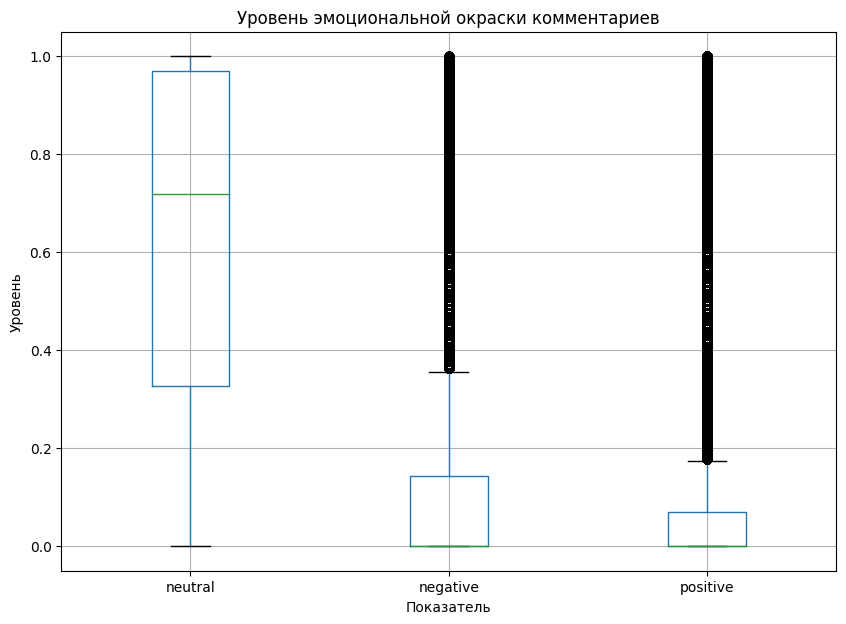

Уровень нейтральности комментариев
count    138902.000000
mean          0.620568
std           0.358339
min           0.000000
1%            0.000000
5%            0.000000
25%           0.327678
50%           0.718604
75%           0.968866
95%           1.000010
99%           1.000010
max           1.000010
Name: neutral, dtype: float64

Уровень негативности комментариев
count    138902.000000
mean          0.097521
std           0.179495
min           0.000000
1%            0.000000
5%            0.000000
25%           0.000000
50%           0.000000
75%           0.144159
95%           0.484390
99%           0.822199
max           1.000010
Name: negative, dtype: float64

Уровень позитивности комментариев
count    138902.000000
mean          0.108561
std           0.235973
min           0.000000
1%            0.000000
5%            0.000000
25%           0.000000
50%           0.000000
75%           0.069552
95%           0.743178
99%           0.996065
max           1.000010
Name: 

In [ ]:
plt.figure( figsize=(10,7))
comments_sentiment[['neutral', 'negative', 'positive']].boxplot()

plt.xlabel('Показатель')
plt.ylabel('Уровень')
plt.title('Уровень эмоциональной окраски комментариев')
plt.grid(alpha=1)
plt.show();

print('Уровень нейтральности комментариев')
print(comments_sentiment['neutral'].describe(percentiles=[0.01, 0.05, 0.25, 0.5, 0.75, 0.95, 0.99]))
print()
print('Уровень негативности комментариев')
print(comments_sentiment['negative'].describe(percentiles=[0.01, 0.05, 0.25, 0.5, 0.75, 0.95, 0.99]))
print()
print('Уровень позитивности комментариев')
print(comments_sentiment['positive'].describe(percentiles=[0.01, 0.05, 0.25, 0.5, 0.75, 0.95, 0.99]))

Обычно, уровень негативности в комментариях от 0 до 0,35, в среднем 0.09, а медианное значение 0, т.е. половина комментариев точно не негативная.  
Обычно, уровень позитива в комментариях от 0 до 0,19, в среднем 0.1, а медианное значение 0, т.е. половина комментариев точно не позитивные.  
Обычно, уровень нейтральности в постах от 0 до 1, в среднем 0.62, а медианное значение 0,71, т.е. большая часть комментариев имеет нейтральный тон.  
Выглядит так, что пользователи чаще всего отавляют нейтральные комментарие, а позитивные реже всего.

Посмотрим, разный ли уровень эмоциональной окраски у коментариев у постов с разным ER.

In [ ]:
er_min_ids = channel_posts_filtered.query('er <= @channel_posts_filtered.er.median()')['id']
er_max_ids = channel_posts_filtered.query('er > @channel_posts_filtered.er.median()')['id']

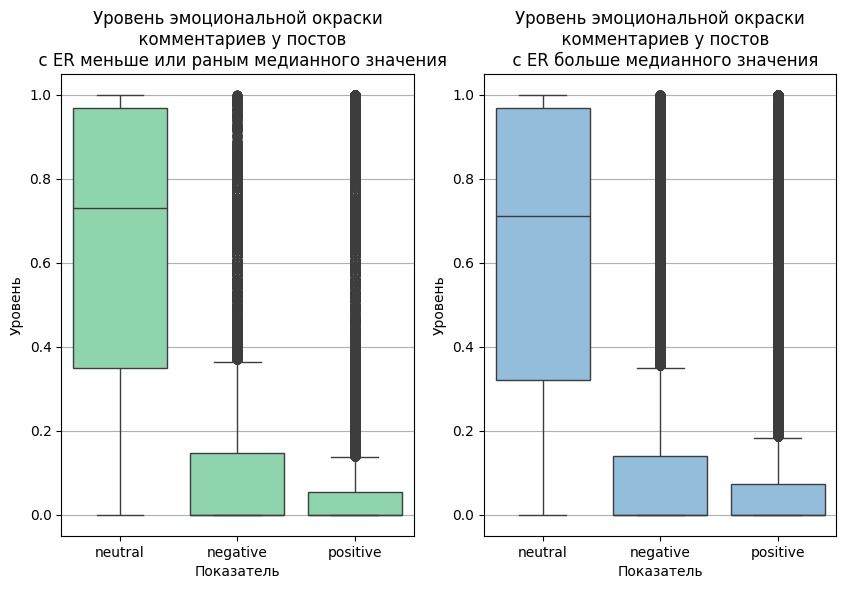

In [ ]:
fig, axes = plt.subplots(ncols=2, figsize = (10, 6))


# ER <= median
ax1 = sns.boxplot(data=comments_sentiment.query('id in @er_min_ids')[['neutral', 'negative', 'positive']],
                  color='#82E0AA',
                  ax=axes[0])
ax1.set(title = """Уровень эмоциональной окраски
  комментариев у постов
  с ER меньше или раным медианного значения""", ylabel = 'Уровень', xlabel = 'Показатель')
ax1.yaxis.grid(True)

# ER > median
ax2 = sns.boxplot(data=comments_sentiment.query('id in @er_max_ids')[['neutral', 'negative', 'positive']],
                  color='#85C1E9',
                  ax=axes[1])
ax2.set(title = """Уровень эмоциональной окраски
  комментариев у постов
  с ER больше медианного значения""", ylabel = 'Уровень', xlabel = 'Показатель')
ax2.yaxis.grid(True)

plt.show()

Выглядит так, как будто у постов с лучшей вовлеченностью уровень позитивности комментариев выше, посмотрим на цифры.

In [ ]:
print('Уровень позитивности комментариев у постов с ER меньше или равным медианного згначения')
print(comments_sentiment
      .query('id in @er_min_ids')['positive']
      .describe(percentiles=[0.5, 0.75, 0.95, 0.99]))
print()
print('Уровень позитивности комментариев у постов с ER больше медианного згначения')
print(comments_sentiment
      .query('id in @er_max_ids')['positive']
      .describe(percentiles=[0.5, 0.75, 0.95, 0.99]))

Уровень позитивности комментариев у постов с ER меньше или равным медианного згначения
count    34019.000000
mean         0.102544
std          0.227765
min          0.000000
50%          0.000000
75%          0.055015
95%          0.699264
99%          0.992848
max          1.000010
Name: positive, dtype: float64

Уровень позитивности комментариев у постов с ER больше медианного згначения
count    104883.000000
mean          0.110513
std           0.238542
min           0.000000
50%           0.000000
75%           0.073706
95%           0.754925
99%           0.996633
max           1.000010
Name: positive, dtype: float64


Можно сказать, что у постов с высокой вовлеченностью комментарии немного позитивнее, чем у постов с меньшей вовлеченностью.

#### Облако слов комментариев

Облака слов оказались почти идентичными, а выполнение кода занимает много времени и ресурсов, поэтому сейчас код закомментирован. При необходимости его можно раскомментировать и выполнить.

Посмотрим на облако слов коментариев

Обновим стоп-слова

In [ ]:
#russian_stopwords = stopwords.words("russian")
#russian_stopwords += stopwords.words("english")

Подготовим текст.

In [ ]:
#comments_sentiment['post'] = comments_sentiment['post'].astype('str')
#er_min_comments = ' '.join(comments_sentiment.query('id in @er_min_ids')['post'])
#er_max_comments = ' '.join(comments_sentiment.query('id in @er_max_ids')['post'])

Применим подготовленную ранее функцию для получения токенов.

In [ ]:
#er_min_com_noun_tokens, er_min_com_adjf_tokens, er_min_com_verb_tokens = get_word_tokens(er_min_comments)
#er_max_com_noun_tokens, er_max_com_adjf_tokens, er_max_com_verb_tokens = get_word_tokens(er_max_comments)

#### Существительные

**ER меньше или равен медианному значению**

In [ ]:
#words_cloud(er_min_com_noun_tokens)


**ER больше медианного значения**

In [ ]:
#words_cloud(er_max_com_noun_tokens)


#### Прилагательные

**ER меньше или равен медианному значению**

In [ ]:
#words_cloud(er_min_com_adjf_tokens)

**ER больше медианного значения**

In [ ]:
#words_cloud(er_max_com_adjf_tokens)

#### Глаголы

**ER меньше или равен медианному значению**

In [ ]:
#words_cloud(er_min_com_verb_tokens)

**ER больше медианного значения**

In [ ]:
#words_cloud(er_max_com_verb_tokens)

Разницы в словах у постов с разной вовлеченностью, можно сказать, нет.

### Корреляция

Посмотрим, есть ли у нас корреляция между показателями постов.

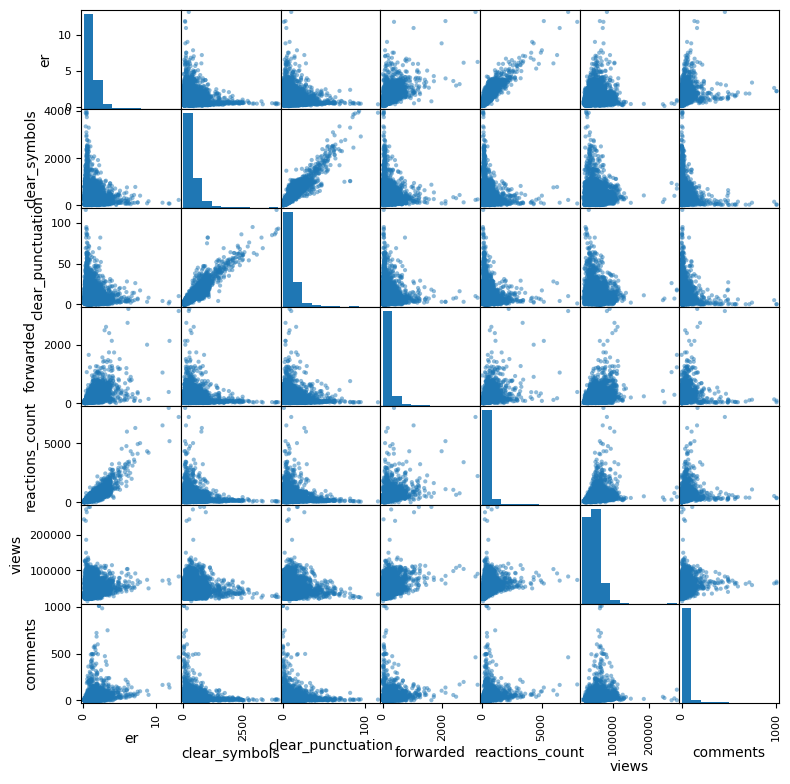

In [ ]:
pd.plotting.scatter_matrix(channel_posts_filtered[['er',
                                                   'clear_symbols',
                                                   'clear_punctuation',
                                                   'forwarded',
                                                   'reactions_count',
                                                   'views',
                                                   'comments']], figsize=(9, 9));

In [ ]:
display(pd.DataFrame(channel_posts_filtered[['er',
                                             'clear_symbols',
                                             'clear_punctuation',
                                             'forwarded',
                                             'reactions_count',
                                             'views',
                                             'comments']].corr()).style.background_gradient('coolwarm'))

,er,clear_symbols,clear_punctuation,forwarded,reactions_count,views,comments
er,1.000000,-0.124445,-0.072238,0.630640,0.857685,0.096318,0.311890
clear_symbols,-0.124445,1.000000,0.922682,-0.061784,-0.098189,-0.023614,-0.090965
clear_punctuation,-0.072238,0.922682,1.000000,-0.032708,-0.057557,-0.030044,-0.065729
forwarded,0.630640,-0.061784,-0.032708,1.000000,0.477325,0.382870,0.214702
reactions_count,0.857685,-0.098189,-0.057557,0.477325,1.000000,0.354819,0.284498
views,0.096318,-0.023614,-0.030044,0.382870,0.354819,1.000000,0.264329
comments,0.311890,-0.090965,-0.065729,0.214702,0.284498,0.264329,1.000000


Т.к. Вовлеченность рассчитывается, как (Количество комментариев + колличество реакций + количество репостов) * 100 / количество просмотров, то корреляция с ними логична. И мы видим, что количество символов или количество знаков препинания практически не влияет ни на какой показатель.

Проверим корреляцию статистически.

In [ ]:
def df_corr_chec(df = channel_posts_filtered, first_par = 'er', second_par = 'clear_symbols', alpha=0.05):

    """
    Функция для подсчета коэффициентов корреляции Пирсона и Спирмана, а также их уровня значимости

    Args:
        df(pd.DataFrame): датафрейм,
        first_par(str): название столбца, который примем за первый параметр для сравнения
        second_par(str): название столбца, который примем за второй параметр сравнения

    Returns:
       coeffs(str):  коэффициенты Пирсона и спирмана, а также уровни значимости и вывод.
    """

    kp = pearsonr(df[first_par], df[second_par])
    ks = spearmanr(df[first_par], df[second_par])
    print(f'pearson_cor: {kp[0]}, pearson_pv: {kp[1]}')
    print(f'spearman_cor: {ks[0]}, spearman_pv: {ks[1]}')
    if kp[1] < alpha and ks[1] < alpha:
      print('Отвергаем нулевую гипотезу, есть основания считать что связь есть')
    elif kp[1] >= alpha and ks[1] >= alpha:
      print('Не отвергаем нулевую гипотезу, есть основания считать что связи нет')
    else:
      print('Нельзя однозначно сказать')



Нулевая гипотеза:ρ=0 (связи нет)
Альтернативная гипотеза:ρ≠0 (связь есть)

In [ ]:
for i in ('clear_symbols', 'clear_punctuation'):
  print(i)
  df_corr_chec(channel_posts_filtered, 'er', i)

clear_symbols
pearson_cor: -0.1244446969521386, pearson_pv: 1.6977161270122093e-26
spearman_cor: -0.11829976695992515, spearman_pv: 4.3835860116619664e-24
Отвергаем нулевую гипотезу, есть основания считать что связь есть
clear_punctuation
pearson_cor: -0.07223813014170918, pearson_pv: 6.933268896032842e-10
spearman_cor: -0.06830974265548968, spearman_pv: 5.496611166956259e-09
Отвергаем нулевую гипотезу, есть основания считать что связь есть


Хоть статистически показывает, что связь есть, коэффициенты корреляции слишком небольшие, чтобы сказать однозначно.

### Анализ эмодзи

Проанализируем эмодзи к постам.

Подготовим пустой датафрейм.

In [ ]:
emoji_df = pd.DataFrame(columns=['id', 'date', 'emoji', 'count'])

Подготовим функцию для получения id поста, его дату, эмодзи к нему и их количество

In [ ]:
def get_reactions(row):

    """
    Функция для получения id поста, его даты, реакций и их количества

    Args:
        row(pd.DataFrame): строка датафрейма,

    Returns:
       emoji_rows(pd.DataFrame):  датафрейм с id поста колонки, его даты, реакций и их количества.
    """
    emoji_rows = []
    try:
        reactions = ast.literal_eval(row['reactions'])
        for reaction in reactions['results']:
            emoji = reaction['reaction'].get('emoticon', None)
            count = reaction['count']
            emoji_rows.append({'id': row['id'], 'emoji': emoji, 'count': count, 'date':row['post_date']})
    except Exception as e:
        print(f"Error: {e}")
    return emoji_rows

Применим функцию.

In [ ]:
for index, row in channel_posts_filtered.iterrows():
    emoji_rows = get_reactions(row)
    emoji_df = emoji_df.append(emoji_rows, ignore_index=True)

Error: malformed node or string: nan
Error: malformed node or string: nan
Error: malformed node or string: nan
Error: malformed node or string: nan
Error: malformed node or string: nan
Error: malformed node or string: nan
Error: malformed node or string: nan
Error: malformed node or string: nan
Error: malformed node or string: nan
Error: malformed node or string: nan
Error: malformed node or string: nan
Error: malformed node or string: nan
Error: malformed node or string: nan
Error: malformed node or string: nan
Error: malformed node or string: nan


In [ ]:
print(emoji_df.info())
display(emoji_df.head())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 56360 entries, 0 to 56359
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   id      56360 non-null  object
 1   date    56360 non-null  object
 2   emoji   56360 non-null  object
 3   count   56360 non-null  object
dtypes: object(4)
memory usage: 1.7+ MB
None


,id,date,emoji,count
0,37125,2024-01-21,❤,41
1,37125,2024-01-21,👍,8
2,37125,2024-01-21,🐳,4
3,37125,2024-01-21,👎,3
4,37125,2024-01-21,❤‍🔥,1


В нашем распоряжении датафрейм с 4 колонками и 56359 строками.  
- `id` - id поста
- `date` - дата поста
- `emoji` - реакция к посту
- `count` - количество этих реакций к посту.

Посотрим на ТОП10 самых популярных реакций.

In [ ]:
top_10_reactions = (emoji_df
                    .groupby(by='emoji', as_index=False)['count'].sum()
                    .sort_values(by='count', ascending=False)
                    .head(10))
display(top_10_reactions)

,emoji,count
18,👍,846086
2,❤,712377
19,👎,237739
29,🔥,229279
3,❤‍🔥,135063
39,😢,115931
33,😁,58495
45,🤔,37173
25,💔,25383
56,🥰,21293


Абсолютным рекордсменом является палец вверх, на втором месте сердечко, а на третьем палец вниз.

Посмотрим, как менялись реакции по месяцам, для этого добавим столбец месяца к нашему датафрейму.

In [ ]:
emoji_df['month'] = pd.to_datetime(emoji_df['date'], format='%Y-%m-%d').dt.to_period('M')

И посчитаем сумму реакций топ3 самых популярных эмодзи по месяцам.

emoji,❤,👍,👎
month,,,
2021-12,246,62,2
2022-01,3322,16958,1380
2022-02,2618,16338,4945
2022-03,11231,41555,11523
2022-04,14184,45092,11257
2022-05,17065,51179,9465
2022-06,18118,41185,8290
2022-07,17729,42857,7344
2022-08,36200,51520,8946


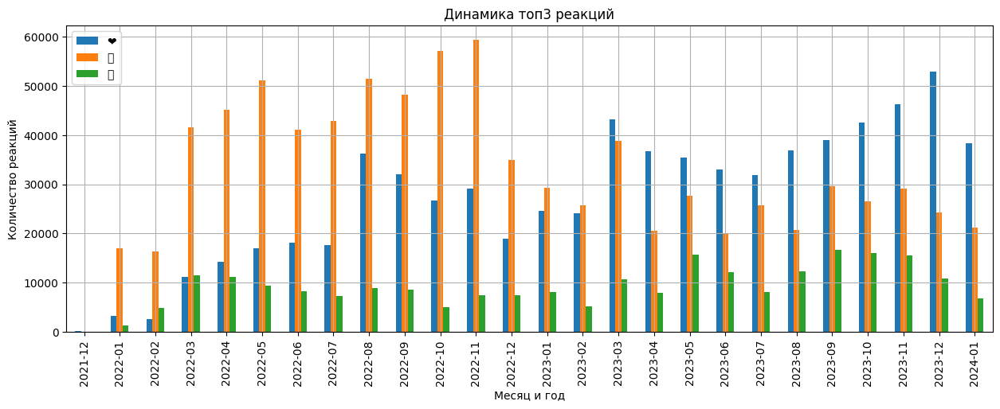

In [ ]:
temp = emoji_df.query('emoji in @top_10_reactions.head(3).emoji').pivot_table(
        index='month',
        values='count',
        aggfunc='sum',
        columns='emoji')
display(temp)
temp.plot(kind="bar", grid=True, figsize=(15, 5))
plt.xlabel('Месяц и год')
plt.title('Динамика топ3 реакций')
plt.ylabel('Количество реакций')
plt.legend(loc='upper left')
plt.show();

Из-за недоступности кодировки в графике легенда не так понятна, но:
- синий цвет - сердечко,
- оранжевый цыет - палец вверх,
- зеленый цвет - палец вниз.

Мы видим, что до марта 2023 года самой популрной реакцией был палец вверх, а после - сердечко.

### Статистический анализ

Для статистического анализа подготовим функцию, для проведения теста Уилкоксона.

In [ ]:
def test_wilcoxon(group1,
                  group2,
                  alpha=0.05,
                  sample_volume=50,
                  multiplicity = 1,
                  correction = 'bonferrony'):
  """
    Функция для проверки статистической разницы долей тестом Уилкоксона

    Args:
        group1: первая группа сравнения
        group2: вторая группа сравнения
        alpha: критический уровень статистической значимости, по умолчанию 0.05
        bonferrony: поправка Бонферрони, по умолчанию 1
        sample_volume: размер выборки из групп для сравнения
        multiplicity: количество сравнений
        correction: выбор поправки, по умолчанию Бонферрони, альтернатива - Шидака

    Returns:
        print(p-значение).
        print(результат теста).
  """

  # делаем поправку значимости
  # на коэффициент Бонферрони, если выбран метод бонферони
  if correction == 'bonferrony':
    alpha = alpha / multiplicity
  # на поправку Шидака, если выбрано другое
  else:
    alpha = 1 - (1-alpha)**(1/multiplicity)

  # приводим наши группы в вид списка
  group1_list = group1.tolist()
  group2_list = group2.tolist()

  # подготавливаем пустые списки для сравнения
  sample_a =[]
  sample_b = []

  # создаем список индексов пустым
  counter = []

  # пока группы а выборки меньше заданного
  while len(sample_a) < sample_volume:

    # получаем случайное число от 0 до длины группы
    i = random.randrange(0, len(group1_list), 1)

    # если числа нет в списке индексов
    if i not in counter:

      # добавляем значение из группы в список для сравнения
      sample_a.append(group1_list[i])

      # добавляем ингдекс в счетчик
      counter.append(i)
    # если индекс есть в счетчике проолжаем дальше
    else:
      pass

  # еще раз создаем список индексов пустым
  counter = []

  # провеодим все тоже самое для группы 2
  while len(sample_b) < sample_volume:
    i = random.randrange(0, len(group2_list), 1)
    if i not in counter:
      sample_b.append(group2_list[i])
      counter.append(i)
    else:
      pass

  # выводитм значение p-value
  print('p-value равен', '{0:.5f}'.format(stats.wilcoxon(sample_a, sample_b)[1]))

  # если p-value больше alpha - не отвергаем нулевую гипотезу
  if stats.wilcoxon(sample_a, sample_b)[1] > alpha:
      print('Не отвергаем нулевую гипотезу, нет оснований считать группы разными')

  # если p-value меньше или равен alpha - отвергаем нулевую гипотезу
  else:
          print('Отвергаем нулевую гипотезу, есть основания считать группы разными')

  # выводим отношение показателей
  print('Отношение показателя группы B к A равно ',
        '{0:.3f}'.format(statistics.mean(sample_b) / statistics.mean(sample_a) - 1))



Выдвенем нулевую гипотезу, что статистически значимых различий в ER между группами нет.  
Альтернативная гипотеза - статистически значимые различия в ER между группами есть.  
Проверим ее методом Уилкоксона. Задаем уровень значимости alpha=0.05

In [ ]:
i = 'MessageMediaWebPage'
k = 'MessageMediaPhoto'
l = 'MessageMediaDocument'
print(f'ER группы {i} и группы {k}')
test_wilcoxon(channel_posts_filtered.query('type_attachment == @i')['er'],
             channel_posts_filtered.query('type_attachment == @k')['er'],
             alpha=0.05,
             sample_volume=100,
             multiplicity = 3,
             correction = 'bonferrony')
print()
print(f'ER группы {i} и группы {l}')
test_wilcoxon(channel_posts_filtered.query('type_attachment == @i')['er'],
             channel_posts_filtered.query('type_attachment == @l')['er'],
             alpha=0.05,
             sample_volume=100,
             multiplicity = 3,
             correction = 'bonferrony')
print()
print(f'ER группы {l} и группы {k}')
test_wilcoxon(channel_posts_filtered.query('type_attachment == @l')['er'],
             channel_posts_filtered.query('type_attachment == @k')['er'],
             alpha=0.05,
             sample_volume=100,
             multiplicity = 3,
             correction = 'bonferrony')


ER группы MessageMediaWebPage и группы MessageMediaPhoto
p-value равен 0.00000
Отвергаем нулевую гипотезу, есть основания считать группы разными
Отношение показателя группы B к A равно  0.517

ER группы MessageMediaWebPage и группы MessageMediaDocument
p-value равен 0.00000
Отвергаем нулевую гипотезу, есть основания считать группы разными
Отношение показателя группы B к A равно  0.653

ER группы MessageMediaDocument и группы MessageMediaPhoto
p-value равен 0.87704
Не отвергаем нулевую гипотезу, нет оснований считать группы разными
Отношение показателя группы B к A равно  0.151


Мы видим, что видимо есть статистическая разница между поставми с ссылкой и изобрадением а также с ссылкой и документом, при этом статистической разницы в ER между поствми с документом и фото - нет.

**Вывод**  
- В датасете 23326 постов, а с 30 декабря 2021 года было написано 7273 постов.
- В канале бывает обычно от 1 до 21 постав в день, в среднем (и медианное значение) около 5 постов в день. Но бывают дни, когда пишутся аномально много постов - до 32.
- Были периоды резкого подъема в районе августа 2022, февраля 2023 и огромнвый рост после ноября 2023 года, но также мы видим, что в сентябре 2023 года был период, когда количество подписчиков падало.
- Обычно количество подписчиков в день меняется от приблизительно минус 200, до плюс тысячи.
- Показатель вовлеченности (ER)  в среднем около 0,85, медианное значение - 0,92. Аномально большим считается показатель больше 2, но есть рекордсмен - более 12.
- Cо временем вовлеченность пользователей росла до мая месяца, после чего начала радать, а с июля начала расти до октября, как раз когда выпустили чат бота. Провал в июле можно объяснить тем, что телеграм планировал вводить систему рекомендаций по каналам из-за чего менял органические алгоритмы.
- ERR обычно в пределах от 13,68 до 31, среднее значение по дням - 21,15, медианное - 20,29. Но есть 3 дня, когда ERR была больше 31, до 44,39,
- Среднемесячная вовлеченность (ERR) росла с ноября 2022 по январь 2023 года, после чего, можно сказать, держалась на одном уровне, а после июля 2023 года резко пошла на спад. и Только в октябре 2023 года стала снвоа расти.
- Обычно в постах бывает от 3 до приблизительно 900 символов, но также встречаются посты до 3998 символов. В среднем в постах 363 символа, медианное значение 279 символа.
- В постах обычно бывает от 0 до 21 знаков препинания, но есть посты и до 120 знаков препинания.
- 75% постов до 50 символов, вероятно, это анонсы, постеры, кадры из фильмов.  17% - посты обычной длины, 4% очень коротких постов и 3,4% очень длинных постов.
- У коротких постов выше всего ER, количество просмотров и репостов. Но разница по просмотрам у категорий не очень большая. А вот ER у больших постов значительно ниже, чем у других категорий, возможно, пользователи ленятся читать большие тексты и поэтому и не взаимодействуют с ними.
- Похоже, что пользователи хуже взаимодействуют с постами о прокате фильмов и о отечественных картинах, но больше интересна информация о новинках.
- Выглядит так, что пользователи чаще всего отавляют нейтральные комментариев, а позитивные реже всего.
- У постов с лучшей вовлеченностью уровень позитивности комментариев выше, посмотрим на цифры.
- При этом в постах с большей и меньшей ER используют похожие слова.
- количество символов или количество знаков препинания практически не влияет на ER.
- По реакциям к постам абсолютным рекордсменом является палец вверх, на втором месте сердечко, а на третьем палец вниз.
- До марта 2023 года самой популрной реакцией был палец вверх, а после - сердечко.  
- видимо есть статистическая разница между поставми с ссылкой и изобрадением а также с ссылкой и документом, при этом статистической разницы в ER между поствми с документом и фото - нет.

## Анализ конкурентов

### Wink

Одним из основных конкурентов кинопоиска со своим телеграм каналом о кино является wink, посмотрим на посты в его канале.  
Т.к. работа с данными похожа, проведем ее кратко.

#### Загрузка и предобработка данных

Загрузим данные.

In [ ]:
# подготавливаем ссылки для скачивания файлов с Яндекс.Диска.
# публичная ссылка на датасеты на яндекс диске
folder_url = 'https://disk.yandex.ru/d/nflbLG3sCHE-sg'
# названия файлов
file_url = ['wink_posts_2024-02-21.csv']

# загружаем  файл в свой датафрейм
url = ('https://cloud-api.yandex.net/v1/disk/public/resources/download'
        + '?public_key='
        + urllib.parse.quote(folder_url)
        + '&path=/'
        + urllib.parse.quote(file_url[0]))
  # запрос ссылки на скачивание
r = requests.get(url)
   # 'парсинг' ссылки на скачивание
h = json.loads(r.text)['href']


wink = pd.read_csv(h, index_col=[0])


Уберем лишние колонки.

In [ ]:
wink = wink.drop(columns=['channel', 'with_media', 'replies'])

In [ ]:
display(wink.sample(2))
print(wink.info())


,id,date,text,views,reactions,forwarded,reactions_count,comments,type_attachment
9784,160,2020-10-14 17:02:47+00:00,"Чем еще порадует нас октябрь? Боем Александра Волкова!💥\n\nЗвезда ММА и бывший чемпион в тяжёлом весе в Bellator и M-1 Challenge на турнире UFC 254 выступит в одном карде Хабибом Нурмагомедовым. На «Бойцовском острове» Волков сразится с Уолтом Харрисом, и этот бой станет для него 40-м по счету.\n\n⚽️ Россиянин настроен решительно и каждый день готовится к поединку, тренируясь вместе с Максимом Гришиным. Ранее Волков уже был замечен в совместных тренировках, только тогда это был Артём Дзюба. Они давно дружат, и даже проводили друг другу тренировки по своим видам спорта: Волков — по ММА, а Дзюба — по футболу. Надеемся, что такая поддержка поможет победе Волкова в поединке на UFC!\n\nА как это будет, смотрите в трансляции на UFC ТВ! https://clck.ru/RPjEE\n\nУзнавайте больше о бойцах UFC из наших анкет и готовьтесь к 24 октября — главному поединку года Хабиб vs Гэтжи — вместе с Wink.",54.0,NaN,1.0,0,0,MessageMediaDocument
9050,962,2021-08-13 14:18:20+00:00,"🗽 Камео — это небольшая роль известного человека или образа, которая заметно выделяется на фоне других небольших ролей в фильме. \n\nКоролем камео был Альфред Хичкок — он появлялся почти во всех своих фильмах. Появляться в кино в роли самого себя в 90-е любил и Дональд Трамп, тогда еще предприниматель и телеведущий: яркий пример можно увидеть в «Один дома 2: Затерянный в Нью-Йорке». Еще одним любителем камео был Стэн Ли, который сыграл более 50 небольших ролей в игровых и анимационных фильмах вселенной Marvel.",1376.0,NaN,0.0,0,0,MessageMediaDocument


<class 'pandas.core.frame.DataFrame'>
Int64Index: 4627 entries, 0 to 9913
Data columns (total 9 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   id               4627 non-null   int64  
 1   date             4627 non-null   object 
 2   text             4627 non-null   object 
 3   views            4627 non-null   float64
 4   reactions        3081 non-null   object 
 5   forwarded        4627 non-null   float64
 6   reactions_count  4627 non-null   int64  
 7   comments         4627 non-null   int64  
 8   type_attachment  4218 non-null   object 
dtypes: float64(2), int64(3), object(4)
memory usage: 361.5+ KB
None


В нашем расположении датафрейм с 8 колонками и 9913 строками.  
- `id` - id поста,
- `date` - дата написания поста,
- `text` - текст поста,
- `views` - количество просмотров поста,
- `reactions` - количество реакций на посте,
- `forwarded` - количество репостов поста,
- `reactions_count` - количество реакций на посте (сумма всех),
- `comments` - количество комментариев,
- `type_attachment` - тип приложения к посту (файл, фото, видео).

Добавим колонку `date_time` с датой и временем поста в формате datetime64, `post_date` с датой написания поста, а также `er` c er поста (все взаимодействия с постом на количество просмотров, умноженное на 100).

In [ ]:
wink['date_time']= pd.to_datetime(wink['date'], format="%Y-%m-%d %H:%M:%S%z", utc=True).dt.tz_convert('Europe/Moscow')
wink['post_date'] = pd.to_datetime(wink['date_time']).dt.date

wink_filtered = wink.query('@analyzes_date < post_date <=   @channel_posts.post_date.max()')
wink_filtered['er'] = ((wink_filtered['reactions_count']
                                          + wink_filtered['comments']
                                          + wink_filtered['forwarded'])
                                          * 100
                                          /wink_filtered['views'] ).round(2)

#### Количество написанных постов в канале

Посмотрим, как часто писали посты в канале.

In [ ]:
# посчитаем сколько в каждую дату было написано постов
wink_posts_dimanic = wink.groupby(by='post_date').agg({'id':'count'}).reset_index().sort_values(by='post_date')
# посчитаем кумулятивную сумму, т.е. с накоплением

wink_posts_dimanic['posts_cum'] = wink_posts_dimanic['id'].cumsum()

# посчитаем сколько в каждую дату было написано постов с 30 декаря 2021 года
filter_wink_posts_dimanic = (wink_filtered
  .groupby(by='post_date')
  .agg({'id':'count'})
  .reset_index()
  .sort_values(by='post_date')
  .rename(columns={'id':'posts_per_day'}))

# посчитаем кумулятивную сумму, т.е. с накоплением
filter_wink_posts_dimanic['posts_cum'] = filter_wink_posts_dimanic['posts_per_day'].cumsum()

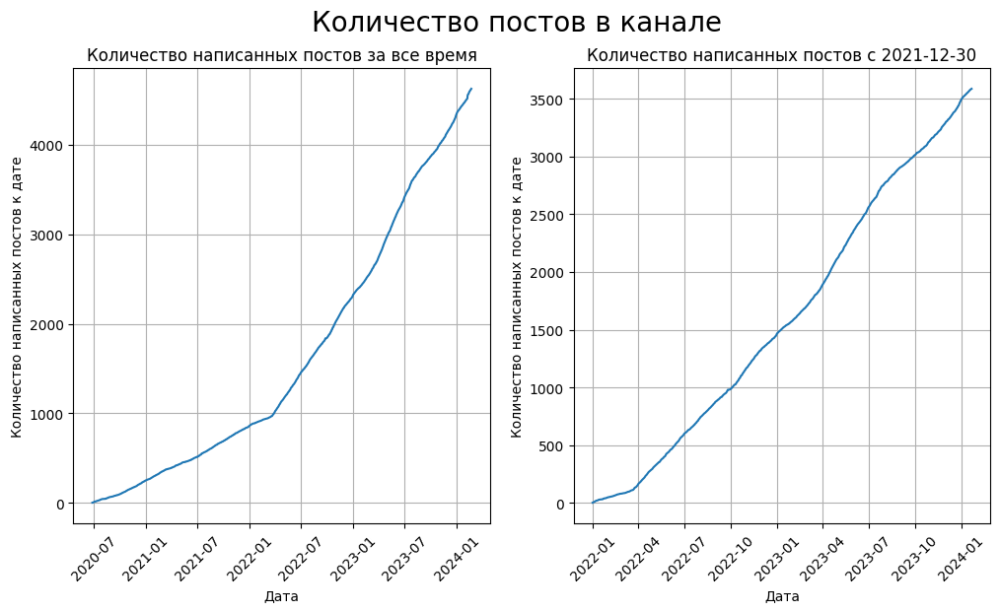

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(12,6))

fig.suptitle('Количество постов в канале', fontsize=20)

ax[0].plot(wink_posts_dimanic['post_date'], wink_posts_dimanic['posts_cum'])
ax[0].set_title('Количество написанных постов за все время')
ax[0].set(xlabel='Дата', ylabel='Количество написанных постов к дате')
ax[0].tick_params(axis='x', labelrotation=45)
ax[0].grid(True)


ax[1].plot(filter_wink_posts_dimanic['post_date'], filter_wink_posts_dimanic['posts_cum'])
ax[1].set_title(f'Количество написанных постов c {analyzes_date}')
ax[1].set(xlabel='Дата', ylabel='Количество написанных постов к дате')
ax[1].tick_params(axis='x', labelrotation=45)
ax[1].grid(True)
fig.show();

Посты в канале пишутся довольно равномерно, за анализируемый период было написано около 3600 постов.

#### ER по времени

Посмотрим медианный ER по дням

In [ ]:
wink_er_day = wink_filtered.groupby('post_date', as_index=False).agg({'er':'median'}).sort_values(by='post_date')

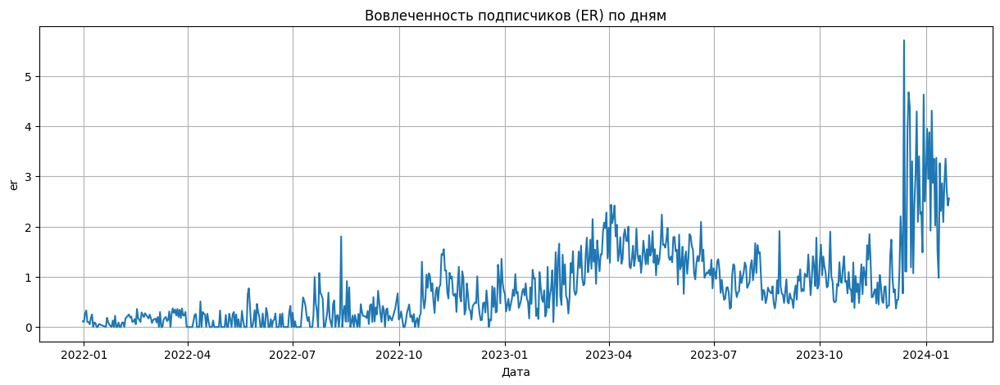

In [ ]:
plt.figure(figsize=(15, 5))
plt.title('Вовлеченность подписчиков (ER) по дням')

plt.plot(wink_er_day['post_date'], wink_er_day['er'])
plt.xlabel('Дата')
plt.ylabel('er')
plt.grid(True)
plt.show();

Посмотрим медианный ER по месяцам.

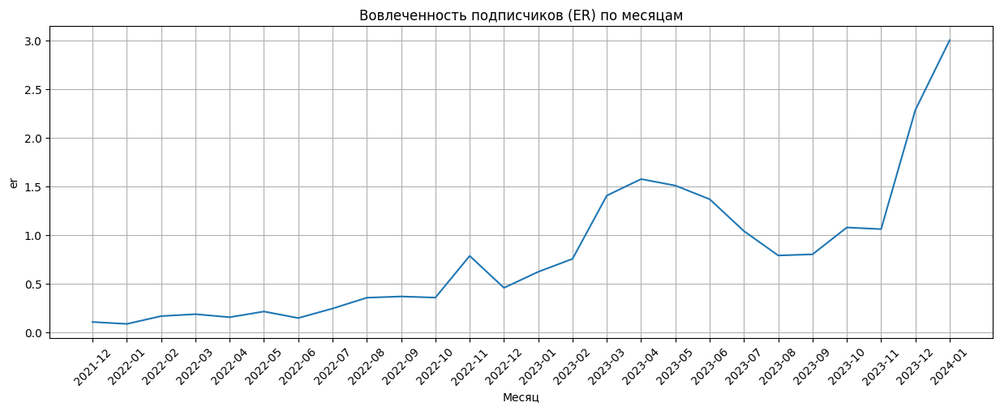

In [ ]:
wink_er_day['month'] = pd.to_datetime(wink_er_day['post_date'], format='%Y-%m-%d').dt.to_period("M")
wink_er_month = wink_er_day.groupby('month', as_index=False).agg({'er':'median'}).sort_values(by='month')
wink_er_month['month'] = wink_er_month['month'].astype('str')
plt.figure(figsize=(15, 5))
plt.title('Вовлеченность подписчиков (ER) по месяцам')
plt.plot(wink_er_month['month'], wink_er_month['er'])
plt.xlabel('Месяц')
plt.tick_params(axis='x', labelrotation=45)
plt.ylabel('er')
plt.grid(True)
plt.show();

Мы видим, что был небольшой пик в ноябре 2022, после чего падение, затем плавный рост до апреля 2023, и снова падение плавное, и резкий рост с ноября 2023.

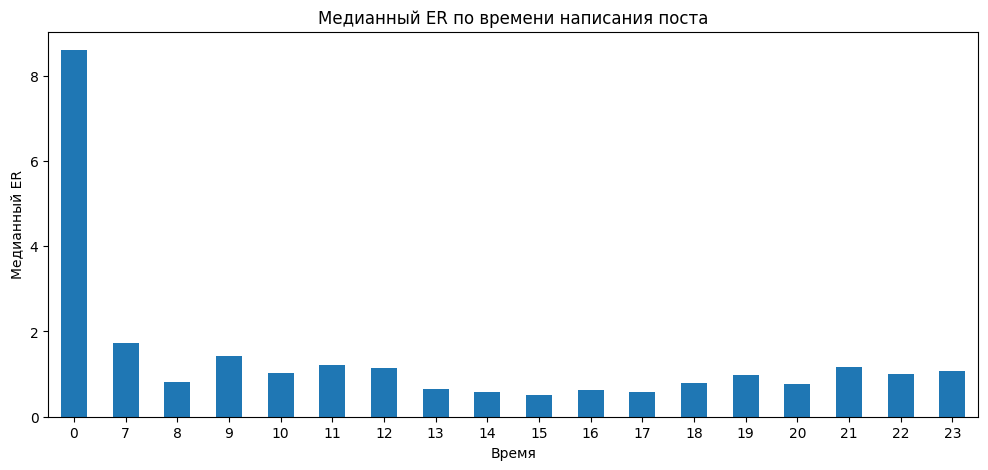

In [ ]:
wink_filtered['post_hour'] = wink_filtered['date_time'].dt.hour
wink_filtered.groupby(by='post_hour')['er'].median().plot(kind='bar',
       figsize=(12,5),
       title='Медианный ER по времени написания поста',
       xlabel='Время',
       ylabel='Медианный ER',
       rot=0
      );

Мы видим, что медианный ER выше у постов в польночь, но это может быть связано с тем, что ночью пишут мало постов, проверим.

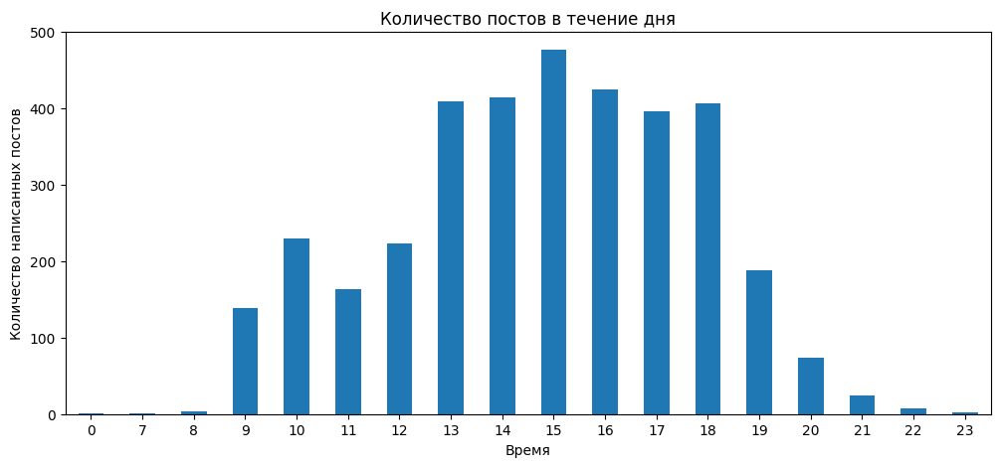

In [ ]:
wink_filtered.groupby(by='post_hour')['er'].count().plot(kind='bar',
       figsize=(12,5),
       title='Количество постов в течение дня',
       xlabel='Время',
       ylabel='Количество написанных постов',
       rot=0
      );

Да, действительно, в канале почти нет постов с 10 вечера до 9 утра.

Посмотрим на медианный ER по дням недели.

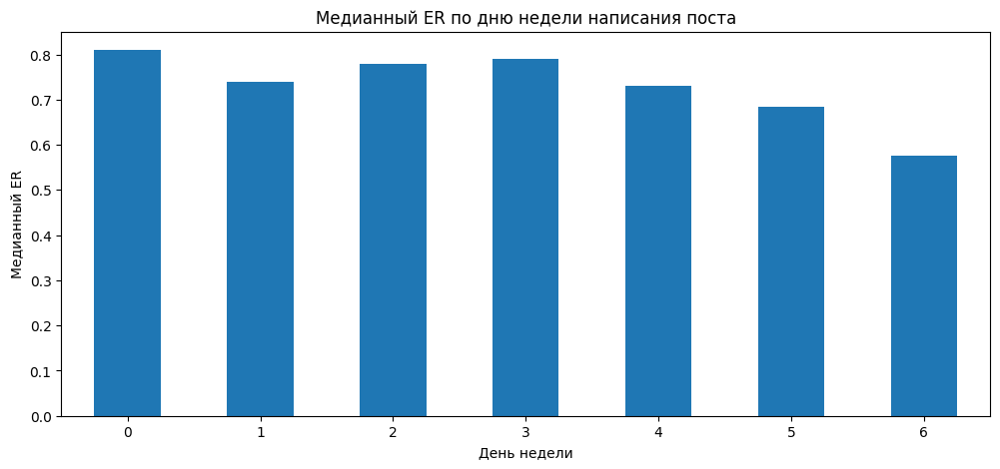

In [ ]:
wink_filtered['post_weekday'] = wink_filtered['date_time'].dt.dayofweek
wink_filtered.groupby(by='post_weekday')['er'].median().plot(kind='bar',
       figsize=(12,5),
       title='Медианный ER по дню недели написания поста',
       xlabel='День недели',
       ylabel='Медианный ER',
       rot=0
      );

Можно сказать, что ER почти равен по дням недели, есть падение сильное только в воскресенье,  а больше всего в понедельник.

#### Анализ текста постов

Посчитаем количество символов и знаков препинания в текстах постов.

In [ ]:
clean_data(wink_filtered)
wink_filtered['clear_symbols'] = wink_filtered['clean_text'].apply(lambda x: len(x))
wink_filtered['clear_punctuation'] = wink_filtered['clean_text'].apply(lambda x: sum(map(x.count, [',',
                                                                                                    '.',
                                                                                                    '—',
                                                                                                    ':',
                                                                                                    ';',
                                                                                                    '-',
                                                                                                    '!',
                                                                                                    '?'])))

Разобьем посты по количеству символов.  

,post_cat,id
0,длинный пост,139
1,короткий пост,2567
2,обычный пост,748
3,очень короткий пост,133


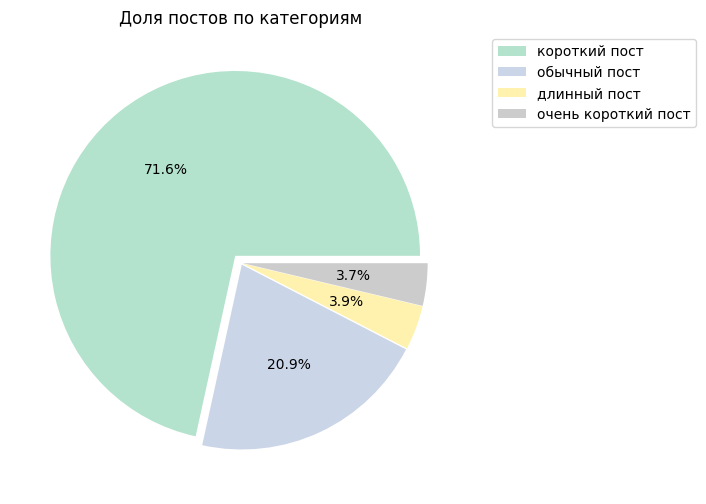

In [ ]:
wink_filtered['post_cat'] = wink_filtered['clear_symbols'].apply(post_volume)
display(wink_filtered.groupby(by='post_cat', as_index=False)['id'].count())

wink_filtered['post_cat'].value_counts().plot(kind="pie",
          autopct='%1.1f%%',
          explode=[0.05, 0.01, 0.01, 0.01],
          legend=True,
          title='Доля постов по категориям',
          ylabel='',
          labeldistance=None,
          figsize=(6, 6),
          cmap='Pastel2').legend(bbox_to_anchor=(1.5, 1));

Мы видим, что 71,6% постов были короткими, на втором месте посты обычной длины (до 1000 символов) - 20,9%, 3,9% - длинные посты, 3,7% - очень короткие посты.

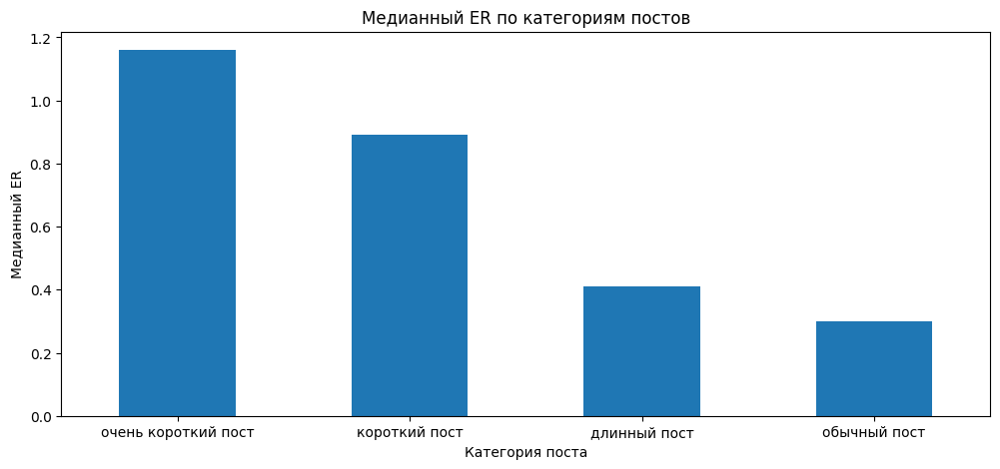

In [ ]:
wink_filtered.groupby(by='post_cat')['er'].median().sort_values(ascending=False).plot(kind='bar',
       figsize=(12,5),
       title='Медианный ER по категориям постов',
       xlabel='Категория поста',
       ylabel='Медианный ER',
       rot=0
      );

У очень коротких постов выше медианный охват, это логично, так выкладывают трейлеры, постеры, кадры из фильмов, срочные новости. Разница с кинопоиском в том, что медианный ахват в этом канале выше у длинных постов, чем у постов с обычной длиной.

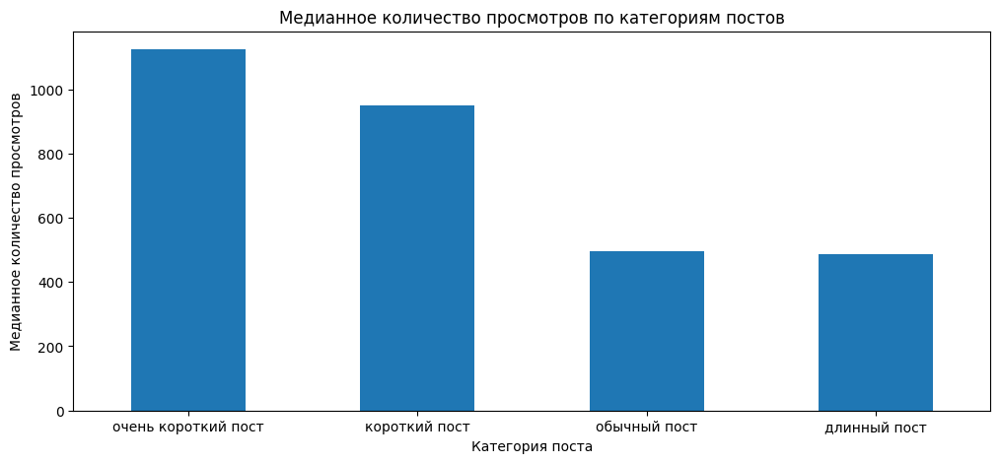

In [ ]:
wink_filtered.groupby(by='post_cat')['views'].median().sort_values(ascending=False).plot(kind='bar',
       figsize=(12,5),
       title='Медианное количество просмотров по категориям постов',
       xlabel='Категория поста',
       ylabel='Медианное количество просмотров',
       rot=0
      );

Также просмотров больше всего у очень коротких постов, а у длинных постов меньше всего.

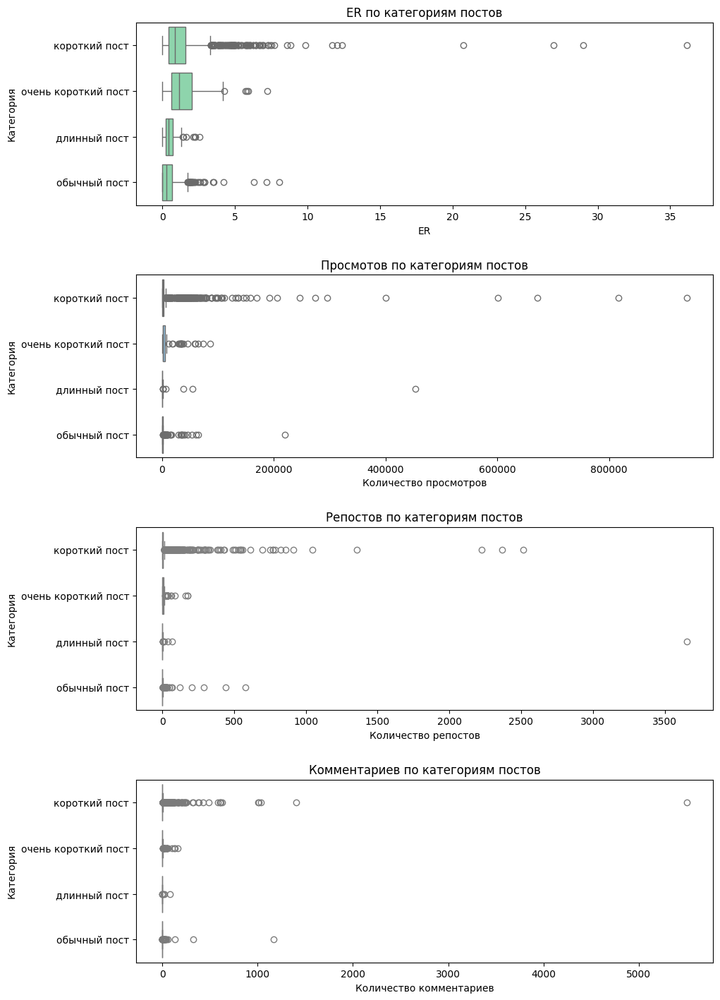

In [ ]:
fig, axes = plt.subplots(nrows=4, figsize = (10, 15))
fig.tight_layout(pad=5.0)

# ER
ax1 = sns.boxplot(x='er', y='post_cat', data=wink_filtered, color='#82E0AA', ax=axes[0])
ax1.set(title = 'ER по категориям постов', ylabel = 'Категория', xlabel = 'ER')

# Просмотры
ax2 = sns.boxplot(x='views', y='post_cat', data=wink_filtered, color='#85C1E9', ax=axes[1])
ax2.set(title = 'Просмотов по категориям постов', ylabel = 'Категория', xlabel = 'Количество просмотров')

# Репосты
ax3 = sns.boxplot(x='forwarded', y='post_cat', data=wink_filtered, color='#F5B7B1', ax=axes[2])
ax3.set(title = 'Репостов по категориям постов', ylabel = 'Категория', xlabel = 'Количество репостов')

# Комментарии
ax4 = sns.boxplot(x='comments', y='post_cat', data=wink_filtered, color='#FAD7A0', ax=axes[3])
ax4.set(title = 'Комментариев по категориям постов', ylabel = 'Категория', xlabel = 'Количество комментариев')

plt.show()

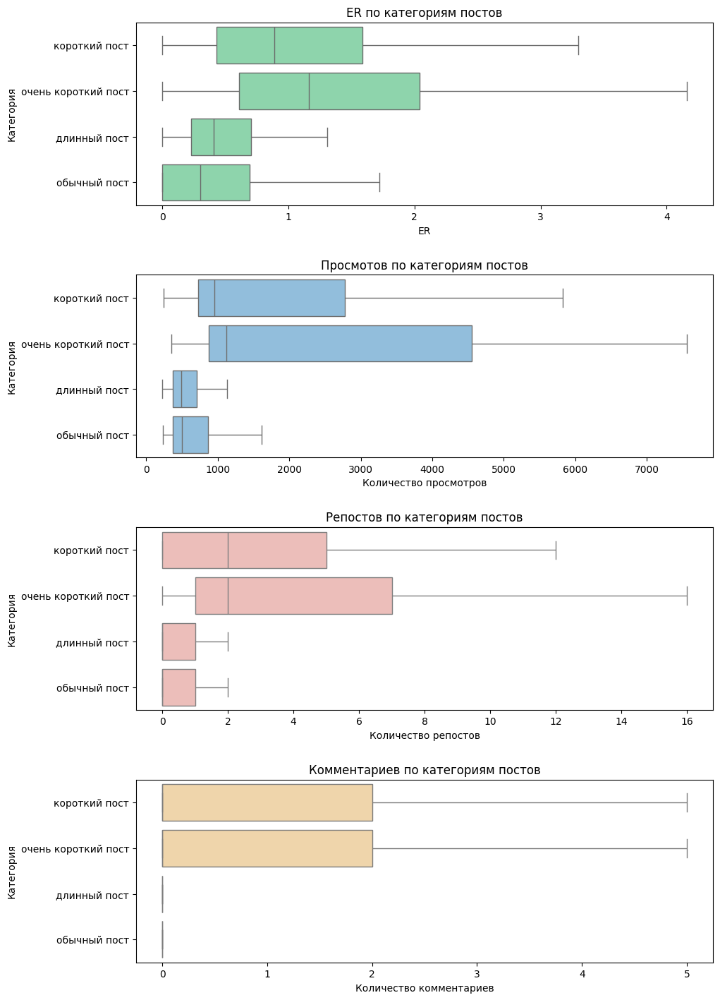

In [ ]:
fig, axes = plt.subplots(nrows=4, figsize = (10, 15))
fig.tight_layout(pad=5.0)

# ER
ax1 = sns.boxplot(x='er', y='post_cat', data=wink_filtered, color='#82E0AA', ax=axes[0], showfliers=False)
ax1.set(title = 'ER по категориям постов', ylabel = 'Категория', xlabel = 'ER')

# Просмотры
ax2 = sns.boxplot(x='views', y='post_cat', data=wink_filtered, color='#85C1E9', ax=axes[1], showfliers=False)
ax2.set(title = 'Просмотов по категориям постов', ylabel = 'Категория', xlabel = 'Количество просмотров')

# Репосты
ax3 = sns.boxplot(x='forwarded', y='post_cat', data=wink_filtered, color='#F5B7B1', ax=axes[2], showfliers=False)
ax3.set(title = 'Репостов по категориям постов', ylabel = 'Категория', xlabel = 'Количество репостов')

# Комментарии
ax4 = sns.boxplot(x='comments', y='post_cat', data=wink_filtered, color='#FAD7A0', ax=axes[3], showfliers=False)
ax4.set(title = 'Комментариев по категориям постов', ylabel = 'Категория', xlabel = 'Количество комментариев')

plt.show()

Пользователям интереснее всего короткие и очень короткие посты, они с ними больше всего взаимодейстуют.

In [ ]:
min_er_text_wink = ' '.join(wink_filtered.query('er <= @wink_filtered.er.median()')['clean_text'])
max_er_text_wink = ' '.join(wink_filtered.query('er > @wink_filtered.er.median()')['clean_text'])

In [ ]:
wink_er_min_noun_tokens, wink_er_min_adjf_tokens, wink_er_min_verb_tokens = get_word_tokens(min_er_text_wink)


In [ ]:
wink_er_max_noun_tokens, wink_er_max_adjf_tokens, wink_er_max_verb_tokens = get_word_tokens(max_er_text_wink)

##### Существительные

**ER меньше или равен медианному значению**

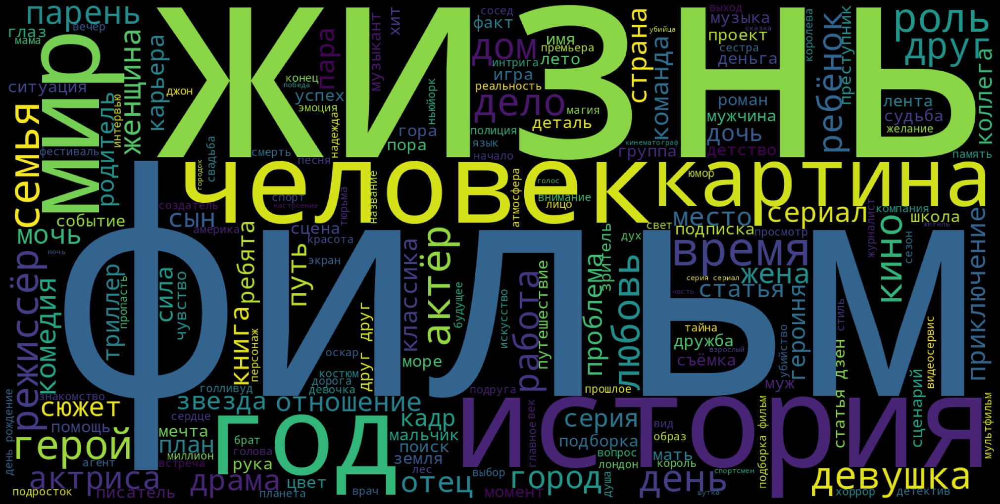

In [ ]:
words_cloud(wink_er_min_noun_tokens)


**ER больше медианного значения**

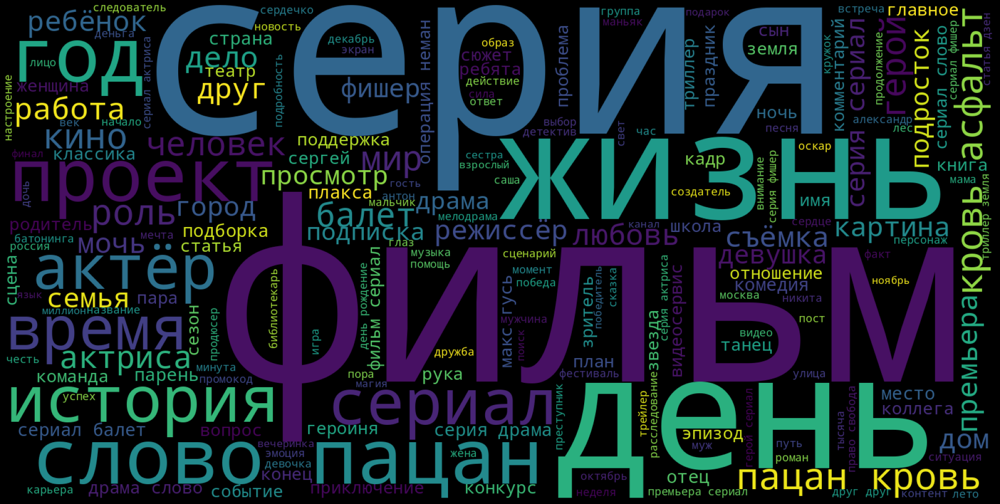

In [ ]:
words_cloud(wink_er_max_noun_tokens)


Выглядит так, что пользователям этого канала больше нравятся посты о сериалах, особенно о слове пацана.

##### Прилагательные

**ER меньше или равен медианному значению**

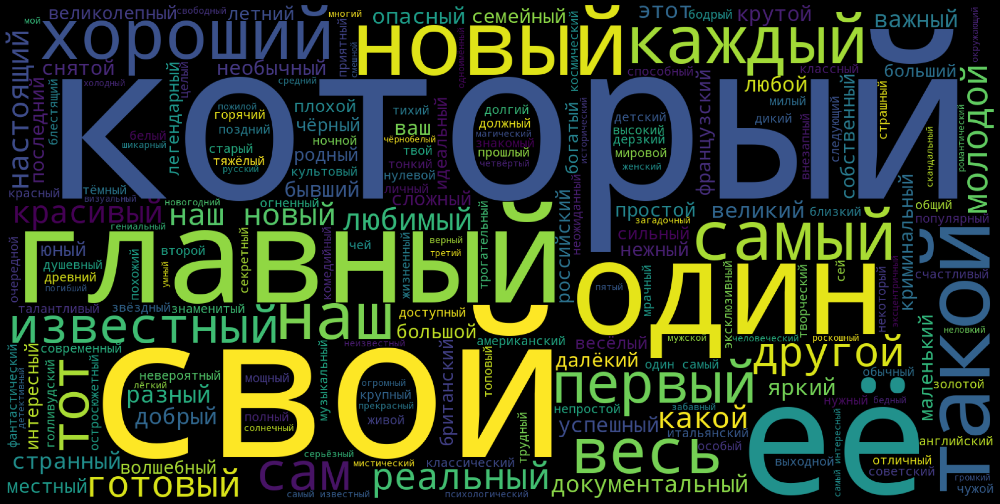

In [ ]:
words_cloud(wink_er_min_adjf_tokens)

**ER больше медианного значения**

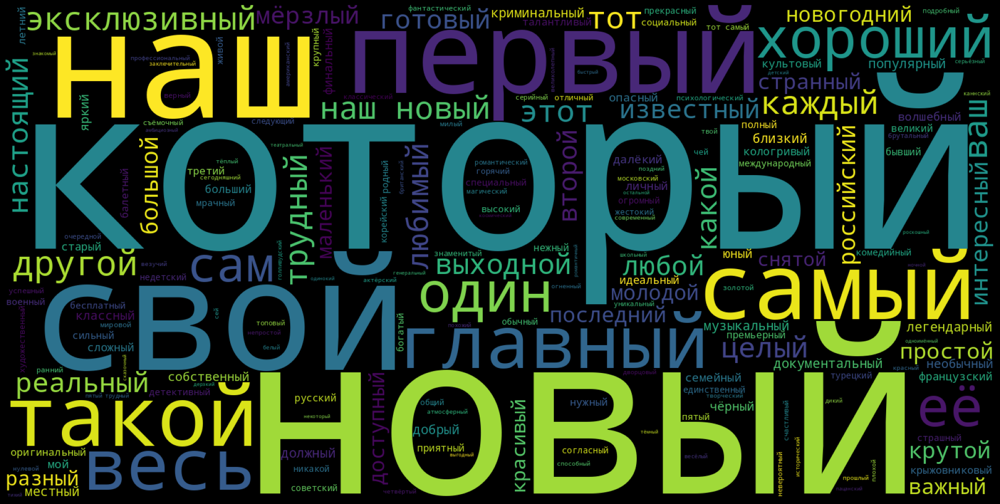

In [ ]:
words_cloud(wink_er_max_adjf_tokens)

В прилагательных нет разницы.

##### Глаголы

**ER меньше или равен медианному значению**

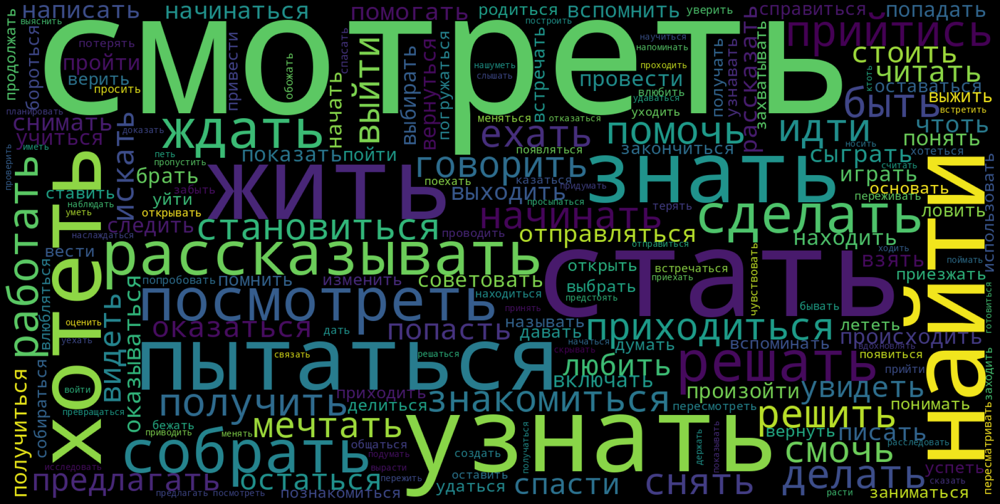

In [ ]:
words_cloud(wink_er_min_verb_tokens)

**ER больше медианного значения**

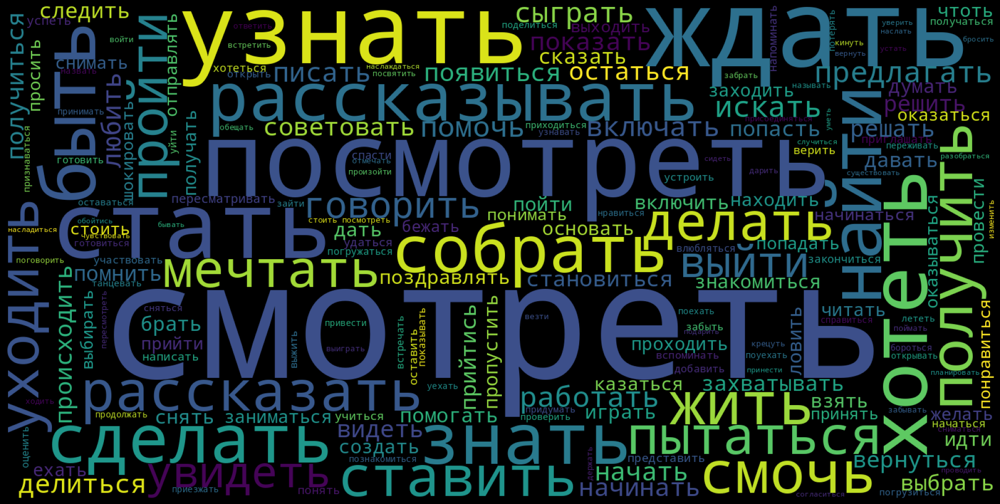

In [ ]:
words_cloud(wink_er_max_verb_tokens)

В глаголах тоже, можно сказать, нет разницы.

#### Тип вложения в постах

Посмотрим, как влияет тип вложения на ER.

Заполним пропуски в типе вложения "without_attachment", т.е. без вложения.

In [ ]:
wink_filtered['type_attachment'] = wink_filtered['type_attachment'].fillna('without_attachment')

Посчитаем количество постов по типу вложения и их медианный ER.

In [ ]:
wink_attach = wink_filtered.groupby(by='type_attachment').agg({'id':'count', 'er':'median'})
display(wink_attach)

,id,er
type_attachment,,
MessageMediaDocument,741,1.210
MessageMediaPhoto,2090,0.640
MessageMediaWebPage,418,0.635
without_attachment,338,0.345


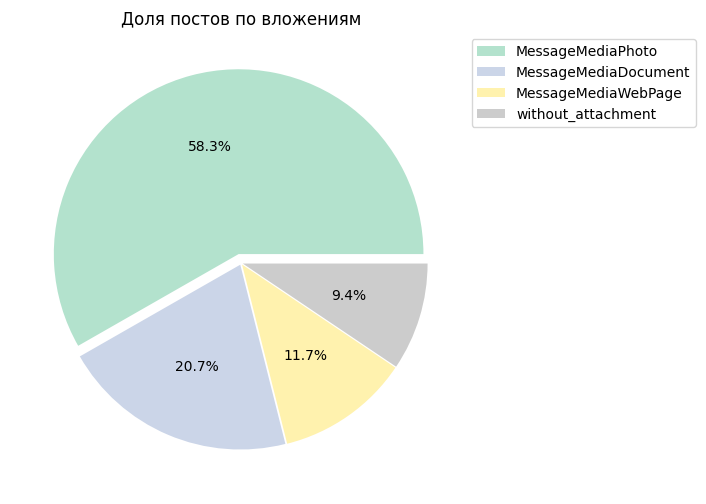

In [ ]:

wink_attach['id'].sort_values(ascending=False).plot(kind="pie",
          autopct='%1.1f%%',
          explode=[0.05, 0.01, 0.01, 0.01],
          legend=True,
          title='Доля постов по вложениям',
          ylabel='',
          labeldistance=None,
          figsize=(6, 6),
          cmap='Pastel2').legend(bbox_to_anchor=(1.5, 1));

Более половины (58,3%) постов в канале с картинками, 20,7% с документом, меньше всего (9,4%) постов без вложения.

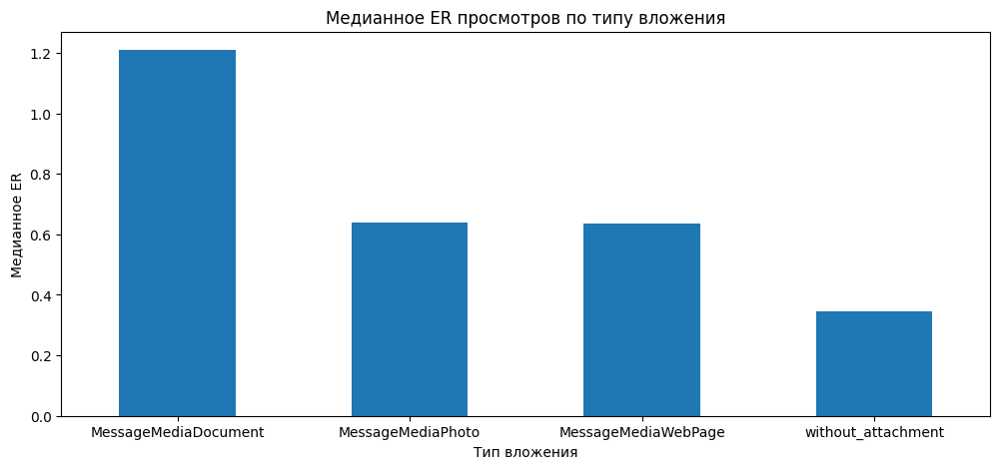

In [ ]:
wink_attach['er'].sort_values(ascending=False).plot(kind='bar',
       figsize=(12,5),
       title='Медианное ER просмотров по типу вложения',
       xlabel='Тип вложения',
       ylabel='Медианное ER',
       rot=0
      );

При этом наибольший медианный ER у постов с документами (почти в 2 раза, по сравнению с изображениями и ссылками), наименьший медианный ER у постов без вложения.

**Вывод**  
- В нашем расположении датафрейм с 8 колонками и 9913 строками.
- Посты в канале пишутся довольно равномерно, за анализируемый период было написано около 3600 постов.
- Был небольшой пик  ER в ноябре 2022, после чего падение, затем плавный рост до апреля 2023, и снова падение плавное, и резкий рост с ноября 2023.
- В канале почти нет постов с 10 вечера до 9 утра.
- Можно сказать, что ER почти равен по дням недели, есть падение сильное только в воскресенье, а больше всего в понедельник.
- 71,6% постов были короткими, на втором месте посты обычной длины (до 1000 символов) - 20,9%, 3,9% - длинные посты, 3,7% - очень короткие посты.
- У очень коротких постов выше медианный охват, это логично, так выкладывают трейлеры, постеры, кадры из фильмов, срочные новости. Разница с кинопоиском в том, что медианный ахват в этом канале выше у длинных постов, чем у постов с обычной длиной.
- Просмотров больше всего у очень коротких постов, а у длинных постов меньше всего.
- Пользователям интереснее всего короткие и очень короткие посты, они с ними больше всего взаимодейстуют.
- Выглядит так, что пользователям этого канала больше нравятся посты о сериалах, особенно о слове пацана.
- Более половины (58,3%) постов в канале с картинками, 20,7% с документом, меньше всего (9,4%) постов без вложения.
- При этом наибольший медианный ER у постов с документами (почти в 2 раза, по сравнению с изображениями и ссылками), наименьший медианный ER у постов без вложения.

### kinoreel

Также посмотрим на непрямого конкурента в бизнессе, но тоже крупный канал про кино в телеграме.

In [ ]:
# подготавливаем ссылки для скачивания файлов с Яндекс.Диска.
# публичная ссылка на датасеты на яндекс диске
folder_url = 'https://disk.yandex.ru/d/nflbLG3sCHE-sg'
# названия файлов
file_url = ['kinoreel_posts_2024-02-21.csv']

# загружаем  файл в свой датафрейм
url = ('https://cloud-api.yandex.net/v1/disk/public/resources/download'
        + '?public_key='
        + urllib.parse.quote(folder_url)
        + '&path=/'
        + urllib.parse.quote(file_url[0]))
  # запрос ссылки на скачивание
r = requests.get(url)
   # 'парсинг' ссылки на скачивание
h = json.loads(r.text)['href']


kinoreel = pd.read_csv(h, index_col=[0])


In [ ]:
kinoreel = kinoreel.drop(columns=['channel', 'with_media', 'replies'])

In [ ]:
print(kinoreel.info())
display(kinoreel.sample(2))

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2177 entries, 0 to 3925
Data columns (total 9 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   id               2177 non-null   int64  
 1   date             2177 non-null   object 
 2   text             2177 non-null   object 
 3   views            2177 non-null   float64
 4   reactions        2147 non-null   object 
 5   forwarded        2177 non-null   float64
 6   reactions_count  2177 non-null   int64  
 7   comments         2177 non-null   int64  
 8   type_attachment  2159 non-null   object 
dtypes: float64(2), int64(3), object(4)
memory usage: 170.1+ KB
None


,id,date,text,views,reactions,forwarded,reactions_count,comments,type_attachment
3924,3,2022-04-05 07:05:16+00:00,"По сводкам портала Deadline, актриса Сидни Суидни, известная по роли Кесси в нашумевшем подростковом сериале “Эйфория”, присоединилась к касту экранизации комикса Marvel «Мадам Паутина». Главную роль, как уже известно, сыграет звезда «50 оттенков серого» Дакота Джонсон, роль Суини пока неизвестна. \n\nМадам Паутина, она же Кассандра Уэбб, обладает экстрасенсорными способностями и даром ясновидения, которые позволили ей стать медиумом. Именно Мадам Паутина раскрыла личность Питера Паркера в комиксах, но при таком большом вкладе героиня всё равно оставалась второстепенной. \n\nКак будет выглядеть сольный проект и каких ещё героев увидим на экране – узнаем позднее.",81706.0,"{'_': 'MessageReactions', 'results': [{'_': 'ReactionCount', 'reaction': {'_': 'ReactionEmoji', 'emoticon': '👍'}, 'count': 125, 'chosen_order': None}, {'_': 'ReactionCount', 'reaction': {'_': 'ReactionEmoji', 'emoticon': '❤'}, 'count': 18, 'chosen_order': None}, {'_': 'ReactionCount', 'reaction': {'_': 'ReactionEmoji', 'emoticon': '👎'}, 'count': 7, 'chosen_order': None}, {'_': 'ReactionCount', 'reaction': {'_': 'ReactionEmoji', 'emoticon': '🤔'}, 'count': 7, 'chosen_order': None}, {'_': 'ReactionCount', 'reaction': {'_': 'ReactionEmoji', 'emoticon': '🦄'}, 'count': 7, 'chosen_order': None}, {'_': 'ReactionCount', 'reaction': {'_': 'ReactionEmoji', 'emoticon': '😭'}, 'count': 3, 'chosen_order': None}, {'_': 'ReactionCount', 'reaction': {'_': 'ReactionEmoji', 'emoticon': '🙏'}, 'count': 2, 'chosen_order': None}, {'_': 'ReactionCount', 'reaction': {'_': 'ReactionEmoji', 'emoticon': '👾'}, 'count': 1, 'chosen_order': None}], 'min': False, 'can_see_list': False, 'reactions_as_tags': False, 'recent_reactions': []}",16.0,170,10,MessageMediaPhoto
1192,2828,2023-08-24 05:02:09+00:00,"Доброе утро, жители KinoReel! \nПоделитесь в комментариях любимыми киномемами, давайте поднимем друг другу настроение :)",14268.0,"{'_': 'MessageReactions', 'results': [{'_': 'ReactionCount', 'reaction': {'_': 'ReactionEmoji', 'emoticon': '👍'}, 'count': 52, 'chosen_order': None}, {'_': 'ReactionCount', 'reaction': {'_': 'ReactionEmoji', 'emoticon': '😁'}, 'count': 37, 'chosen_order': None}, {'_': 'ReactionCount', 'reaction': {'_': 'ReactionEmoji', 'emoticon': '❤'}, 'count': 10, 'chosen_order': None}, {'_': 'ReactionCount', 'reaction': {'_': 'ReactionEmoji', 'emoticon': '👌'}, 'count': 4, 'chosen_order': None}], 'min': False, 'can_see_list': False, 'reactions_as_tags': False, 'recent_reactions': []}",24.0,103,13,MessageMediaPhoto


In [ ]:
kinoreel['date_time']= pd.to_datetime(kinoreel['date'], format="%Y-%m-%d %H:%M:%S%z", utc=True).dt.tz_convert('Europe/Moscow')
kinoreel['post_date'] = pd.to_datetime(kinoreel['date_time']).dt.date

kinoreel_filtered = kinoreel.query('@analyzes_date < post_date <=   @channel_posts.post_date.max()')
kinoreel_filtered['er'] = ((kinoreel_filtered['reactions_count']
                                          + kinoreel_filtered['comments']
                                          + kinoreel_filtered['forwarded'])
                                          * 100
                                          /kinoreel_filtered['views'] ).round(2)

#### Количество написанных постов в канале

In [ ]:
# посчитаем сколько в каждую дату было написано постов
kinoreel_posts_dimanic = kinoreel.groupby(by='post_date').agg({'id':'count'}).reset_index().sort_values(by='post_date')
# посчитаем кумулятивную сумму, т.е. с накоплением

kinoreel_posts_dimanic['posts_cum'] = kinoreel_posts_dimanic['id'].cumsum()

# посчитаем сколько в каждую дату было написано постов с 30 декаря 2021 года
filter_kinoreel_posts_dimanic = (kinoreel_filtered
  .groupby(by='post_date')
  .agg({'id':'count'})
  .reset_index()
  .sort_values(by='post_date')
  .rename(columns={'id':'posts_per_day'}))

# посчитаем кумулятивную сумму, т.е. с накоплением
filter_kinoreel_posts_dimanic['posts_cum'] = filter_kinoreel_posts_dimanic['posts_per_day'].cumsum()

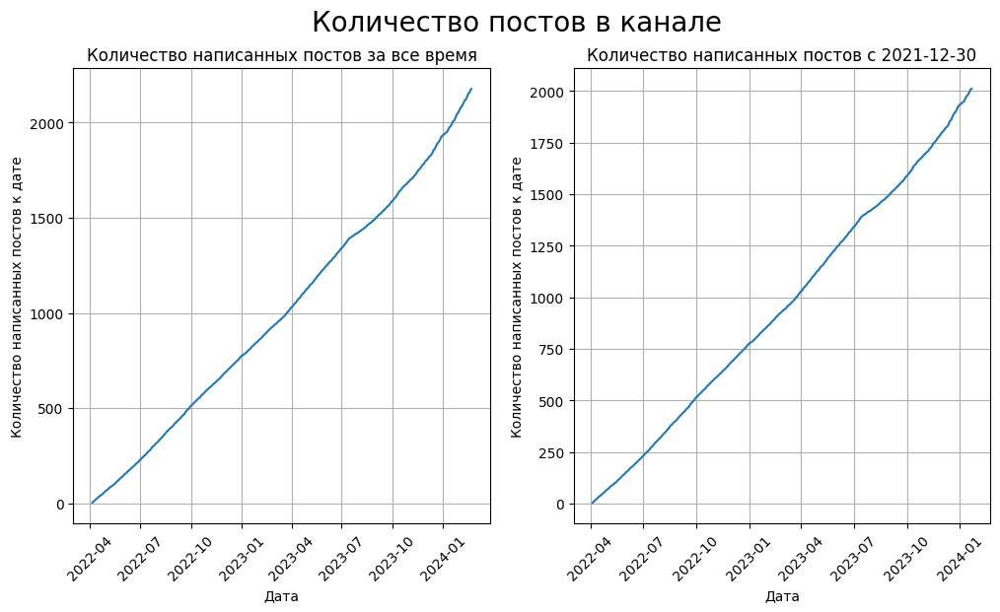

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(12,6))

fig.suptitle('Количество постов в канале', fontsize=20)

ax[0].plot(kinoreel_posts_dimanic['post_date'], kinoreel_posts_dimanic['posts_cum'])
ax[0].set_title('Количество написанных постов за все время')
ax[0].set(xlabel='Дата', ylabel='Количество написанных постов к дате')
ax[0].tick_params(axis='x', labelrotation=45)
ax[0].grid(True)


ax[1].plot(filter_kinoreel_posts_dimanic['post_date'], filter_kinoreel_posts_dimanic['posts_cum'])
ax[1].set_title(f'Количество написанных постов c {analyzes_date}')
ax[1].set(xlabel='Дата', ylabel='Количество написанных постов к дате')
ax[1].tick_params(axis='x', labelrotation=45)
ax[1].grid(True)
fig.show();

In [ ]:
kinoreel_er_day = kinoreel_filtered.groupby('post_date', as_index=False).agg({'er':'mean'}).sort_values(by='post_date')

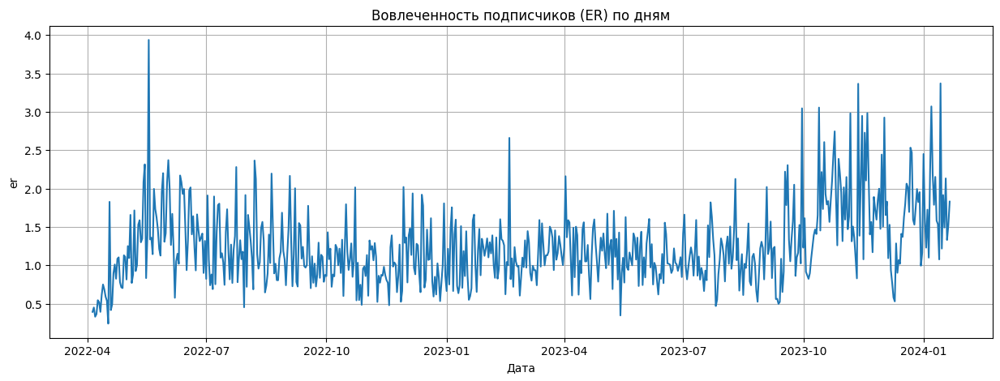

In [ ]:
plt.figure(figsize=(15, 5))
plt.title('Вовлеченность подписчиков (ER) по дням')

plt.plot(kinoreel_er_day['post_date'], kinoreel_er_day['er'])
plt.xlabel('Дата')
plt.ylabel('er')
plt.grid(True)
plt.show();

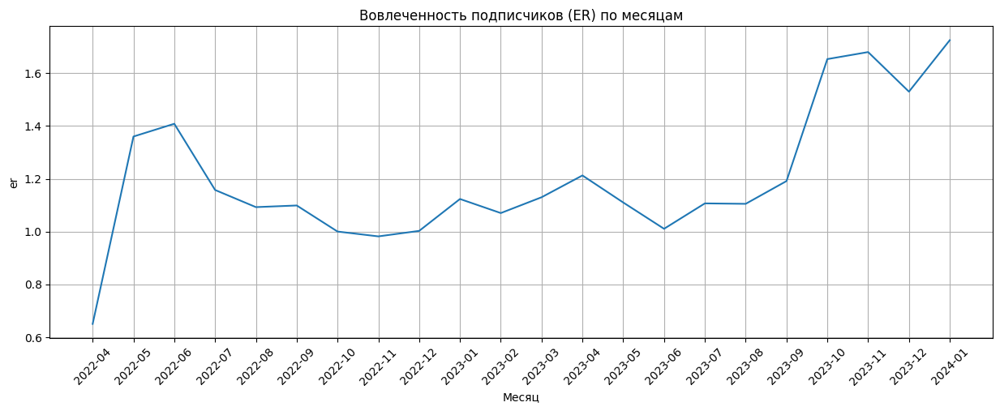

In [ ]:
kinoreel_er_day['month'] = pd.to_datetime(kinoreel_er_day['post_date'], format='%Y-%m-%d').dt.to_period("M")
kinoreel_er_month = kinoreel_er_day.groupby('month', as_index=False).agg({'er':'median'}).sort_values(by='month')
kinoreel_er_month['month'] = kinoreel_er_month['month'].astype('str')
plt.figure(figsize=(15, 5))
plt.title('Вовлеченность подписчиков (ER) по месяцам')
plt.plot(kinoreel_er_month['month'], kinoreel_er_month['er'])
plt.xlabel('Месяц')
plt.tick_params(axis='x', labelrotation=45)
plt.ylabel('er')
plt.grid(True)
plt.show();

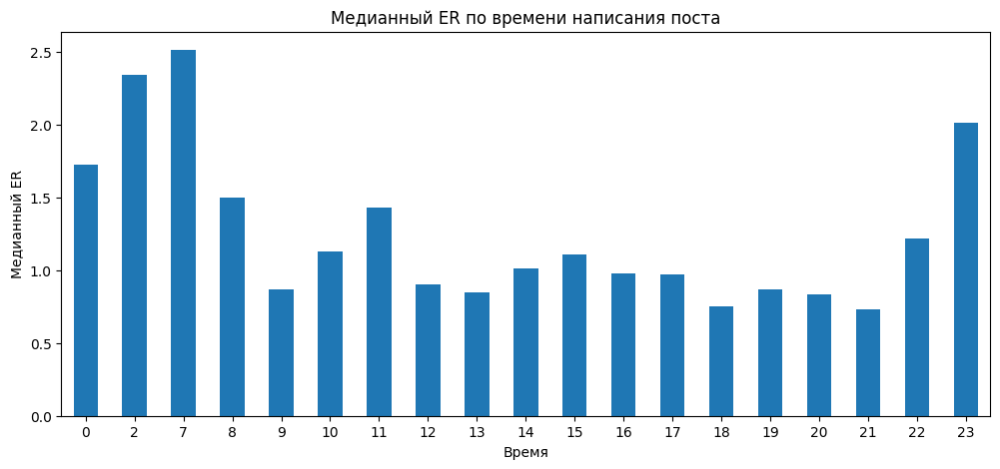

In [ ]:
kinoreel_filtered['post_hour'] = kinoreel_filtered['date_time'].dt.hour
kinoreel_filtered.groupby(by='post_hour')['er'].median().plot(kind='bar',
       figsize=(12,5),
       title='Медианный ER по времени написания поста',
       xlabel='Время',
       ylabel='Медианный ER',
       rot=0
      );

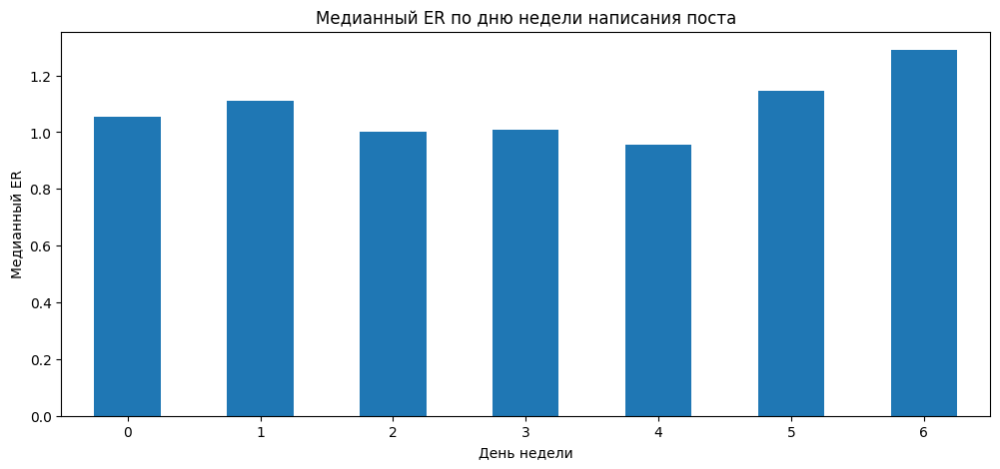

In [ ]:
kinoreel_filtered['post_weekday'] = kinoreel_filtered['date_time'].dt.dayofweek
kinoreel_filtered.groupby(by='post_weekday')['er'].median().plot(kind='bar',
       figsize=(12,5),
       title='Медианный ER по дню недели написания поста',
       xlabel='День недели',
       ylabel='Медианный ER',
       rot=0
      );

In [ ]:
clean_data(kinoreel_filtered)
kinoreel_filtered['clear_symbols'] = kinoreel_filtered['clean_text'].apply(lambda x: len(x))
kinoreel_filtered['clear_punctuation'] = kinoreel_filtered['clean_text'].apply(lambda x: sum(map(x.count, [',',
                                                                                                    '.',
                                                                                                    '—',
                                                                                                    ':',
                                                                                                    ';',
                                                                                                    '-',
                                                                                                    '!',
                                                                                                    '?'])))

,post_cat,id
0,длинный пост,222
1,короткий пост,959
2,обычный пост,663
3,очень короткий пост,167


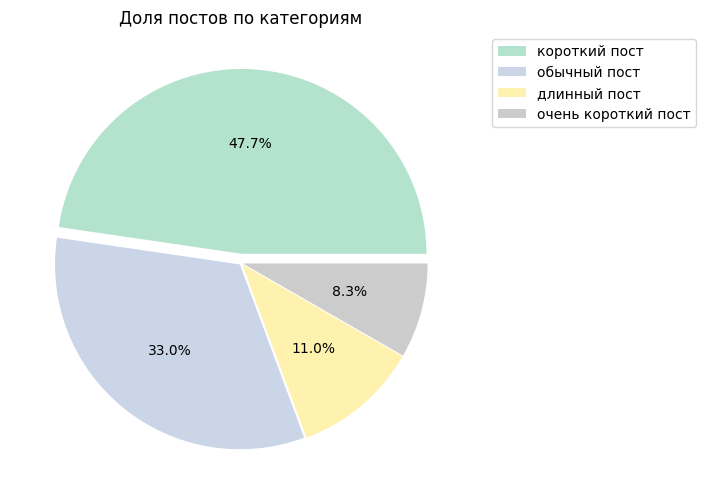

In [ ]:
kinoreel_filtered['post_cat'] = kinoreel_filtered['clear_symbols'].apply(post_volume)
display(kinoreel_filtered.groupby(by='post_cat', as_index=False)['id'].count())

kinoreel_filtered['post_cat'].value_counts().plot(kind="pie",
          autopct='%1.1f%%',
          explode=[0.05, 0.01, 0.01, 0.01],
          legend=True,
          title='Доля постов по категориям',
          ylabel='',
          labeldistance=None,
          figsize=(6, 6),
          cmap='Pastel2').legend(bbox_to_anchor=(1.5, 1));

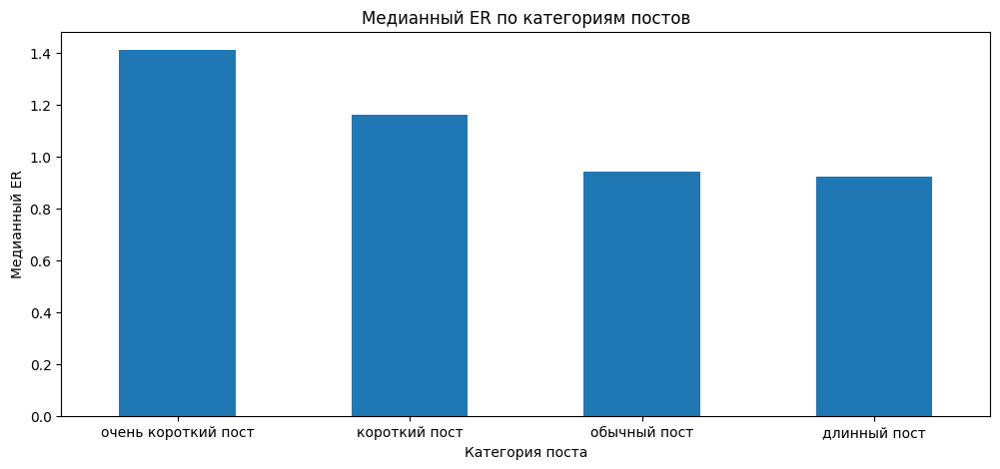

In [ ]:
kinoreel_filtered.groupby(by='post_cat')['er'].median().sort_values(ascending=False).plot(kind='bar',
       figsize=(12,5),
       title='Медианный ER по категориям постов',
       xlabel='Категория поста',
       ylabel='Медианный ER',
       rot=0
      );

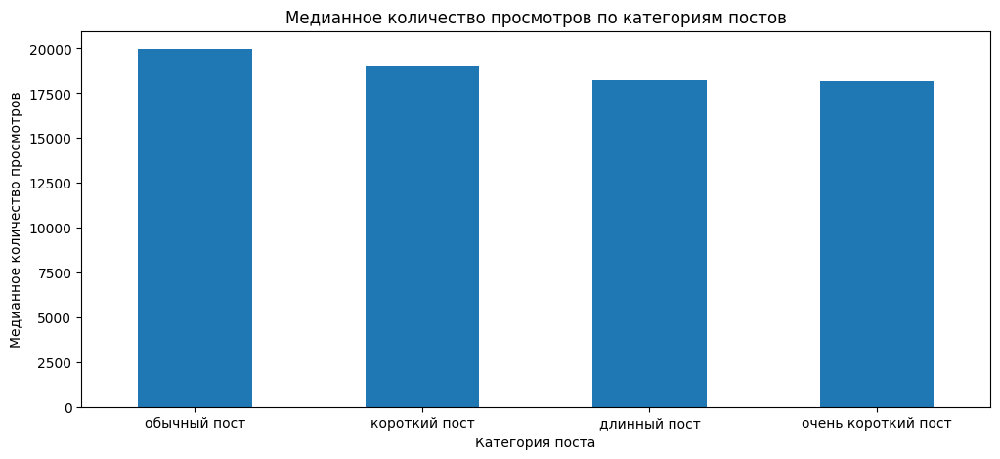

In [ ]:
kinoreel_filtered.groupby(by='post_cat')['views'].median().sort_values(ascending=False).plot(kind='bar',
       figsize=(12,5),
       title='Медианное количество просмотров по категориям постов',
       xlabel='Категория поста',
       ylabel='Медианное количество просмотров',
       rot=0
      );

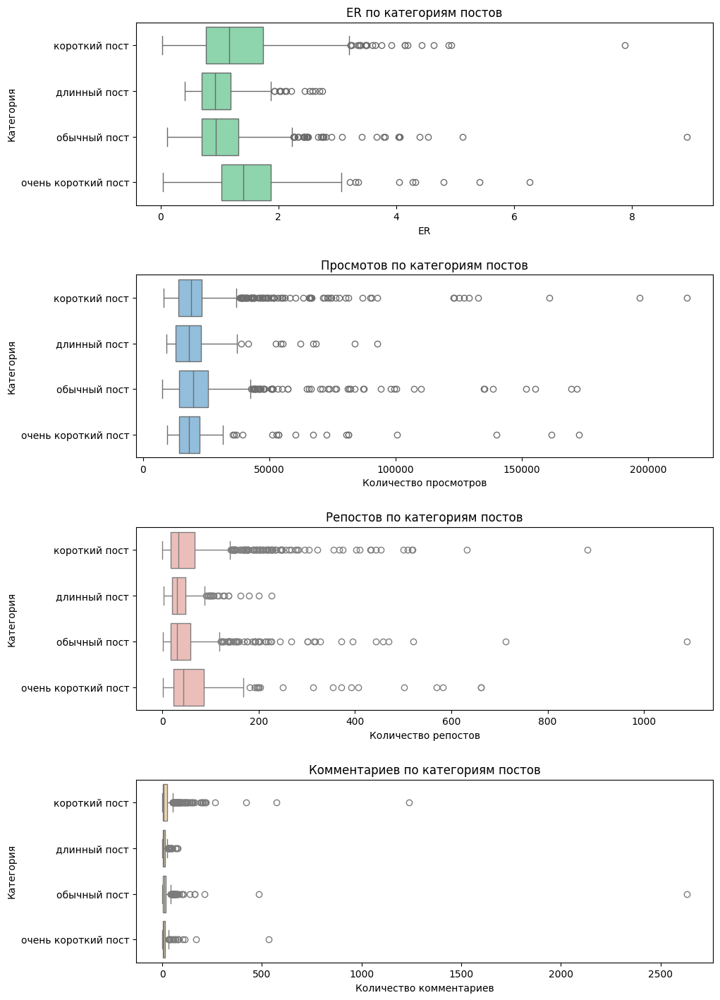

In [ ]:
fig, axes = plt.subplots(nrows=4, figsize = (10, 15))
fig.tight_layout(pad=5.0)

# ER
ax1 = sns.boxplot(x='er', y='post_cat', data=kinoreel_filtered, color='#82E0AA', ax=axes[0])
ax1.set(title = 'ER по категориям постов', ylabel = 'Категория', xlabel = 'ER')

# Просмотры
ax2 = sns.boxplot(x='views', y='post_cat', data=kinoreel_filtered, color='#85C1E9', ax=axes[1])
ax2.set(title = 'Просмотов по категориям постов', ylabel = 'Категория', xlabel = 'Количество просмотров')

# Репосты
ax3 = sns.boxplot(x='forwarded', y='post_cat', data=kinoreel_filtered, color='#F5B7B1', ax=axes[2])
ax3.set(title = 'Репостов по категориям постов', ylabel = 'Категория', xlabel = 'Количество репостов')

# Комментарии
ax4 = sns.boxplot(x='comments', y='post_cat', data=kinoreel_filtered, color='#FAD7A0', ax=axes[3])
ax4.set(title = 'Комментариев по категориям постов', ylabel = 'Категория', xlabel = 'Количество комментариев')

plt.show()

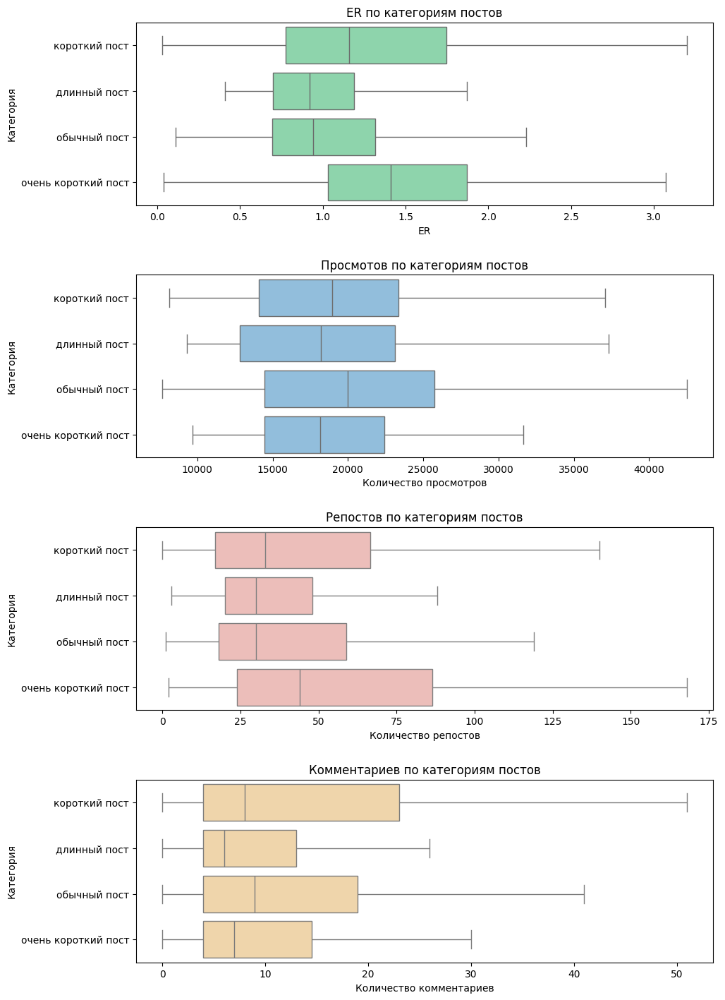

In [ ]:
fig, axes = plt.subplots(nrows=4, figsize = (10, 15))
fig.tight_layout(pad=5.0)

# ER
ax1 = sns.boxplot(x='er', y='post_cat', data=kinoreel_filtered, color='#82E0AA', ax=axes[0], showfliers=False)
ax1.set(title = 'ER по категориям постов', ylabel = 'Категория', xlabel = 'ER')

# Просмотры
ax2 = sns.boxplot(x='views', y='post_cat', data=kinoreel_filtered, color='#85C1E9', ax=axes[1], showfliers=False)
ax2.set(title = 'Просмотов по категориям постов', ylabel = 'Категория', xlabel = 'Количество просмотров')

# Репосты
ax3 = sns.boxplot(x='forwarded', y='post_cat', data=kinoreel_filtered, color='#F5B7B1', ax=axes[2], showfliers=False)
ax3.set(title = 'Репостов по категориям постов', ylabel = 'Категория', xlabel = 'Количество репостов')

# Комментарии
ax4 = sns.boxplot(x='comments', y='post_cat', data=kinoreel_filtered, color='#FAD7A0', ax=axes[3], showfliers=False)
ax4.set(title = 'Комментариев по категориям постов', ylabel = 'Категория', xlabel = 'Количество комментариев')

plt.show()

In [ ]:
min_er_text_kinoreel = ' '.join(kinoreel_filtered.query('er <= @kinoreel_filtered.er.median()')['clean_text'])
max_er_text_kinoreel = ' '.join(kinoreel_filtered.query('er > @kinoreel_filtered.er.median()')['clean_text'])

In [ ]:
kinoreel_er_min_noun_tokens, kinoreel_er_min_adjf_tokens, kinoreel_er_min_verb_tokens = get_word_tokens(min_er_text_kinoreel)


In [ ]:
kinoreel_er_max_noun_tokens, kinoreel_er_max_adjf_tokens, kinoreel_er_max_verb_tokens = get_word_tokens(max_er_text_kinoreel)


#### Существительные

**ER меньше или равен медианному значению**

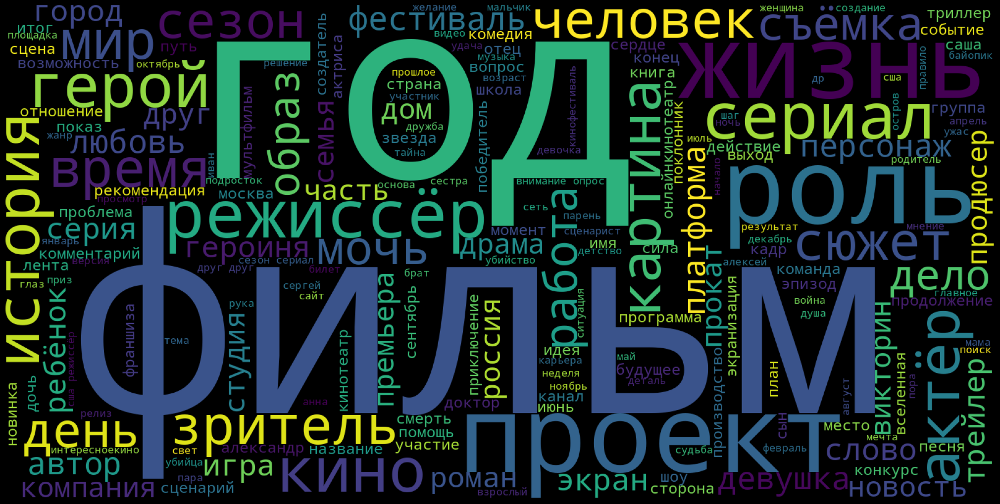

In [ ]:
words_cloud(kinoreel_er_min_noun_tokens)


**ER больше медианного значения**

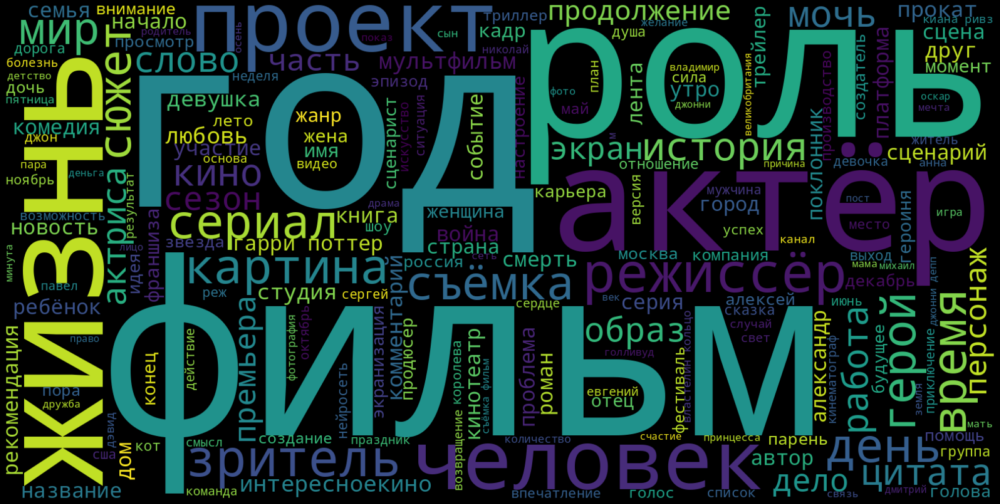

In [ ]:
words_cloud(kinoreel_er_max_noun_tokens)


#### Прилагательные

**ER меньше или равен медианному значению**

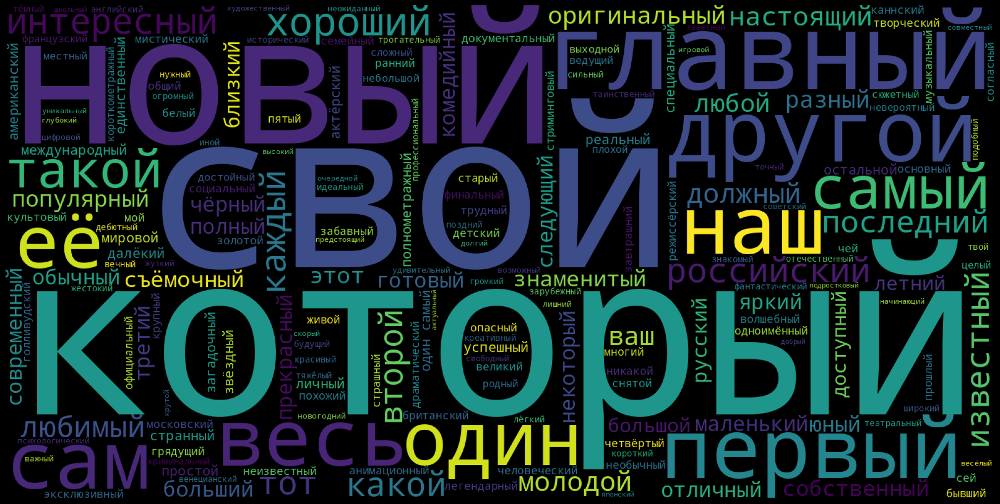

In [ ]:
words_cloud(kinoreel_er_min_adjf_tokens)

**ER больше медианного значения**

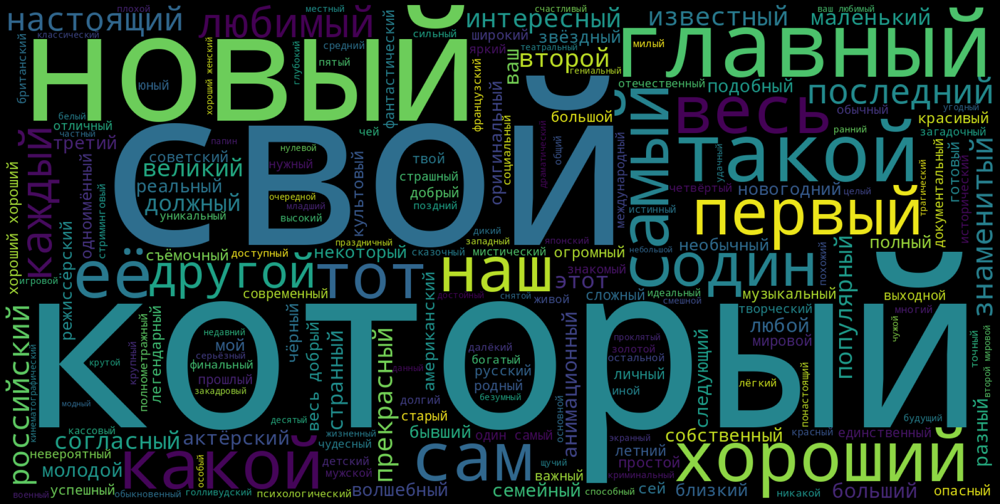

In [ ]:
words_cloud(kinoreel_er_max_adjf_tokens)

#### Глаголы

**ER меньше или равен медианному значению**

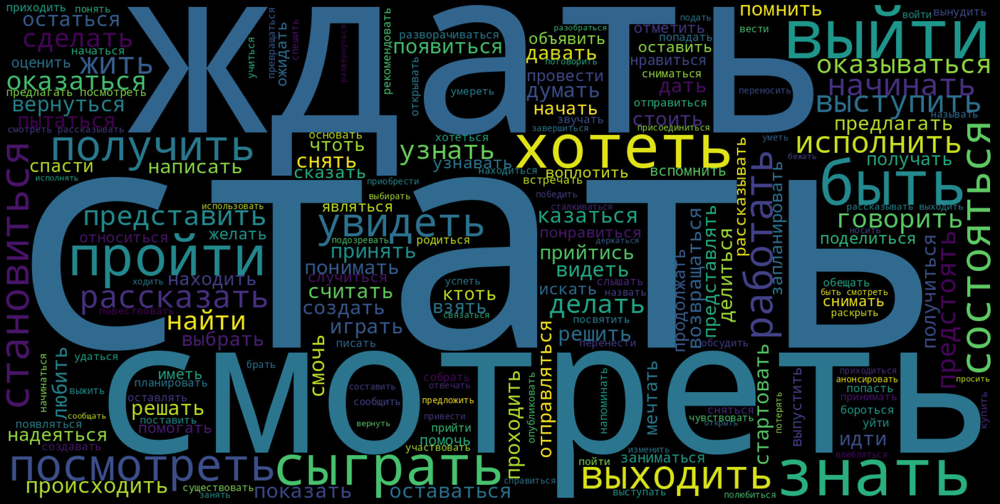

In [ ]:
words_cloud(kinoreel_er_min_verb_tokens)

**ER больше медианного значения**

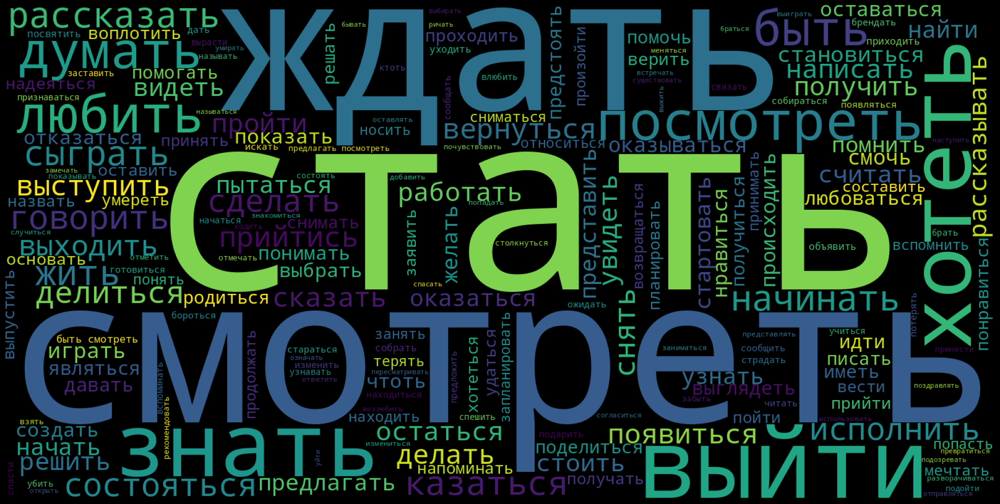

In [ ]:
words_cloud(kinoreel_er_max_verb_tokens)

In [ ]:
kinoreel_filtered['type_attachment'] = kinoreel_filtered['type_attachment'].fillna('without_attachment')

In [ ]:
kinoreel_attach = kinoreel_filtered.groupby(by='type_attachment').agg({'id':'count', 'er':'median'})

In [ ]:
kinoreel_attach

,id,er
type_attachment,,
MessageMediaDocument,291,1.36
MessageMediaPhoto,1450,1.09
MessageMediaWebPage,253,0.84
without_attachment,17,0.64


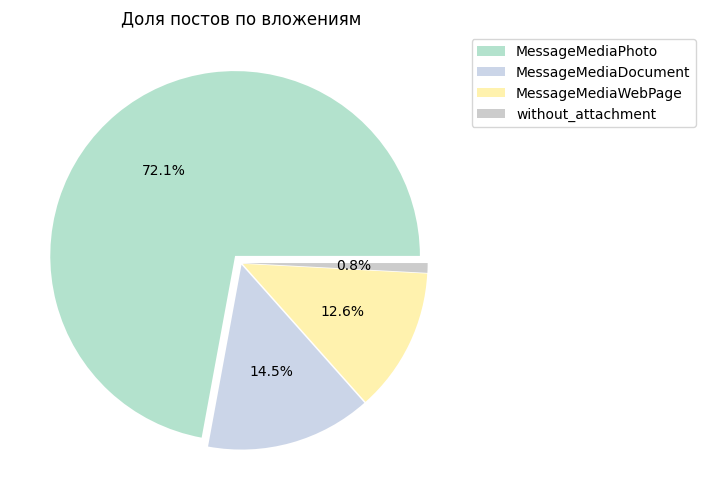

In [ ]:

kinoreel_attach['id'].sort_values(ascending=False).plot(kind="pie",
          autopct='%1.1f%%',
          explode=[0.05, 0.01, 0.01, 0.01],
          legend=True,
          title='Доля постов по вложениям',
          ylabel='',
          labeldistance=None,
          figsize=(6, 6),
          cmap='Pastel2').legend(bbox_to_anchor=(1.5, 1));

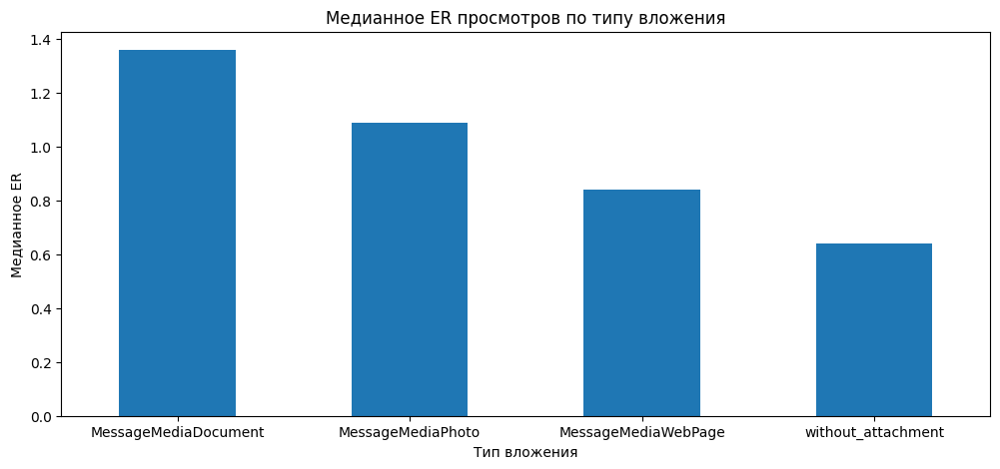

In [ ]:
kinoreel_attach['er'].sort_values(ascending=False).plot(kind='bar',
       figsize=(12,5),
       title='Медианное ER просмотров по типу вложения',
       xlabel='Тип вложения',
       ylabel='Медианное ER',
       rot=0
      );